# irp-dbk24 - "Optimising Demand Response Strategies for Carbon-Intelligent Electricity Use"

# Processing Grid Readings Data

**NOTEBOOK PURPOSE(S):**
* Process the grid readings dataset pulled from the hitachi database (originally from carbontracker.in)

**LIMITATIONS:**
* This notebook is designed to work with the grid readings data downloaded from the hitachi database
* It assumes the data is in the correct format and contains the necessary columns for processing

**NOTEBOOK INPUT** 
* grid_readings_20250714_1401.parquet


**NOTEBOOK OUTPUTS:**
* Primary output:
    * grid_readings_20250714_1401_processed.parquet


### Importing Libraries

In [1]:
%matplotlib inline

# ────────────────────────────────────────────────────────────────────────────
# Data Manipulation & Analysis
# ─────────────────────────────────────────────────────────────────────────────
import pandas as pd
import polars as pl
from functools import reduce
from typing import List, Tuple
import numpy as np
import math


# ─────────────────────────────────────────────────────────────────────────────
# Geospatial Data Handling
# ─────────────────────────────────────────────────────────────────────────────
import geopandas as gpd
from shapely.geometry import Point, Polygon
from shapely.wkb import loads
from pyproj import Proj, transform

# ─────────────────────────────────────────────────────────────────────────────
# Visualization
# ─────────────────────────────────────────────────────────────────────────────
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.dates as mdates
import seaborn as sns

# ─────────────────────────────────────────────────────────────────────────────
# Notebook/Display Tools
# ─────────────────────────────────────────────────────────────────────────────
from IPython.display import display

# ─────────────────────────────────────────────────────────────────────────────
# System / Miscellaneous
# ─────────────────────────────────────────────────────────────────────────────#
import os
import calendar
import binascii
import re
import datetime as dt
from datetime import date, datetime, timedelta
from zoneinfo import ZoneInfo
from typing import Optional, Union, Literal, Iterable, List, Dict, Tuple, Any, Sequence

## Loading Data from Local Storage

In [2]:
cwd = os.getcwd()
print("-"*120)
print("Current Working Directory and contents:\n"+"-"*120)
for root, dirs, files in os.walk(cwd):
    print(f"\nDirectory: {root}")
    print(f"Subdirectories: {dirs}\n"+ "-"*40)
    for file in sorted(files):
        print(f"-> File: {file}")


------------------------------------------------------------------------------------------------------------------------
Current Working Directory and contents:
------------------------------------------------------------------------------------------------------------------------

Directory: /Users/Daniel/Desktop/IRP_WORK_UPDATED/irp-dbk24/code_and_analysis
Subdirectories: ['images', 'scripts', 'data', 'grid_downloads', 'hpc_scripts']
----------------------------------------
-> File: .DS_Store
-> File: marginal_emissions_data_prep.ipynb
-> File: marginal_emissions_model_development.ipynb
-> File: step1_hitachi_data_retrieval.ipynb
-> File: step2_initial_data_analysis.ipynb
-> File: step2_investigating_data_size_and_types.ipynb
-> File: step2_investigating_era5_world_data.ipynb
-> File: step3_combining_era5_datasets.ipynb
-> File: step3_combining_grid_and_weather_data.ipynb
-> File: step3_processing_era5_land_data.ipynb
-> File: step3_processing_era5_world_data.ipynb
-> File: step3_pro

### Defining File Paths

In [3]:
# Reminder of data directory structure and contents

base_data_directory = "data"  # Base directory where the dataframes will be saved

hitachi_data_directory = os.path.join(base_data_directory, "hitachi_copy")  # Directory where the dataframes will be saved

In [4]:
print("-"*120)
print("[hitachi_data_directory] and contents:\n"+"-"*120)
for root, dirs, files in os.walk(hitachi_data_directory):
    print(f"\nDirectory: {root}")
    print(f"Subdirectories: {dirs}\n"+ "-"*40)
    for file in sorted(files):
        print(f"-> File: {file}")


------------------------------------------------------------------------------------------------------------------------
[hitachi_data_directory] and contents:
------------------------------------------------------------------------------------------------------------------------

Directory: data/hitachi_copy
Subdirectories: ['meter_primary_files']
----------------------------------------
-> File: .DS_Store
-> File: customers_20250606_1901.parquet
-> File: customers_20250630_1215.parquet
-> File: customers_20250701_1318.parquet
-> File: customers_20250714_1401.parquet
-> File: customers_weather_mapping_20250630_1215.parquet
-> File: grid_readings_20250606_1901.parquet
-> File: grid_readings_20250630_1215.parquet
-> File: grid_readings_20250701_1318.parquet
-> File: grid_readings_20250714_1401.parquet
-> File: grid_readings_20250714_1401_half_hourly.parquet
-> File: meter_readings_20250606_1901.parquet
-> File: meter_readings_20250630_1215.parquet
-> File: meter_readings_20250701_1318.p

In [5]:
# ------------------------- Filename & Filepath -------------------------

grid_readings_filename = "grid_readings_20250714_1401"
grid_readings_filepath = os.path.join(hitachi_data_directory, grid_readings_filename + ".parquet")

# we'll also set up a list to store temporary filepaths for different processing steps
temp_processing_filepaths = []

In [6]:
grid_readings_pldf = pl.read_parquet(grid_readings_filepath)

## Data Processing

In [7]:
print("\n" + "-" * 120)
print("First few rows of grid_readings data:\n" + "-" * 120)
display(grid_readings_pldf.head(5))
print("\n" + "-" * 120)
print("Descriptive statistics of grid_readings data:\n" + "-" * 120)
display(grid_readings_pldf.describe())


------------------------------------------------------------------------------------------------------------------------
First few rows of grid_readings data:
------------------------------------------------------------------------------------------------------------------------


timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
datetime[μs],f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
2022-01-04 17:05:00,136202.0,2901.0,815.573088,10113.0,5211.0,9900.0,11168.3899,164327.0,0.815573,162948.0,154427.0
2022-01-04 17:10:00,136202.0,2901.0,815.573088,10113.0,5211.0,9900.0,11168.3899,164327.0,0.815573,162948.0,154427.0
2022-01-04 17:15:00,136202.0,2901.0,815.573088,10113.0,5211.0,9900.0,11168.3899,164327.0,0.815573,162948.0,154427.0
2022-01-04 17:20:00,136202.0,2901.0,815.573088,10113.0,5211.0,9900.0,11168.3899,164327.0,0.815573,162948.0,154427.0
2022-01-04 17:25:00,136202.0,2901.0,815.573088,10113.0,5211.0,9900.0,11168.3899,164327.0,0.815573,162948.0,154427.0



------------------------------------------------------------------------------------------------------------------------
Descriptive statistics of grid_readings data:
------------------------------------------------------------------------------------------------------------------------


statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""561067""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-12 15:50:43.006628""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-02 17:15:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 05:50:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-21 10:35:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [8]:
grid_readings_pldf.schema

Schema([('timestamp', Datetime(time_unit='us', time_zone=None)),
        ('thermal_generation', Float64),
        ('gas_generation', Float64),
        ('g_co2_per_kwh', Float64),
        ('hydro_generation', Float64),
        ('nuclear_generation', Float64),
        ('renewable_generation', Float64),
        ('tons_co2', Float64),
        ('total_generation', Float64),
        ('tons_co2_per_mwh', Float64),
        ('demand_met', Float64),
        ('net_demand', Float64)])

### Helper Functions

#### General

In [9]:
def datasets_from_frames(
        frames,
        *,
        plot_col: str = "demand_met",
        titles: list[str] | None = None,
) -> list[dict]:
    """
    Make the 'datasets' list expected by plot_time_series_compare_multi
    from a plain list of Polars DataFrames.
    Parameters:
    -----------
    frames : list[pl.DataFrame]
        List of Polars DataFrames to plot.
    plot_col : str
        Name of the column to plot in the DataFrames.
    titles : list[str] | None
        Optional list of pretty column titles.

    Returns:
    --------
    list[dict]
        A list of dictionaries, each containing the DataFrame, plot column,
        title, and color specifications for plotting.
    """
    n = len(frames)
    if titles is None:
        titles = [f"DF {i+1}" for i in range(n)]

    # color cycle C0..C9; repeat if needed
    specs = []
    for i, (df_i, title_i) in enumerate(zip(frames, titles)):
        specs.append({
            "df": df_i,
            "plot_col": plot_col,
            "title": title_i,
            "line_color":  f"C{i % 10}",
            "point_color": f"C{i % 10}",
            "line_label":  "Line",
            "point_label": "Measurements",
        })
    return specs


In [10]:
def recompute_intensities_from_rates(
        df: pl.DataFrame,
        *,
        step_minutes: int = 5,
        total_col: str = "total_generation",
        tons_col: str = "tons_co2",
        t_mwh_col: str = "tons_co2_per_mwh",
        g_kwh_col: str = "g_co2_per_kwh",
        eps: float = 1e-9,
        # clamp options (set clamp_to_existing=False to disable)
        clamp_to_existing: bool = True,
        q_low: float = 0.01,
        q_high: float = 0.99,
        pad: float = 0.05,      # expand the q_low..q_high band by ±pad * (q_high - q_low)
) -> pl.DataFrame:
    """
    Recompute intensity columns from emissions (tons) and power (MW) over fixed-length intervals.

    interval_energy_mwh = MW * (step_minutes/60)
    tons_co2_per_mwh   = tons / interval_energy_mwh
    g_co2_per_kwh      = tons_co2_per_mwh * 1000

    If interval_energy_mwh <= eps, fall back to existing values.

    Parameters:
    -----------
    df : pl.DataFrame
        Input DataFrame containing the columns to be processed.
    step_minutes : int
        The duration of each time step in minutes.
    total_col : str
        The name of the column containing total generation (MW).
    tons_col : str
        The name of the column containing CO2 emissions (tons).
    t_mwh_col : str
        The name of the column to store tons CO2 per MWh.
    g_kwh_col : str
        The name of the column to store grams CO2 per kWh.
    eps : float
        A small epsilon value to avoid division by zero.
    clamp_to_existing : bool
        Whether to clamp the recomputed values to the existing distribution.
    q_low : float
        The lower quantile for clamping.
    q_high : float
        The upper quantile for clamping.
    pad : float
        Padding to apply to the quantile bounds.

    Returns:
    --------
    pl.DataFrame
        A DataFrame with recomputed intensity columns.
    """

    factor = float(step_minutes) / 60.0

    # fresh recomputation (guard against tiny/zero energy)
    new_t_expr = (
        pl.when((pl.col(total_col) * factor) > eps)
          .then(pl.col(tons_col) / (pl.col(total_col) * factor))
          .otherwise(None)
    )

    out = df.with_columns(
        # prefer recomputed value when available, otherwise keep existing
        pl.coalesce([new_t_expr, pl.col(t_mwh_col)]).alias(t_mwh_col)
    )

    # optional robust clamp using existing distribution
    if clamp_to_existing:
        qdf = df.select([
            pl.col(t_mwh_col).quantile(q_low, "nearest").alias("_q_lo"),
            pl.col(t_mwh_col).quantile(q_high, "nearest").alias("_q_hi"),
        ])
        q_lo, q_hi = qdf.row(0)

        # fallback if existing column had no non-nulls
        if q_lo is None or q_hi is None:
            qdf2 = out.select([
                pl.col(t_mwh_col).quantile(q_low, "nearest").alias("_q_lo"),
                pl.col(t_mwh_col).quantile(q_high, "nearest").alias("_q_hi"),
            ])
            q_lo, q_hi = qdf2.row(0)

        # derive padded bounds; enforce non-negative lower bound
        if q_lo is None or q_hi is None or not (math.isfinite(q_lo) and math.isfinite(q_hi)):
            lb, ub = 0.0, math.inf
        else:
            span = max(0.0, q_hi - q_lo)
            lb = max(0.0, q_lo - pad * span)
            ub = q_hi + pad * span

        if math.isfinite(ub):
            out = out.with_columns(pl.col(t_mwh_col).clip(lb, ub))
        else:
            out = out.with_columns(pl.col(t_mwh_col).clip_min(lb))

    # keep the two intensity columns consistent
    out = out.with_columns((pl.col(t_mwh_col) * 1000.0).alias(g_kwh_col))
    return out

#### Visualisations

In [11]:
def batch_plot_from_lists(
        dataframes_to_plot,
        start_boundaries,
        end_boundaries,
        ylimits,
        *,
        timestamp_col: str = "timestamp",
        plot_col: str = "demand_met",
        offset_hours: int = 24,
        titles: list[str] | None = None,        # optional pretty column titles
        base_title_prefix: str = "Electricity Demand — ",
        width_per_col: int = 6,
        height: int = 14,
        sharey: bool = True,
        align_ylim: bool = True,                # will be ignored when a specific ylim is provided
        point_size: int = 8,
        save: bool = False,
        save_dir: str | None = None,
        filename_template: str = "{idx:02d}_{start:%Y%m%d_%H%M}-{end:%Y%m%d_%H%M}.png",
):
    """
    For each (start,end,ylim) triple, plot a 3×N grid:
      rows = previous/original/next
      cols = each dataframe in dataframes_to_plot

    Parameters:
    -----------
    dataframes_to_plot : list[pl.DataFrame]
        List of Polars DataFrames to plot.
    start_boundaries : list[datetime]
        List of start boundaries for each window.
    end_boundaries : list[datetime]
        List of end boundaries for each window.
    ylimits : list[tuple[float, float] | None]
        List of y-axis limits for each window.
    timestamp_col : str
        Name of the timestamp column in the DataFrames.
    plot_col : str
        Name of the column to plot in the DataFrames.
    offset_hours : int
        Number of hours to offset the start and end times for the previous and next windows.
    titles : list[str] | None
        Optional list of pretty column titles.
    base_title_prefix : str
        Base title prefix for the plot filenames.
    width_per_col : int
        Width of each column in the plot.
    height : int
        Height of the plot.
    sharey : bool
        If True, share the y-axis limits across all columns.
    align_ylim : bool
        If True, align the y-axis limits across all rows.
    point_size : int
        Size of the points in the scatter plot.
    save : bool
        If True, save the plots to files.
    save_dir : str | None
        Directory to save the plots.
    filename_template : str
        Template for the plot filenames.

    Returns:
    -------
    None
        Displays the plot.
    """
    if not (len(start_boundaries) == len(end_boundaries) == len(ylimits)):
        raise ValueError("start_boundaries, end_boundaries, and ylimits must be the same length.")

    datasets = datasets_from_frames(dataframes_to_plot, plot_col=plot_col, titles=titles)

    for idx, (s, e, yl) in enumerate(zip(start_boundaries, end_boundaries, ylimits)):
        title = f"{base_title_prefix}Window {idx+1}"

        fig = plot_time_series_compare_multi(
            datasets=datasets,
            timestamp_col=timestamp_col,
            start_boundary=s,
            end_boundary=e,
            offset_hours=offset_hours,
            base_title=title,
            width_per_col=width_per_col,
            height=height,
            sharey=sharey,
            align_ylim=(align_ylim and yl is None),   # respect explicit per-window ylimit
            ylim=yl,                                   # (low, high) or None
            point_size=point_size,
            show=not save,                             # show if not saving
        )

        if save:
            if save_dir is None:
                raise ValueError("When save=True, provide save_dir.")
            fname = filename_template.format(idx=idx, start=s, end=e)
            import os
            os.makedirs(save_dir, exist_ok=True)
            fig.savefig(os.path.join(save_dir, fname), dpi=150, bbox_inches="tight")
            plt.close(fig)


In [12]:
def plot_time_series_compare_multi(
        datasets: Sequence[Dict[str, Any]],
        *,
        timestamp_col: str,
        start_boundary: datetime,
        end_boundary: datetime,
        offset_hours: int,
        # Titles / labels
        base_title: str = "Time Series",
        row_labels: Tuple[str, str, str] = ("Previous", "Original", "Next"),
        # Layout
        figsize: Optional[Tuple[int, int]] = None,   # if None, width auto = width_per_col * n_cols
        width_per_col: int = 8,
        height: int = 12,
        # Scaling
        sharey: bool = True,
        align_ylim: bool = True,
        ylim: Optional[Tuple[float, float]] = None,  # if set, overrides align_ylim
        # Styling
        major_tick_minutes: Sequence[int] = (0, 15, 30, 45),
        minor_tick_interval: int = 5,
        point_size: int = 10,
        rotate_xticks: int = 45,
        x_label: str = "Time (HH:MM)",
        y_label: str = "Value",
        strict: bool = False,       # if True, raise when any panel has no data
        show: bool = True,          # set False when batching/saving
):
    """
    Plot a 3×N grid:
      - Rows: (start,end) shifted by -offset_hours, 0, +offset_hours
      - Cols: one per dataset in `datasets`

    Each dataset is a dict with required keys:
      - 'df'        : Polars DataFrame
      - 'plot_col'  : column to plot
      - 'title'     : column title

    Optional keys per dataset:
      - 'line_color', 'point_color', 'line_label', 'point_label'

    Parameters:
    -----------
    datasets : Sequence[Dict[str, Any]]
        List of dataset specifications, each a dict with keys:
          - 'df'        : Polars DataFrame
          - 'plot_col'  : column to plot
          - 'title'     : column title
        Optional keys:
          - 'line_color', 'point_color', 'line_label', 'point_label
    timestamp_col : str
        Name of the timestamp column in the DataFrames.
    start_boundary : datetime
        Start time for the original window.
    end_boundary : datetime
        End time for the original window.
    offset_hours : int
        Number of hours to offset the start and end times for the previous and next windows.
    base_title : str
        Base title for the plot.
    row_labels : Tuple[str, str, str]
        Labels for the rows in the plot.
    figsize : Optional[Tuple[int, int]]
        Figure size (width, height) in inches.
    width_per_col : int
        Width of each column in the plot.
    height : int
        Height of the plot.
    sharey : bool
        If True, share the y-axis limits across all columns.
    align_ylim : bool
        If True, align the y-axis limits across all rows.
    ylim : Optional[Tuple[float, float]]
        If set, overrides align_ylim and uses these limits.
    major_tick_minutes : Sequence[int]
        Major tick marks on the x-axis (in minutes).
    minor_tick_interval : int
        Minor tick interval (in minutes).
    point_size : int
        Size of the points in the scatter plot.
    rotate_xticks : int
        Angle to rotate x-axis tick labels (in degrees).
    x_label : str
        Label for the x-axis.
    y_label : str
        Label for the y-axis.
    strict : bool
        If True, raise an error if any panel has no data.
    show : bool
        If True, display the plot.

    Returns:
    -------
    matplotlib.figure.Figure
        The figure object containing the plot.
    """
    if not datasets:
        raise ValueError("`datasets` must contain at least one dataset dict.")

    # Validate columns exist
    for i, spec in enumerate(datasets):
        if "df" not in spec or "plot_col" not in spec or "title" not in spec:
            raise ValueError(f"datasets[{i}] must have keys: 'df', 'plot_col', 'title'")
        df_i = spec["df"]
        if timestamp_col not in df_i.columns:
            raise ValueError(f"[datasets[{i}].df] missing '{timestamp_col}'")
        if spec["plot_col"] not in df_i.columns:
            raise ValueError(f"[datasets[{i}].df] missing '{spec['plot_col']}'")

    # Triplet of windows (previous, original, next)
    windows = [
        (row_labels[0], start_boundary - timedelta(hours=offset_hours), end_boundary - timedelta(hours=offset_hours)),
        (row_labels[1], start_boundary, end_boundary),
        (row_labels[2], start_boundary + timedelta(hours=offset_hours), end_boundary + timedelta(hours=offset_hours)),
    ]

    def _filter(df: pl.DataFrame, s: datetime, e: datetime) -> pl.DataFrame:
        return df.filter((pl.col(timestamp_col) >= s) & (pl.col(timestamp_col) <= e))

    # Compute global y-limit (if requested)
    global_max: Optional[float] = None
    if align_ylim and ylim is None:
        vals: List[float] = []
        for _, s, e in windows:
            for spec in datasets:
                sub = _filter(spec["df"], s, e)
                if not sub.is_empty():
                    vmax = sub[spec["plot_col"]].max()
                    if vmax is not None:
                        vals.append(float(vmax))
        if vals:
            global_max = max(vals) * 1.05  # headroom

    # Figure/axes
    n_cols = len(datasets)
    if figsize is None:
        figsize = (width_per_col * n_cols, height)

    fig, axes = plt.subplots(3, n_cols, figsize=figsize, sharex=False, sharey=sharey)
    if n_cols == 1:
        # normalize to 2D [3,1]
        axes = axes.reshape(3, 1)
    fig.suptitle(base_title, y=0.995)

    # Draw
    for r, (row_name, s, e) in enumerate(windows):
        for c, spec in enumerate(datasets):
            ax = axes[r, c]
            sub = _filter(spec["df"], s, e)
            title = f"{spec['title']} — {row_name} ({s:%b %d %Y})"

            if sub.is_empty():
                if strict:
                    raise ValueError(f"No data in dataset '{spec['title']}' for window {row_name}: {s} → {e}")
                ax.set_title(title + " (no data)")
                ax.axis("off")
                continue

            line_color  = spec.get("line_color",  f"C{c}")
            point_color = spec.get("point_color", f"C{c}")
            line_label  = spec.get("line_label",  "Line")
            point_label = spec.get("point_label", "Measurements")

            # line + points
            ax.plot(sub[timestamp_col], sub[spec["plot_col"]], label=line_label, color=line_color)
            ax.scatter(sub[timestamp_col], sub[spec["plot_col"]], s=point_size, label=point_label, color=point_color)

            # x domain/ticks
            ax.set_xlim([s, e])
            ax.xaxis.set_major_locator(mdates.MinuteLocator(byminute=list(major_tick_minutes)))
            ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
            ax.xaxis.set_minor_locator(mdates.MinuteLocator(interval=minor_tick_interval))

            # grid
            ax.grid(True, which='major', linestyle='-', linewidth=0.8, alpha=0.7)
            ax.grid(True, which='minor', linestyle=':', linewidth=0.5, alpha=0.4)

            # y domain
            if ylim is not None:
                ax.set_ylim(ylim)
            elif global_max is not None:
                ax.set_ylim(0, global_max)
            else:
                local_max = sub[spec["plot_col"]].max()
                m = float(local_max) if local_max is not None else 1.0
                ax.set_ylim(0, m * 1.05)

            # titles & legends
            ax.set_title(title)
            if r == 1:  # middle row: show legend once per column
                ax.legend()

            for tick in ax.get_xticklabels():
                tick.set_rotation(rotate_xticks)

            # y-label for first column only
            if c == 0:
                ax.set_ylabel(y_label)

    # x-labels on the bottom row
    for c in range(n_cols):
        axes[-1, c].set_xlabel(x_label)

    plt.tight_layout(rect=[0, 0, 1, 0.98])
    if show:
        plt.show()
    return fig  # so callers can save/close if they want

In [13]:
def plot_time_series_compare_two_datasets_with_hour_offsets_grid(
        df_left: pl.DataFrame,
        df_right: pl.DataFrame,
        *,
        timestamp_col: str,
        plot_col_left: str,
        plot_col_right: str,
        start_boundary: datetime,
        end_boundary: datetime,
        offset_hours: int,
        # Labels / titles
        col_titles: Tuple[str, str] = ("Dataset A", "Dataset B"),
        base_title: str = "Time Series",
        row_labels: Tuple[str, str, str] = ("Previous", "Original", "Next"),
        # Formatting
        figsize: Tuple[int, int] = (16, 12),
        sharey: bool = True,           # share y across *all six* subplots
        align_ylim: bool = True,       # force same y-lims across all 6 by using global max
        major_tick_minutes: list = [0, 15, 30, 45],
        minor_tick_interval: int = 5,
        line_label: str = "Line",
        point_label: str = "Measurements",
        line_color_left: str = "C0",
        point_color_left: str = "C0",
        line_color_right: str = "C1",
        point_color_right: str = "C1",
        point_size: int = 10,
        rotate_xticks: int = 45,
        ylim: Optional[Tuple[float, float]] = None,  # override all y-lims if provided
        x_label: str = "Time (HH:MM)",
        y_label: str = "Value",
        strict: bool = False,          # if False, blank panels when no data in window
) -> None:
    """
    Compare two datasets side-by-side across three time windows in a **2×3 grid**.

    Rows are windows shifted by `-offset_hours`, `0`, and `+offset_hours`.
    Columns are the two datasets (left/right). This is ideal for visually
    comparing *original vs. filled* data while also seeing the day-before/day-after.

    Parameters
    ----------
    df_left, df_right : pl.DataFrame
        Input Polars DataFrames for the left and right columns.
    timestamp_col : str
        Shared timestamp column name present in both dataframes.
    plot_col_left : str
        Value column to plot from `df_left`.
    plot_col_right : str
        Value column to plot from `df_right`.
    start_boundary, end_boundary : datetime
        Start/end of the *original* window.
    offset_hours : int
        Hours to shift for the previous/next rows.
    col_titles : (str, str), default ("Dataset A", "Dataset B")
        Column headers shown in subplot titles.
    base_title : str, default "Time Series"
        Figure super-title.
    row_labels : (str, str, str), default ("Previous", "Original", "Next")
        Labels for the three window rows
    figsize : (int, int), default (16, 12)
        Matplotlib figure size (width, height).
    sharey : bool, default True
        Share y-scale across all six subplots.
    align_ylim : bool, default True
        If `True` and `ylim` is `None`, compute a global max across all windows
        and both datasets, then apply `(0, 1.05*global_max)` to all axes.
    major_tick_minutes : list, default [0, 15, 30, 45]
        Minutes within each hour for major ticks.
    minor_tick_interval : int, default 5
        Minutes between minor ticks.
    line_label, point_label : str
        Legend labels for line and scatter.
    line_color_left, point_color_left : str
        Colors for the left column traces.
    line_color_right, point_color_right : str
        Colors for the right column traces.
    point_size : int, default 10
        Scatter point size.
    rotate_xticks : int, default 45
        Rotation (degrees) for x tick labels.
    ylim : (float, float) | None, optional
        Explicit y-limits for all six plots. Overrides `align_ylim`.
    x_label : str, default "Time (HH:MM)"
        Bottom x-axis label (applies to both bottom panels).
    y_label : str, default "Value"
        Y-axis label for the left column.
    strict : bool, default False
        If `True`, raise when a panel has no data; otherwise show a “(no data)” panel.

    Returns
    -------
    None
        Displays a Matplotlib figure.
    """
    # Validate columns
    for name, df, col in [
        ("timestamp_col", df_left, timestamp_col),
        ("plot_col_left", df_left, plot_col_left),
        ("timestamp_col", df_right, timestamp_col),
        ("plot_col_right", df_right, plot_col_right),
    ]:
        if col not in df.columns:
            raise ValueError(f"Column '{col}' (for {name}) not found in its DataFrame")

    def _filter(df: pl.DataFrame, s: datetime, e: datetime) -> pl.DataFrame:
        return df.filter((pl.col(timestamp_col) >= s) & (pl.col(timestamp_col) <= e))

    # Build windows
    windows = [
        (row_labels[0], start_boundary - timedelta(hours=offset_hours), end_boundary - timedelta(hours=offset_hours)),
        (row_labels[1], start_boundary, end_boundary),
        (row_labels[2], start_boundary + timedelta(hours=offset_hours), end_boundary + timedelta(hours=offset_hours)),
    ]

    # Precompute global y-limit if requested
    global_max: Optional[float] = None
    if align_ylim and ylim is None:
        vals: list[float] = []
        for _, s, e in windows:
            fl = _filter(df_left, s, e)
            fr = _filter(df_right, s, e)
            if not fl.is_empty():
                vals.append(float(fl[plot_col_left].max()))
            if not fr.is_empty():
                vals.append(float(fr[plot_col_right].max()))
        if vals:
            global_max = max(vals) * 1.05  # headroom

    # Create grid: 3 rows × 2 cols
    fig, axes = plt.subplots(3, 2, figsize=figsize, sharex=False, sharey=sharey)
    fig.suptitle(base_title, y=0.995)

    for r, (row_name, s, e) in enumerate(windows):
        # LEFT COLUMN (df_left)
        axL = axes[r, 0]
        left_title = f"{col_titles[0]} — {row_name} ({s:%b %d %Y})"
        fl = _filter(df_left, s, e)

        if fl.is_empty():
            if strict:
                raise ValueError(f"No data in left dataset for window {row_name}: {s} → {e}")
            axL.set_title(left_title + " (no data)")
            axL.axis("off")
        else:
            axL.plot(fl[timestamp_col], fl[plot_col_left], label=line_label, color=line_color_left)
            axL.scatter(fl[timestamp_col], fl[plot_col_left], s=point_size, color=point_color_left, label=point_label)
            axL.set_xlim([s, e])

            # ticks & grid
            axL.xaxis.set_major_locator(mdates.MinuteLocator(byminute=major_tick_minutes))
            axL.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
            axL.xaxis.set_minor_locator(mdates.MinuteLocator(interval=minor_tick_interval))
            axL.grid(True, which='major', linestyle='-', linewidth=0.8, alpha=0.7)
            axL.grid(True, which='minor', linestyle=':', linewidth=0.5, alpha=0.4)

            # y-lims
            if ylim is not None:
                axL.set_ylim(ylim)
            elif global_max is not None:
                axL.set_ylim(0, global_max)
            else:
                axL.set_ylim(0, float(fl[plot_col_left].max()) * 1.05)

            axL.set_title(left_title)
            if r == 1:  # show once per column
                axL.legend()

            for _tick in axL.get_xticklabels():
                _tick.set_rotation(rotate_xticks)

        # RIGHT COLUMN (df_right)
        axR = axes[r, 1]
        right_title = f"{col_titles[1]} — {row_name} ({s:%b %d %Y})"
        fr = _filter(df_right, s, e)

        if fr.is_empty():
            if strict:
                raise ValueError(f"No data in right dataset for window {row_name}: {s} → {e}")
            axR.set_title(right_title + " (no data)")
            axR.axis("off")
        else:
            axR.plot(fr[timestamp_col], fr[plot_col_right], label=line_label, color=line_color_right)
            axR.scatter(fr[timestamp_col], fr[plot_col_right], s=point_size, color=point_color_right, label=point_label)
            axR.set_xlim([s, e])

            axR.xaxis.set_major_locator(mdates.MinuteLocator(byminute=major_tick_minutes))
            axR.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
            axR.xaxis.set_minor_locator(mdates.MinuteLocator(interval=minor_tick_interval))
            axR.grid(True, which='major', linestyle='-', linewidth=0.8, alpha=0.7)
            axR.grid(True, which='minor', linestyle=':', linewidth=0.5, alpha=0.4)

            if ylim is not None:
                axR.set_ylim(ylim)
            elif global_max is not None:
                axR.set_ylim(0, global_max)
            else:
                axR.set_ylim(0, float(fr[plot_col_right].max()) * 1.05)

            axR.set_title(right_title)
            if r == 1:
                axR.legend()

            for _tick in axR.get_xticklabels():
                _tick.set_rotation(rotate_xticks)

        # y-label on left column only
        axL.set_ylabel(y_label)

    # x-labels on the bottom row
    axes[-1, 0].set_xlabel(x_label)
    axes[-1, 1].set_xlabel(x_label)

    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()

In [14]:
def plot_time_series_with_hour_offsets_subplot(
        df: pl.DataFrame,
        timestamp_col: str,
        plot_col: str,
        start_boundary: datetime,
        end_boundary: datetime,
        offset_hours: int,
        *,
        strict: bool = False,
        figsize: tuple = (14, 12),
        sharey: bool = True,
        major_tick_minutes: list = [0, 15, 30, 45],
        minor_tick_interval: int = 5,
        line_label: str = "Data Line",
        point_label: str = "Data Points",
        line_color: str = "blue",
        point_color: str = "red",
        point_size: int = 10,
        rotate_xticks: int = 45,
        ylim: Optional[tuple] = None,
        x_label: str = "Time (HH:MM)",
        y_label: str = "Value",
) -> None:
    """
    Plot a single dataset in a 3-row figure: **previous**, **original**, and **next**
    time windows, where the previous/next windows are shifted by a fixed number of hours.

    The three panels share styling (ticks, grid, labels) and optionally share the y-axis.

    Parameters
    ----------
    df : pl.DataFrame
        Input Polars DataFrame containing at least the timestamp and value columns.
    timestamp_col : str
        Name of the timestamp column (must be comparable to `datetime`).
    plot_col : str
        Name of the value column to plot.
    start_boundary : datetime
        Start of the *original* window.
    end_boundary : datetime
        End of the *original* window.
    offset_hours : int
        Number of hours to shift for the previous/next windows. For example,
        `24` yields the day-before and day-after if your window is 24h long.
    titles : tuple[str|None, str|None, str|None] | None, optional
        Custom titles for the three rows `(previous, original, next)`. If `None`,
        titles are auto-generated from `base_title` and the window dates.
    strict : bool, default False
        If `True`, raise `ValueError` when a window has no data.
        If `False`, show a blank panel with "(no data)".
    figsize : tuple, default (14, 12)
        Matplotlib figure size (width, height).
    sharey : bool, default True
        Whether all three subplots share the same y-axis scale.
    major_tick_minutes : list, default [0, 15, 30, 45]
        Minutes within the hour to place major tick marks.
    minor_tick_interval : int, default 5
        Interval in minutes for minor ticks.
    line_label : str, default "Data Line"
        Legend label for the line.
    point_label : str, default "Data Points"
        Legend label for the scatter points.
    line_color : str, default "blue"
        Line color.
    point_color : str, default "red"
        Scatter point color.
    point_size : int, default 10
        Scatter point size.
    rotate_xticks : int, default 45
        Rotation angle for x-axis tick labels (degrees).
    ylim : tuple | None, optional
        Y-axis limits `(ymin, ymax)`. If `None`, computed from the series
        (5% headroom).
    x_label : str, default "Time (HH:MM)"
        Bottom x-axis label (shown on final row).
    y_label : str, default "Value"
        Y-axis label (shown on all rows, left side).
    base_title : str, default "Time Series"
        Base text used to auto-generate subplot titles.

    Returns
    -------
    None
        Displays a Matplotlib figure.
    """
    # Validate columns
    if timestamp_col not in df.columns:
        raise ValueError(f"Column '{timestamp_col}' not found in DataFrame")
    if plot_col not in df.columns:
        raise ValueError(f"Column '{plot_col}' not found in DataFrame")

    # Build the three windows
    shifts = [
        (start_boundary - timedelta(hours=offset_hours), end_boundary - timedelta(hours=offset_hours)),
        (start_boundary, end_boundary),
        (start_boundary + timedelta(hours=offset_hours), end_boundary + timedelta(hours=offset_hours)),
    ]

    fig, axes = plt.subplots(3, 1, figsize=figsize, sharey=sharey)

    all_dates = []

    for i, (s, e) in enumerate(shifts):
        ax = axes[i]

        # Filter data for the window
        filtered_data = df.filter((pl.col(timestamp_col) >= s) & (pl.col(timestamp_col) <= e))

        if filtered_data.is_empty():
            if strict:
                raise ValueError(f"No data for window {s} → {e}")
            ax.set_title(f"{y_label} {s:%b %d} (no data)")
            ax.axis("off")
            continue

        # Record for overall date range
        all_dates.append(s.date())
        all_dates.append(e.date())

        # Plot line + scatter
        ax.plot(
            filtered_data[timestamp_col],
            filtered_data[plot_col],
            label=line_label,
            color=line_color,
        )
        ax.scatter(
            filtered_data[timestamp_col],
            filtered_data[plot_col],
            color=point_color,
            s=point_size,
            label=point_label,
        )

        # X axis ticks
        ax.xaxis.set_major_locator(mdates.MinuteLocator(byminute=major_tick_minutes))
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
        ax.xaxis.set_minor_locator(mdates.MinuteLocator(interval=minor_tick_interval))

        # Grid
        ax.grid(True, which='major', linestyle='-', linewidth=0.8, alpha=0.7)
        ax.grid(True, which='minor', linestyle=':', linewidth=0.5, alpha=0.4)

        # Limits
        ax.set_xlim([s, e])
        if ylim:
            ax.set_ylim(ylim)
        else:
            ax.set_ylim([0, float(df[plot_col].max()) * 1.05])

        # Labels + auto title
        ax.set_ylabel(y_label)
        ax.set_title(f"{y_label} {s:%B %d, %Y}")
        ax.legend()

        for tick in ax.get_xticklabels():
            tick.set_rotation(rotate_xticks)

    # Shared x label on bottom
    axes[-1].set_xlabel(x_label)

    # Supertitle: overall span
    min_date, max_date = min(all_dates), max(all_dates)
    fig.suptitle(f"{y_label} from {min_date:%B %d, %Y} – {max_date:%B %d, %Y}", fontsize=14, y=0.995)

    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()

In [15]:
def plot_time_series_with_ticks(
        df: pl.DataFrame,
        timestamp_col: str,
        plot_col: str,
        start_boundary: datetime,
        end_boundary: datetime,
        x_label: str = "Time (HH:MM)",
        y_label: str = "Value",
        title: str = "Time Series Plot",
        figsize: tuple = (14, 5),
        major_tick_minutes: list = [0, 15, 30, 45],  # Major ticks at these minutes
        minor_tick_interval: int = 5,  # Minor ticks every X minutes
        line_label: str = "Data Line",
        point_label: str = "Data Points",
        line_color: str = "blue",  # Default color instead of None
        point_color: str = "red",
        point_size: int = 10,
        rotate_xticks: int = 45,
        ylim: Optional[tuple] = None,  # Allow custom y-axis limits
) -> None:
    """
    Creates a time series plot with controlled major/minor ticks and formatting.

    Parameters:
    -----------
    df : pl.DataFrame
        Input Polars DataFrame
    timestamp_col : str
        Name of timestamp column
    plot_col : str
        Name of column to plot
    start_boundary : datetime
        Start time for plot
    end_boundary : datetime
        End time for plot
    x_label : str, optional
        Label for x-axis
    y_label : str, optional
        Label for y-axis
    title : str, optional
        Plot title
    figsize : tuple, optional
        Figure size
    major_tick_minutes : list, optional
        Minutes past the hour for major ticks
    minor_tick_interval : int, optional
        Interval for minor ticks in minutes
    line_label : str, optional
        Legend label for line
    point_label : str, optional
        Legend label for points
    line_color : str, optional
        Color for line plot (default: "blue")
    point_color : str, optional
        Color for scatter points
    point_size : int, optional
        Size of scatter points
    rotate_xticks : int, optional
        Rotation angle for x-axis labels
    ylim : tuple, optional
        Custom y-axis limits (min, max)

    Returns:
    --------
    None
        This function displays a plot and does not return any value.
    """
    # Check if columns exist
    if timestamp_col not in df.columns:
        raise ValueError(f"Column '{timestamp_col}' not found in DataFrame")
    if plot_col not in df.columns:
        raise ValueError(f"Column '{plot_col}' not found in DataFrame")

    # Filter the data for the specified time range
    filtered_data = df.filter(
        (pl.col(timestamp_col) >= start_boundary) &
        (pl.col(timestamp_col) <= end_boundary)
    )
    if filtered_data.is_empty():
        raise ValueError("No data found in the specified time range")

    # Create figure
    fig, ax = plt.subplots(figsize=figsize)

    # Plot the line and points
    line = ax.plot(
        filtered_data[timestamp_col],
        filtered_data[plot_col],
        label=line_label,
        color=line_color,
    )

    # Add scatter points
    ax.scatter(
        filtered_data[timestamp_col],
        filtered_data[plot_col],
        color=point_color,
        s=point_size,
        label=point_label,
    )

    # X-Axis Configuration
    ax.xaxis.set_major_locator(mdates.MinuteLocator(byminute=major_tick_minutes))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))
    ax.xaxis.set_minor_locator(mdates.MinuteLocator(interval=minor_tick_interval))

    # Grid styling
    ax.grid(True, which='major', linestyle='-', linewidth=0.8, alpha=0.7)
    ax.grid(True, which='minor', linestyle=':', linewidth=0.5, alpha=0.4)

    # Set axis limits
    ax.set_xlim([start_boundary, end_boundary])
    if ylim is not None:
        ax.set_ylim(ylim)
    else:
        ax.set_ylim([0, df[plot_col].max() * 1.05])  # Add 5% padding

    # Y-Axis Configuration with thousands separator
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: f"{y:,.0f}"))

    # Set labels and title
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    ax.set_title(title)

    # Rotate x-axis labels
    plt.xticks(rotation=rotate_xticks)

    # Add legend
    ax.legend()

    # Adjust layout
    plt.tight_layout()
    plt.show()

#### Gap Filling

##### Short Gaps

###### Identifying Null Values

In [16]:
def find_null_runs(
        df: pl.DataFrame,
        *,
        timestamp_col: str = "timestamp",
        ref_col: str | None = None
) -> pl.DataFrame:
    """
    Return a table of contiguous null runs for `ref_col`, with:
    missing_start, missing_end, n_missing, gap_start_year, gap_start_month.

    Parameters:
    -----------
    df : pl.DataFrame
        The DataFrame to analyze.
    timestamp_col : str
        The name of the timestamp column.
    ref_col : str | None
        The name of the reference column to check for nulls.

    Returns:
    --------
    pl.DataFrame
        A DataFrame containing the contiguous null runs for the specified reference column.
    """
    # input validation
    if ref_col is None:
        raise ValueError("ref_col must be specified")

    if ref_col not in df.columns:
        raise ValueError(f"ref_col '{ref_col}' not found in DataFrame")

    if timestamp_col not in df.columns:
        raise ValueError(f"timestamp_col '{timestamp_col}' not found in DataFrame")

    # create a base DataFrame with null indicators
    base = (
        df.select([timestamp_col, ref_col])
          .with_columns(pl.col(ref_col).is_null().alias("is_null"))
          .with_columns(
              (pl.col("is_null") != pl.col("is_null").shift(1))
              .cum_sum()
              .alias("run_id")
          )
    )
    # identify gaps in the data
    gaps = (
        base.filter(pl.col("is_null"))
            .group_by("run_id")
            .agg([
                pl.col(timestamp_col).min().alias("missing_start"),
                pl.col(timestamp_col).max().alias("missing_end"),
                pl.len().alias("n_missing"),
            ])
            .with_columns([
                pl.col("missing_start").dt.year().alias("gap_start_year"),
                pl.col("missing_start").dt.month().alias("gap_start_month"),
            ])
            .select([
                "missing_start", "missing_end", "n_missing",
                "gap_start_year", "gap_start_month"
            ])
            .sort("missing_start")
    )
    return gaps

In [17]:
def count_null_rows(
        df: pl.DataFrame,
        ref_col: str | None = None
) -> int:
    """
    Count the number of null rows in the specified reference column.

    Parameters:
    -----------
    df : pl.DataFrame
        The DataFrame to process.
    ref_col : str | None
        The name of the reference column to check for nulls.

    Returns:
    --------
    int
        The number of null rows in the reference column.
    """
    if ref_col is None:
        raise ValueError("ref_col must be specified")
    return int(df.select(pl.col(ref_col).is_null().sum()).item())

###### Filling Gaps

In [18]:
def fill_short_gaps_linear(
        df: pl.DataFrame,
        *,
        timestamp_col: str = "timestamp",
        ref_col: str | None = None,
        step_minutes: int | float = 5,
        max_gap_minutes: int | float = 60,
        cols_to_fill: list[str] | None = None,
) -> tuple[pl.DataFrame, pl.DataFrame]:
    """
    Linearly interpolate only those contiguous null runs of `ref_col`
    that are <= `max_gap_minutes`.

    Parameters:
    -----------
    df : pl.DataFrame
        The DataFrame to process.
    timestamp_col : str
        The name of the timestamp column.
    ref_col : str | None
        The name of the reference column to fill.
    step_minutes : int | float
        The time step in minutes for interpolation.
    max_gap_minutes : int | float
        The maximum gap in minutes to fill.
    cols_to_fill : list[str] | None
        The list of columns to fill (default: all numeric columns except timestamp).

    Returns:
    --------
    tuple[pl.DataFrame, pl.DataFrame]
        - filled_df: The DataFrame with short gaps filled.
        - gaps_before_fill: A DataFrame containing the gaps before filling.
    """
    # input validation
    if ref_col is None:
        raise ValueError("ref_col must be specified")

    if timestamp_col not in df.columns:
        raise ValueError(f"Timestamp column '{timestamp_col}' not found in df")

    if ref_col is not None and ref_col not in df.columns:
        raise ValueError(f"Reference column '{ref_col}' not found in df")

    # convert minutes to float
    step_minutes = float(step_minutes)
    # convert max rows to int
    max_rows = int(round(max_gap_minutes / step_minutes))

    # which numeric columns to fill (default = all numeric except timestamp)
    if cols_to_fill is None:
        cols_to_fill = [
            c for c, dt in df.schema.items()
            if c != timestamp_col and (dt.is_numeric() or dt == pl.Float64 or dt == pl.Float32)
        ]

    # compute null run ids and run lengths on ref_col
    base = (
        df.with_columns(
            pl.col(ref_col).is_null().alias("is_null")
        )
        .with_columns(
            (pl.col("is_null") != pl.col("is_null").shift(1))
            .cum_sum()
            .alias("run_id")
        )
    )
    run_sizes = (
        base.group_by("run_id")
            .agg(pl.len().alias("run_len"))
    )
    base = base.join(run_sizes, on="run_id", how="left")

    # mask where we *will* fill (short gaps only)
    short_gap_mask = pl.col("is_null") & (pl.col("run_len") <= max_rows)

    # build expressions per column
    fill_exprs = []
    for c in cols_to_fill:
        # interpolate over the whole series, then only write into short gaps
        interp = pl.col(c).cast(pl.Float64).interpolate()
        fill_exprs.append(
            pl.when(short_gap_mask).then(interp).otherwise(pl.col(c)).alias(c)
        )

    filled = base.with_columns(fill_exprs).drop(["is_null", "run_id", "run_len"])

    # gaps before filling (for reporting)
    gaps_before = find_null_runs(df, timestamp_col=timestamp_col, ref_col=ref_col)

    return filled, gaps_before


##### Long Gaps

###### General Utilities

In [19]:
def add_date_and_slot_old_good(
        df: pl.DataFrame,
        timestamp_col: str,
        step_minutes: int,
) -> pl.DataFrame:
    """
    Add helper columns `_date` (date) and `_slot` (index of the time bin within a day).

    Parameters:
    -----------
    df : pl.DataFrame
        Input DataFrame.
    timestamp_col : str
        Timestamp column name.
    step_minutes : int
        Sampling interval in minutes.

    Returns:
    --------
    pl.DataFrame
        Copy of `df` with `_date` and `_slot` added.
    """
    return df.with_columns([
        pl.col(timestamp_col).dt.date().alias("_date"),
        (
            (pl.col(timestamp_col).dt.hour() * 60 + pl.col(timestamp_col).dt.minute())
            // step_minutes
        ).cast(pl.Int32).alias("_slot"),
    ])


In [20]:
def add_date_and_slot(
        df: pl.DataFrame,
        timestamp_col: str,
        step_minutes: int,
) -> pl.DataFrame:
    """
    Add helper columns:
      - `_date` (date)
      - `_slot` in [0..spd-1], computed as ((hour*60 + minute) // step_minutes).

    Casts hour/minute to Int32 to avoid integer overflow (i8 wraparound).
    Also drops any stale helper columns before recomputing.

    Parameters:
    -----------
    df : pl.DataFrame
        Input DataFrame.
    timestamp_col : str
        Timestamp column name.
    step_minutes : int
        Sampling interval in minutes.

    Returns:
    --------
    pl.DataFrame
        Copy of `df` with `_date` and `_slot` added.
    """
    spd = slots_per_day(step_minutes)

    # drop any stale helpers from previous runs
    drop_cols = [c for c in ("_date", "_slot", "_mins") if c in df.columns]
    out = df.drop(drop_cols) if drop_cols else df

    h = pl.col(timestamp_col).dt.hour().cast(pl.Int32)
    m = pl.col(timestamp_col).dt.minute().cast(pl.Int32)

    out = out.with_columns([
        pl.col(timestamp_col).dt.date().alias("_date"),
        (h * 60 + m).alias("_mins").cast(pl.Int32),
    ]).with_columns([
        (pl.col("_mins") // int(step_minutes)).cast(pl.Int32).alias("_slot"),
    ]).drop("_mins")

    # sanity: slots within day bounds
    smin = out.select(pl.col("_slot").min()).item()
    smax = out.select(pl.col("_slot").max()).item()
    if (smin is None) or (smax is None) or (smin < 0) or (smax >= spd):
        raise AssertionError(
            f"_slot out of bounds: min={smin}, max={smax}, spd={spd}. "
            "This usually means hour/minute overflow or a bad timestamp."
        )

    return out


In [21]:
def choose_fill_columns(
        df: pl.DataFrame,
        timestamp_col: str = "timestamp",
        fill_cols: Optional[Iterable[str]] = None,
) -> List[str]:
    """
    Decide which numeric columns to fill.

    Parameters:
    -----------
    df : pl.DataFrame
        Input frame containing a datetime column and numeric series to fill.
    timestamp_col : str, default "timestamp"
        Name of the datetime column to exclude from filling.
    fill_cols : Iterable[str] or None, default None
        Explicit list of columns to fill. If None, all numeric columns except
        the timestamp are returned.

    Returns:
    --------
    list[str]
        Ordered list of column names to fill (may be empty).
    """
    if fill_cols is not None:
        return [c for c in fill_cols if c in df.columns and c != timestamp_col]

    # Use Polars dtype.is_numeric() (not isinstance(...))
    return [
        c for c, dtype in df.schema.items()
        if c != timestamp_col and dtype.is_numeric()
    ]

In [22]:
def get_value(
        pdf: pd.DataFrame,
        date_obj: Any,
        slot: int,
        col: str
) -> Optional[float]:
    """
    Return scalar value for (date, slot, col) or None if missing.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The DataFrame containing the data.
    date_obj : Any
        The date object to look up.
    slot : int
        The time slot to look up.
    col : str
        The column name to look up.

    Returns:
    --------
    Optional[float]
        The value for the specified (date, slot, col) or None if missing.
    """
    try:
        val = pdf.loc[(pd.Timestamp(date_obj).date(), int(slot)), col]
        return None if pd.isna(val) else float(val)
    except KeyError:
        return None

In [23]:
def have_value(
        pdf: pd.DataFrame,
        date_obj: Any,
        slot: int,
        col: str
) -> bool:
    """
    True iff a non-null value exists for (date, slot, col).

    Parameters
    ----------
    pdf : pd.DataFrame
        The DataFrame containing the data.
    date_obj : Any
        The date object to look up.
    slot : int
        The time slot to look up.
    col : str
        The column name to look up.

    Returns
    -------
    bool
        True if a non-null value exists for (date, slot, col), False otherwise.
    """
    return get_value(pdf, date_obj, slot, col) is not None

In [24]:
def to_unique_date_slot_index(
        work: pl.DataFrame,
        ref_col: str,
        fill_cols: Sequence[str],
        extra_cols: Optional[Sequence[str]] = None,
) -> pd.DataFrame:
    """
    Convert to a pandas MultiIndex by (_date, _slot) and keep a single
    'best' row per key (most non-null across important columns).

    Parameters:
    -----------
    work : pl.DataFrame
        Frame containing at least ['_date','_slot', ref_col] and any fill_cols.
    ref_col : str
        Reference column that defines gaps.
    fill_cols : Sequence[str]
        Columns that will be filled/imputed.
    extra_cols : Sequence[str] or None, default None
        Any additional columns to consider when judging row quality.

    Returns:
    --------
    pd.DataFrame
        pandas DataFrame indexed by (_date, _slot) with unique keys.
    """
    key_cols = list(dict.fromkeys([ref_col] + list(fill_cols) + (list(extra_cols) if extra_cols else [])))
    pdf = work.select(["_date", "_slot", *key_cols]).to_pandas()
    pdf["_date"] = pd.to_datetime(pdf["_date"]).dt.date
    pdf["_qual"] = pdf[key_cols].notna().sum(axis=1)

    pdf = (pdf.sort_values(["_date", "_slot", "_qual"], ascending=[True, True, False])
              .drop_duplicates(["_date", "_slot"], keep="first")
              .drop(columns="_qual")
              .set_index(["_date", "_slot"])
              .sort_index())
    assert pdf.index.is_unique
    return pdf

###### Scaling Approach

In [25]:
def compute_scale(
        pd_work: pd.DataFrame,
        target_date: Any,
        donor_date: Optional[Any],
        calib_slots: List[int],
        scaling_col: str,
        min_calib_points: int,
        scale_cap: Tuple[float, float],
) -> Optional[float]:
    """
    Compute a donor scale factor as `median(target / donor)` over calibration slots.

    Parameters:
    -----------
    pd_work : pandas.DataFrame
        Unique (date, slot)-indexed DataFrame.
    target_date : date-like
        Target date (date component is used).
    donor_date : date-like or None
        Donor date; if None, returns None.
    calib_slots : list of int
        Slot indices used for calibration.
    scaling_col : str
        Column used to compute ratios.
    min_calib_points : int
        Minimum overlapping non-null slot count required.
    scale_cap : (float, float)
        Lower and upper bounds for the scale factor.

    Returns:
    --------
    float or None
        Scale factor if enough overlap, otherwise None.
    """
    if donor_date is None:
        return None

    t_date = pd.Timestamp(target_date).date()
    d_date = pd.Timestamp(donor_date).date()

    ratios: List[float] = []
    for s in calib_slots:
        if not have_value(pd_work, t_date, s, scaling_col):
            continue
        if not have_value(pd_work, d_date, s, scaling_col):
            continue
        vt = pd_work.loc[(t_date, s), scaling_col]
        vd = pd_work.loc[(d_date, s), scaling_col]
        if pd.isna(vt) or pd.isna(vd) or vd == 0:
            continue
        ratios.append(float(vt) / float(vd))

    if len(ratios) < min_calib_points:
        return None

    lo, hi = scale_cap
    return float(max(lo, min(hi, np.median(ratios))))

In [26]:
def compute_scale_backup(
        pd_work: pd.DataFrame,
        target_date: Any,
        donor_date: Any,
        calib_slots: List[int],
        scaling_col: str,
        min_calib_points: int,
        scale_cap: Tuple[float, float],
        step_minutes: int,
        slots_per_day: int,
        expand_edge_hours: float = 4.0,  # try a wider edge window
        require_daily_min_points: int = 100,  # ~8+ hours across the day
) -> Tuple[Optional[float], str]:
    """
    Try progressively weaker scaling estimates:
    1) Expand edge window around the gap (up to expand_edge_hours).
    2) Use same time-of-day neighborhood (±2 slots) across the day.
    3) Use whole-day ratio (sum target / sum donor).
    Returns (scale, tag) where tag describes which backup succeeded.

    Parameters:
    -----------
    pd_work : pd.DataFrame
        Unique (date, slot)-indexed DataFrame.
    target_date : date-like
        Target date (date component is used).
    donor_date : date-like or None
        Donor date; if None, returns None.
    calib_slots : list of int
        Slot indices used for calibration.
    scaling_col : str
        Column used to compute ratios.
    min_calib_points : int
        Minimum overlapping non-null slot count required.
    scale_cap : (float, float)
        Lower and upper bounds for the scale factor.
    step_minutes : int
        Step size in minutes.
    slots_per_day : int
        Total number of slots per day.
    expand_edge_hours : float
        Hours to expand the edge window.
    require_daily_min_points : int
        Minimum points required for daily calibration.

    Returns:
    --------
    Tuple[Optional[float], str]
        The scale factor and a tag indicating which backup method was used.

    """
    t_date = pd.Timestamp(target_date).date()
    d_date = pd.Timestamp(donor_date).date()

    lo, hi = scale_cap

    # 1) Expand edge window (if we were given some slots but too few)
    if calib_slots:
        # grow by ±h around every calib slot, capped to day bounds
        h_slots = int(round(expand_edge_hours * 60 / step_minutes))
        expanded = set()
        for s in calib_slots:
            lo_s = max(0, s - h_slots)
            hi_s = min(slots_per_day - 1, s + h_slots)
            expanded.update(range(lo_s, hi_s + 1))
        expanded = sorted(expanded)

        ratios = []
        for s in expanded:
            if not (have_value(pd_work, t_date, s, scaling_col) and have_value(pd_work, d_date, s, scaling_col)):
                continue
            vt = pd_work.loc[(t_date, s), scaling_col]
            vd = pd_work.loc[(d_date, s), scaling_col]
            if pd.isna(vt) or pd.isna(vd) or vd == 0:
                continue
            ratios.append(float(vt) / float(vd))
        if len(ratios) >= min_calib_points:
            scale = float(np.median(ratios))
            return (max(lo, min(hi, scale)), "backup_expand_edge")

    # 2) Neighborhood around the same time-of-day (±2 slots)
    neighbor_width = 2
    ratios = []
    for s in range(0, slots_per_day):
        # only consider slots that *exist* on target day (to bias toward real levels)
        if not have_value(pd_work, t_date, s, scaling_col):
            continue
        # build small neighborhood on the donor side
        for ss in range(max(0, s - neighbor_width), min(slots_per_day - 1, s + neighbor_width) + 1):
            if not have_value(pd_work, d_date, ss, scaling_col):
                continue
            vt = pd_work.loc[(t_date, s), scaling_col]
            vd = pd_work.loc[(d_date, ss), scaling_col]
            if pd.isna(vt) or pd.isna(vd) or vd == 0:
                continue
            ratios.append(float(vt) / float(vd))
    if len(ratios) >= min_calib_points:
        scale = float(np.median(ratios))
        return (max(lo, min(hi, scale)), "backup_tod_neighborhood")

    # 3) Whole-day ratio (sum target / sum donor) — only if both days have a decent amount of data
    tgt_vals = []
    don_vals = []
    for s in range(0, slots_per_day):
        vt = pd_work.loc[(t_date, s), scaling_col] if have_value(pd_work, t_date, s, scaling_col) else np.nan
        vd = pd_work.loc[(d_date, s), scaling_col] if have_value(pd_work, d_date, s, scaling_col) else np.nan
        tgt_vals.append(vt)
        don_vals.append(vd)
    tgt_vals = np.array(pd.Series(tgt_vals).dropna(), dtype=float)
    don_vals = np.array(pd.Series(don_vals).dropna(), dtype=float)
    if len(tgt_vals) >= require_daily_min_points and len(don_vals) >= require_daily_min_points and np.nansum(don_vals) != 0:
        scale = float(np.nansum(tgt_vals) / np.nansum(don_vals))
        return (max(lo, min(hi, scale)), "backup_daily_sum")

    return (None, "backup_failed")


In [27]:
def detect_missing_runs(
        work: pl.DataFrame,
        ref_col: str,
) -> Tuple[pl.DataFrame, pl.DataFrame]:
    """
    Identify contiguous runs where `ref_col` is null.

    Parameters:
    -----------
    work : pl.DataFrame
        Workframe (from `select_work_columns`) containing `_date`, `_slot`, and `ref_col`.
    ref_col : str
        Column whose nullness defines a missing record.

    Returns:
    --------
    (base_runs, gaps) : tuple of pl.DataFrame
        - base_runs: workframe with `_is_null` and `_run_id` columns attached.
        - gaps: one row per missing run with run start/end dates/slots and length.
    """
    base = (
        work
        .with_columns(pl.col(ref_col).is_null().alias("_is_null"))
        .with_columns(
            (pl.col("_is_null") != pl.col("_is_null").shift(1)).cum_sum().alias("_run_id")
        )
    )
    gaps = (
        base
        .filter(pl.col("_is_null"))
        .group_by("_run_id")
        .agg([
            pl.col("_date").min().alias("run_min_date"),
            pl.col("_date").max().alias("run_max_date"),
            pl.col("_slot").min().alias("run_min_slot"),
            pl.col("_slot").max().alias("run_max_slot"),
            pl.len().alias("n_missing"),
        ])
        .sort(["run_min_date", "run_min_slot"])
    )
    return base, gaps

In [28]:
def empty_audit_df_scaled() -> pl.DataFrame:
    """
    Create an empty audit DataFrame with the expected schema.

    Parameters:
    -----------
    None:

    Returns:
    --------
    pl.DataFrame
        Empty audit frame with columns:
        ['timestamp', 'used_prev_date', 'used_next_date',
         'scale_prev', 'scale_next', 'method'].
    """
    return pl.DataFrame(schema={
        "timestamp": pl.Datetime,
        "used_prev_date": pl.Date,
        "used_next_date": pl.Date,
        "scale_prev": pl.Float64,
        "scale_next": pl.Float64,
        "scale_prev_src": pl.Utf8,
        "scale_next_src": pl.Utf8,
        "method": pl.Utf8,
        "gap_run_id": pl.Int64,
        "n_missing_in_run": pl.Int64,
        "slot_idx": pl.Int32,
        "lag_prev": pl.Int32,
        "lag_next": pl.Int32,
    })

In [29]:
def estimate_integer_lag_to_target(
        pd_work: pd.DataFrame,
        *,
        target_date,
        donor_date,
        center_slot: int,
        window_slots: int,
        col: str,
        slots_per_day: int,
        max_lag_slots: int = 6,   # ±30 minutes at 5-min steps
        use_derivative: bool = True,
) -> int:
    """
    Estimate donor->target integer lag (in slots) that maximizes
    normalized cross-correlation over an edge window centered at center_slot.

    Returns an integer in [-max_lag_slots, +max_lag_slots].

    Parameters:
    -----------
    pd_work : pd.DataFrame
        DataFrame containing the data to analyze.
    target_date : date-like
        The date of the target time series.
    donor_date : date-like
        The date of the donor time series.
    center_slot : int
        The slot index to center the window on.
    window_slots : int
        The number of slots to include in the window (on each side of center_slot).
    col : str
        The column name to analyze.
    slots_per_day : int
        The number of slots in a day.
    max_lag_slots : int
        The maximum lag (in slots) to consider.
    use_derivative : bool
        Whether to use the derivative of the time series for correlation.

    Returns:
    --------
    int
        The estimated lag in slots.
    """
    # window of target slots (clip to day)
    idx = [s for s in range(center_slot - window_slots, center_slot + window_slots + 1)
           if 0 <= s < slots_per_day]
    if not idx:
        return 0

    # target values where present
    t_vals = []
    for s in idx:
        v = pd_work.loc[(pd.Timestamp(target_date).date(), s), col] if have_value(pd_work, target_date, s, col) else np.nan
        t_vals.append(v)
    t = np.asarray(t_vals, dtype=float)

    # need enough target points
    t_mask = ~np.isnan(t)
    if t_mask.sum() < 6:
        return 0
    t = t[t_mask]
    slots_used = np.asarray(idx, dtype=int)[t_mask]

    best_lag, best_corr = 0, -1.0
    for lag in range(-max_lag_slots, max_lag_slots + 1):
        d_vals = []
        for s in slots_used:
            s2 = s + lag
            if 0 <= s2 < slots_per_day and have_value(pd_work, donor_date, int(s2), col):
                d_vals.append(pd_work.loc[(pd.Timestamp(donor_date).date(), int(s2)), col])
            else:
                d_vals.append(np.nan)
        d = np.asarray(d_vals, dtype=float)
        m = ~np.isnan(d)
        if m.sum() < 6:
            continue
        tt = t[m]
        dd = d[m]
        if use_derivative:
            if len(tt) < 3 or len(dd) < 3:
                continue
            tt = np.diff(tt)
            dd = np.diff(dd)
        # normalize and correlate
        tt = tt - tt.mean()
        dd = dd - dd.mean()
        denom = np.linalg.norm(tt) * np.linalg.norm(dd)
        if denom == 0:
            continue
        corr = float(np.dot(tt, dd) / denom)
        if corr > best_corr:
            best_corr, best_lag = corr, lag

    return int(best_lag)


In [30]:
def fill_long_gaps_scaled_daily_template(
        df: pl.DataFrame,
        *,
        timestamp_col: str = "timestamp",
        ref_col: str = "demand_met",
        fill_cols: Optional[Iterable[str]] = None,
        scaling_col: Optional[str] = None,
        step_minutes: int = 5,
        max_search_days: int = 30,
        min_calib_points: int = 12,
        edge_calib_hours: float = 2.0,
        require_both_sides: bool = False,
        scale_cap: Tuple[float, float] = (0.25, 4.0),
) -> Tuple[pl.DataFrame, pl.DataFrame]:
    """
    Fill long missing runs using nearest daily templates (previous/next days)
    at the same time-of-day, scaled to the target day using edge calibration.
    Any remaining gaps are linearly interpolated and ffilled/bfilled so that
    every interval is filled.

    Parameters:
    -----------
    df : pl.DataFrame
        Full, time-aligned grid (e.g., 5-minute) with some nulls in value columns.
    timestamp_col : str, default "timestamp"
        Timestamp column (Polars Datetime).
    ref_col : str, default "demand_met"
        Column that defines whether a row is missing (null => missing).
    fill_cols : iterable of str or None, default None
        Columns to fill. If None, all numeric columns except `timestamp_col` are used.
    scaling_col : str or None, default None
        Column used to compute scaling factors. If None, uses `ref_col`.
    step_minutes : int, default 5
        Data frequency in minutes (must divide 1440).
    max_search_days : int, default 30
        How far to search for donor days backward/forward.
    min_calib_points : int, default 12
        Minimum overlapping slots for a valid scale factor (12 ~ 1 hour at 5 minutes).
    edge_calib_hours : float, default 2.0
        Half-window (hours) on both sides of the gap for calibration on the target day.
    require_both_sides : bool, default False
        If True, only fill when both prev and next donors exist; otherwise allow one-sided fills.
    scale_cap : (float, float), default (0.25, 4.0)
        Clamp for scaling factors.

    Returns:
    --------
    (filled_df, audit_df) : tuple of pl.DataFrame
        - filled_df: DataFrame with selected columns filled.
        - audit_df: diagnostics per timestamp with columns
          ['timestamp', 'used_prev_date', 'used_next_date',
           'scale_prev', 'scale_next', 'method'].
    """
    validate_inputs(df, timestamp_col, ref_col, step_minutes)
    if scaling_col is None:
        scaling_col = ref_col

    # 🔧 use the single chooser
    fill_cols_resolved = choose_fill_columns(df, timestamp_col=timestamp_col, fill_cols=fill_cols)
    if not fill_cols_resolved:
        return df, empty_audit_df_scaled()

    slots_per_day = (24 * 60) // step_minutes
    with_feats = add_date_and_slot(df, timestamp_col, step_minutes)
    work = select_work_columns(with_feats, timestamp_col, ref_col, scaling_col, fill_cols_resolved)

    base_runs, gaps = detect_missing_runs(work, ref_col)
    if gaps.is_empty():
        return df, empty_audit_df_scaled()

    pd_work = to_unique_date_slot_index(
        work, ref_col, fill_cols_resolved,
        extra_cols=([scaling_col] if (scaling_col and scaling_col not in fill_cols_resolved) else None),
    )

    fills: Dict[pd.Timestamp, Dict[str, float]] = {}
    audits: List[Dict[str, Any]] = []

    for run in gaps.iter_rows(named=True):
        run_id = run["_run_id"]
        n_missing_in_run = int(run["n_missing"])

        miss_rows = (
            base_runs
            .filter((pl.col("_run_id") == run_id) & (pl.col(ref_col).is_null()))
            .select(["_date", "_slot", timestamp_col])
            .to_pandas()
        )
        miss_rows["_date"] = pd.to_datetime(miss_rows["_date"]).dt.date

        for day, day_df in miss_rows.groupby("_date"):
            missing_slots = sorted(day_df["_slot"].unique().tolist())
            ts_by_slot = day_df.set_index("_slot")[timestamp_col].to_dict()

            slot_start = min(missing_slots)
            slot_end   = max(missing_slots)

            prev_date = find_donor_date(pd_work, day, slot_start, -1, ref_col, max_search_days, prefer_same_weekday=True)
            next_date = find_donor_date(pd_work, day, slot_end,   +1, ref_col, max_search_days, prefer_same_weekday=True)

            left_slots, right_slots = split_edge_slots(slot_start, slot_end, edge_calib_hours, step_minutes, slots_per_day)

            # small integer lags to align ramps
            win_slots = int(round(60 / step_minutes))
            lag_prev = estimate_integer_lag_to_target(pd_work, target_date=day, donor_date=prev_date,
                                                      center_slot=max(0, slot_start - 1), window_slots=win_slots,
                                                      col=scaling_col, slots_per_day=slots_per_day, max_lag_slots=6,
                                                      use_derivative=True) if prev_date else 0
            lag_next = estimate_integer_lag_to_target(pd_work, target_date=day, donor_date=next_date,
                                                      center_slot=min(slots_per_day - 1, slot_end + 1), window_slots=win_slots,
                                                      col=scaling_col, slots_per_day=slots_per_day, max_lag_slots=6,
                                                      use_derivative=True) if next_date else 0

            calib_prev = [s + lag_prev for s in left_slots  if 0 <= s + lag_prev < slots_per_day]
            calib_next = [s + lag_next for s in right_slots if 0 <= s + lag_next < slots_per_day]

            scale_prev = scale_prev_src = None
            if prev_date and calib_prev:
                s = compute_scale(pd_work, day, prev_date, calib_prev, scaling_col, min_calib_points, scale_cap)
                if s is None:
                    s, src = compute_scale_backup(pd_work, day, prev_date, calib_prev, scaling_col,
                                                  min_calib_points, scale_cap, step_minutes, slots_per_day)
                    scale_prev, scale_prev_src = s, src
                else:
                    scale_prev, scale_prev_src = s, "primary_edge_left"

            scale_next = scale_next_src = None
            if next_date and calib_next:
                s = compute_scale(pd_work, day, next_date, calib_next, scaling_col, min_calib_points, scale_cap)
                if s is None:
                    s, src = compute_scale_backup(pd_work, day, next_date, calib_next, scaling_col,
                                                  min_calib_points, scale_cap, step_minutes, slots_per_day)
                    scale_next, scale_next_src = s, src
                else:
                    scale_next, scale_next_src = s, "primary_edge_right"

            for s in missing_slots:
                ts = ts_by_slot[s]
                used_prev = used_next = False
                v_prev = v_next = None

                if prev_date and (scale_prev is not None):
                    sp = max(0, min(slots_per_day - 1, s + lag_prev))
                    vals = get_vals(pd_work, prev_date, sp, fill_cols_resolved)
                    if vals is not None:
                        v_prev = {c: vals[c] * scale_prev for c in fill_cols_resolved}
                        used_prev = True

                if next_date and (scale_next is not None):
                    sn = max(0, min(slots_per_day - 1, s + lag_next))
                    vals = get_vals(pd_work, next_date, sn, fill_cols_resolved)
                    if vals is not None:
                        v_next = {c: vals[c] * scale_next for c in fill_cols_resolved}
                        used_next = True

                if used_prev and used_next:
                    gap_len = max(1, (slot_end - slot_start))
                    t = (s - slot_start) / gap_len
                    w = t * t * (3 - 2 * t)  # smoothstep
                    fills[ts] = {c: (1 - w) * v_prev[c] + w * v_next[c] for c in fill_cols_resolved}
                    audits.append({
                        "timestamp": ts, "used_prev_date": prev_date, "used_next_date": next_date,
                        "scale_prev": scale_prev, "scale_next": scale_next,
                        "scale_prev_src": scale_prev_src, "scale_next_src": scale_next_src,
                        "method": "both_scaled_weighted",
                        "gap_run_id": run_id, "n_missing_in_run": n_missing_in_run, "slot_idx": s,
                        "lag_prev": lag_prev, "lag_next": lag_next,
                    })
                elif used_prev and not require_both_sides:
                    fills[ts] = v_prev  # type: ignore[assignment]
                    audits.append({
                        "timestamp": ts, "used_prev_date": prev_date, "used_next_date": None,
                        "scale_prev": scale_prev, "scale_next": None,
                        "scale_prev_src": scale_prev_src, "scale_next_src": None,
                        "method": "prev_scaled",
                        "gap_run_id": run_id, "n_missing_in_run": n_missing_in_run, "slot_idx": s,
                        "lag_prev": lag_prev, "lag_next": None,
                    })
                elif used_next and not require_both_sides:
                    fills[ts] = v_next  # type: ignore[assignment]
                    audits.append({
                        "timestamp": ts, "used_prev_date": None, "used_next_date": next_date,
                        "scale_prev": None, "scale_next": scale_next,
                        "scale_prev_src": None, "scale_next_src": scale_next_src,
                        "method": "next_scaled",
                        "gap_run_id": run_id, "n_missing_in_run": n_missing_in_run, "slot_idx": s,
                        "lag_prev": None, "lag_next": lag_next,
                    })
                else:
                    audits.append({
                        "timestamp": ts, "used_prev_date": None, "used_next_date": None,
                        "scale_prev": None, "scale_next": None,
                        "scale_prev_src": None, "scale_next_src": None,
                        "method": "interpolate_or_ffill_bfill",
                        "gap_run_id": run_id, "n_missing_in_run": n_missing_in_run, "slot_idx": s,
                        "lag_prev": None, "lag_next": None,
                    })

    merged = merge_fills_back(df, fills, timestamp_col, fill_cols_resolved)
    merged = finalize_fill(merged, fill_cols_resolved, timestamp_col)

    audit_df = pl.DataFrame(audits).with_columns([
        pl.col("timestamp").cast(pl.Datetime),
        pl.col("used_prev_date").cast(pl.Date),
        pl.col("used_next_date").cast(pl.Date),
        pl.col("scale_prev").cast(pl.Float64),
        pl.col("scale_next").cast(pl.Float64),
        pl.col("scale_prev_src").cast(pl.Utf8),
        pl.col("scale_next_src").cast(pl.Utf8),
        pl.col("method").cast(pl.Utf8),
        pl.col("gap_run_id").cast(pl.Int64),
        pl.col("n_missing_in_run").cast(pl.Int64),
        pl.col("slot_idx").cast(pl.Int32),
        pl.col("lag_prev").cast(pl.Int32),
        pl.col("lag_next").cast(pl.Int32),
    ]) if audits else empty_audit_df_scaled()

    return merged, audit_df

In [31]:
def finalize_fill(
        df: pl.DataFrame,
        fill_cols: List[str],
        timestamp_col: str,
) -> pl.DataFrame:
    """
    Ensure all remaining nulls are filled via interpolate/ffill/bfill.

    Parameters:
    -----------
    df : pl.DataFrame
        DataFrame after donor-based merge.
    fill_cols : list of str
        Columns to fill.
    timestamp_col : str
        Timestamp column used for sorting.

    Returns:
    --------
    pl.DataFrame
        Fully filled DataFrame (no nulls in `fill_cols`).
    """
    out = df.sort(timestamp_col)
    out = out.with_columns([pl.col(c).cast(pl.Float64) for c in fill_cols])

    for c in fill_cols:
        if out.select(pl.col(c).is_null().any()).item():
            out = out.with_columns(pl.col(c).interpolate().alias(c))
    for c in fill_cols:
        if out.select(pl.col(c).is_null().any()).item():
            out = out.with_columns(pl.col(c).forward_fill().alias(c))
        if out.select(pl.col(c).is_null().any()).item():
            out = out.with_columns(pl.col(c).backward_fill().alias(c))
    return out

In [32]:
def find_donor_date(
        pd_work: pd.DataFrame,
        date0: Any,
        slot: int,
        direction: int,
        ref_col: str,
        max_search_days: int,
        prefer_same_weekday: bool = True,
) -> Optional[pd.Timestamp]:
    """
    Find the nearest donor date with a non-null `ref_col` for a given slot.

    Parameters:
    -----------
    pd_work : pandas.DataFrame
        Unique (date, slot)-indexed DataFrame.
    date0 : date-like
        The target date (date component is used).
    slot : int
        Slot index within the day.
    direction : int
        -1 for previous days, +1 for next days.
    ref_col : str
        Reference column name.
    max_search_days : int
        Maximum days to search in the given direction.

    Returns:
    --------
    pandas.Timestamp or None
        Donor date if found, otherwise None.
    """
    base_date = pd.Timestamp(date0).date()
    base_wd = pd.Timestamp(base_date).weekday()  # Monday=0

    # Phase 1: same weekday hops first (7, 14, ...)
    if prefer_same_weekday:
        for k in range(1, max_search_days + 1):
            d = (pd.Timestamp(base_date) + pd.Timedelta(days=direction * 7 * k)).date()
            # stop if we've exceeded the absolute day search budget
            if 7 * k > max_search_days:
                break
            if have_value(pd_work, d, slot, ref_col) and pd.Timestamp(d).weekday() == base_wd:
                return d

    # Phase 2: nearest-day search (±1, ±2, ... in the requested direction)
    for k in range(1, max_search_days + 1):
        d = (pd.Timestamp(base_date) + pd.Timedelta(days=direction * k)).date()
        if have_value(pd_work, d, slot, ref_col):
            return d

    return None

In [33]:
def get_vals(
    pd_work: pd.DataFrame,
    date_obj: Any,
    slot_idx: int,
    columns: Iterable[str],
) -> Optional[Dict[str, float]]:
    """
    Retrieve multiple column values at a particular `(date, slot)`.

    Parameters:
    -----------
    pd_work : pandas.DataFrame
        Unique (date, slot)-indexed DataFrame.
    date_obj : date-like
        Python `date` object.
    slot_idx : int
        Slot within the day.
    columns : iterable of str
        Column names to fetch.

    Returns:
    --------
    dict[str, float] or None
        Mapping of column -> float if all requested values exist; None otherwise.
    """
    try:
        row = pd_work.loc[(date_obj, slot_idx)]
    except KeyError:
        return None
    out: Dict[str, float] = {}
    for c in columns:
        val = row[c]
        if pd.isna(val):
            return None
        out[c] = float(val)
    return out

In [34]:
def merge_fills_back(
        df: pl.DataFrame,
        fills: Dict[pd.Timestamp, Dict[str, float]],
        timestamp_col: str,
        fill_cols: List[str],
) -> pl.DataFrame:
    """
    Merge donor-based fills back to the original DataFrame.

    Parameters:
    ------------
    df : pl.DataFrame
        Original DataFrame.
    fills : dict
        Mapping: timestamp -> {column: value}.
    timestamp_col : str
        Timestamp column.
    fill_cols : list of str
        Columns to fill.

    Returns:
    --------
    pl.DataFrame
        DataFrame with filled values merged in.
    """
    if not fills:
        return df

    fills_pl = (
        pl.DataFrame([{timestamp_col: k, **v} for k, v in fills.items()])
        .with_columns(pl.col(timestamp_col).cast(pl.Datetime))
    )
    out = df.join(fills_pl, on=timestamp_col, how="left", suffix="_fill")
    for c in fill_cols:
        out = out.with_columns(pl.coalesce([pl.col(c), pl.col(f"{c}_fill")]).alias(c)).drop(f"{c}_fill")
    return out

In [35]:
def select_work_columns(
        df_with_feats: pl.DataFrame,
        timestamp_col: str,
        ref_col: str,
        scaling_col: Optional[str],
        fill_cols: List[str],
) -> pl.DataFrame:
    """
    Select the minimal set of columns required for the filling process,
    avoiding duplicate names, and sort by time.

    Parameters:
    -----------
    df_with_feats : pl.DataFrame
        DataFrame that already contains `_date` and `_slot`.
    timestamp_col : str
        Timestamp column.
    ref_col : str
        Reference column defining missingness.
    scaling_col : str or None
        Column used for scale computation (or `ref_col` if None).
    fill_cols : list of str
        Value columns to fill.

    Returns:
    --------
    pl.DataFrame
        Workframe with deduplicated columns, sorted by timestamp.
    """
    core_cols = [timestamp_col, "_date", "_slot", ref_col]
    if scaling_col and scaling_col != ref_col:
        core_cols.append(scaling_col)

    extra = [c for c in fill_cols if c not in set(core_cols)]
    select_cols = list(dict.fromkeys(core_cols + extra))
    return df_with_feats.select(select_cols).sort(timestamp_col)

In [36]:
def split_edge_slots(
        slot_start: int,
        slot_end: int,
        edge_calib_hours: float,
        step_minutes: int,
        slots_per_day: int
) -> tuple[list[int], list[int]]:
    """
    Split the edge calibration slots into left and right parts.

    Parameters:
    ----------
    slot_start : int
        The start slot index.
    slot_end : int
        The end slot index.
    edge_calib_hours : float
        The number of hours for edge calibration.
    step_minutes : int
        The duration of each time step in minutes.
    slots_per_day : int
        The total number of slots in a day.

    Returns:
    --------
    tuple[list[int], list[int]]:
        A tuple containing two lists of slot indices:
        - The first list contains the left edge slots.
        - The second list contains the right edge slots.
    """
    h = int(round(edge_calib_hours * 60 / step_minutes))
    left_lo = max(0, slot_start - h)
    left_hi = max(left_lo, slot_start - 1)
    right_lo = min(slots_per_day - 1, slot_end + 1)
    right_hi = min(slots_per_day - 1, slot_end + h)
    left = list(range(left_lo, left_hi + 1)) if left_lo <= left_hi else []
    right = list(range(right_lo, right_hi + 1)) if right_lo <= right_hi else []
    return left, right


In [37]:
def validate_inputs(
        df: pl.DataFrame,
        timestamp_col: str,
        ref_col: str,
        step_minutes: int,
) -> None:
    """
    Validate basic assumptions about the input data and parameters.

    Parameters:
    -----------
    df : pl.DataFrame
        Input DataFrame.
    timestamp_col : str
        Name of the timestamp column (must exist in `df` and be a Polars Datetime).
    ref_col : str
        Column that indicates missing rows (null => missing). Must exist in `df`.
    step_minutes : int
        Expected sampling interval in minutes; must evenly divide 1440.

    Returns:
    --------
    None
        No errors raised.
    """
    if timestamp_col not in df.columns:
        raise KeyError(f"'{timestamp_col}' not in DataFrame.")
    if ref_col not in df.columns:
        raise KeyError(f"'{ref_col}' not in DataFrame.")
    if 1440 % step_minutes != 0:
        raise ValueError("step_minutes must divide 1440 (minutes per day).")

###### Gradient Approach

In [38]:
def average_gradients(
        grad_prev: Optional[Dict[str, np.ndarray]],
        grad_next: Optional[Dict[str, np.ndarray]],
) -> Dict[str, np.ndarray]:
    """
    Average gradients from previous/next donors per column, ignoring NaNs.
    If only one donor is available, use it as-is.

    Returns column -> gradient array.

    Parameters:
    -----------
    grad_prev: Optional[Dict[str, np.ndarray]]
        Gradients from the previous donor.
    grad_next: Optional[Dict[str, np.ndarray]]
        Gradients from the next donor.

    Returns:
    --------
    Dict[str, np.ndarray]
        Averaged gradients per column.
    """
    if grad_prev is None and grad_next is None:
        return {}

    cols = set()
    if grad_prev:
        cols.update(grad_prev.keys())
    if grad_next:
        cols.update(grad_next.keys())

    out: Dict[str, np.ndarray] = {}
    for c in cols:
        a = grad_prev[c] if grad_prev else None
        b = grad_next[c] if grad_next else None
        if a is None:
            out[c] = b
        elif b is None:
            out[c] = a
        else:
            arr = np.vstack([a, b])
            with np.errstate(invalid="ignore"):
                m = np.nanmean(arr, axis=0)
            out[c] = m
    return out

In [39]:
def blended_donor_absolute(
        pdf: pd.DataFrame,
        *,
        day,
        slot: int,
        col: str,
        donor_prev: Optional[Any],
        donor_next: Optional[Any],
        dist_power: float = 1.0,     # weight ~ 1 / distance^p
        weekday_boost: float = 1.2,  # slight boost if same weekday
) -> Optional[float]:
    """
    Blend absolute donor values for (slot, col) using inverse-day-distance weights,
    with a small same-weekday boost. Returns None if neither donor has a value.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame containing the data to blend.
    day : str
        The target day for blending (format: 'YYYY-MM-DD').
    slot : int
        The time slot within the day to blend (0-287 for 5-min slots).
    col : str
        The column name to blend.
    donor_prev : Optional[Any]
        The previous donor day (format: 'YYYY-MM-DD').
    donor_next : Optional[Any]
        The next donor day (format: 'YYYY-MM-DD').
    dist_power : float, default 1.0
        The power to raise the distance to (for weighting).
    weekday_boost : float, default 1.2
        The boost factor for same-weekday blending.

    Returns:
    --------
    float or None
        The blended value or None if no valid donors are available.
    """
    vals, wts = [], []

    def _add(donor):
        if donor is None:
            return
        v = get_value(pdf, donor, slot, col)
        if v is None:
            return
        # distance in days from target 'day'
        dist = abs((pd.Timestamp(day) - pd.Timestamp(donor)).days)
        # avoid divide-by-zero (shouldn't happen, but be safe)
        dist = max(0.5, float(dist))
        w = 1.0 / (dist ** dist_power)
        if pd.Timestamp(day).weekday() == pd.Timestamp(donor).weekday():
            w *= weekday_boost
        vals.append(float(v))
        wts.append(float(w))

    _add(donor_prev)
    _add(donor_next)

    if not wts:
        return None
    wsum = sum(wts)
    return float(sum(v * w for v, w in zip(vals, wts)) / wsum)


In [40]:
def clamp_nonneg(
        df: pl.DataFrame,
        cols: list[str]
) -> pl.DataFrame:
    """
    Clamp negative values in specified columns to zero.

    Parameters:
    -----------
    df : pl.DataFrame
        Input DataFrame.
    cols : list[str]
        List of column names to clamp.

    Returns:
    --------
    pl.DataFrame
        DataFrame with negative values clamped to zero in specified column
    """
    return df.with_columns([
        pl.when(pl.col(c) < 0).then(
            pl.lit(0.0)
            ).otherwise(
                pl.col(c)
                ).alias(c)
        for c in cols
    ])

In [41]:
def contiguous_null_runs(
        work: pl.DataFrame,
        ref_col: str,
) -> Tuple[pl.DataFrame, pl.DataFrame]:
    """
    Compute contiguous null runs on `ref_col`.

    Parameters:
    -----------
    work : pl.DataFrame
        Frame that already has columns ['_date','_slot'] and the ref column.
    ref_col : str
        Column whose nullness defines a gap.

    Returns:
    --------
    base_runs : pl.DataFrame
        `work` plus helper columns [_is_null, _run_id].
    gaps : pl.DataFrame
        One row per contiguous run with min/max date & slot and length.
    """
    base_runs = (
        work
        .with_columns(pl.col(ref_col).is_null().alias("_is_null"))
        .with_columns(
            (pl.col("_is_null") != pl.col("_is_null").shift(1)).cum_sum().alias("_run_id")
        )
    )
    gaps = (
        base_runs
        .filter(pl.col("_is_null"))
        .group_by("_run_id")
        .agg([
            pl.col("_date").min().alias("run_min_date"),
            pl.col("_date").max().alias("run_max_date"),
            pl.col("_slot").min().alias("run_min_slot"),
            pl.col("_slot").max().alias("run_max_slot"),
            pl.len().alias("n_missing"),
        ])
        .sort(["run_min_date", "run_min_slot"])
    )
    return base_runs, gaps

In [42]:
def donor_gradients_for_slots(
        pdf: pd.DataFrame,
        *,
        donor_date,
        slots: Sequence[int],
        cols: Sequence[str],
        smooth_window_slots: int = 1,
) -> Dict[str, np.ndarray]:
    """
    Compute gradients (first differences by slot) for a donor day.

    grad[s] = x[s] - x[s-1] using the donor day values. When s-1 or s is
    missing for a column, NaN is placed at that position. Optionally apply
    a centred moving average of width `smooth_window_slots` to reduce noise.

    Parameters:
    -----------
    pdf : pd.DataFrame
        MultiIndex by (_date, _slot) with columns to read.
    donor_date : date
        The donor day to sample.
    slots : Sequence[int]
        The slots to compute gradients for.
    cols : Sequence[str]
        Columns for which to compute gradients.
    smooth_window_slots : int, default 1
        If >1, apply a simple moving average smoothing to gradients.

    Returns:
    --------
    dict[str, np.ndarray]
        Map column -> gradient array aligned to `slots` order.
    """
    grads: Dict[str, np.ndarray] = {}
    for c in cols:
        g = []
        for s in slots:
            x_curr = get_value(pdf, donor_date, s, c)
            x_prev = get_value(pdf, donor_date, s - 1, c)
            if x_curr is None or x_prev is None:
                g.append(np.nan)
            else:
                g.append(x_curr - x_prev)
        g = np.asarray(g, dtype=float)
        if smooth_window_slots and smooth_window_slots > 1:
            g = _nanmean_smooth(g, int(smooth_window_slots))
        grads[c] = g
    return grads

In [43]:
def empty_audit_df_gradient() -> pl.DataFrame:
    """
    Create an empty DataFrame with the appropriate schema for gradient auditing.

    Parameters:
    -----------
    None

    Returns:
    --------
    pl.DataFrame
        An empty DataFrame with the appropriate schema.
    """
    return pl.DataFrame(schema={
        "_date": pl.Date,
        "_slot": pl.Int32,
        "method": pl.Utf8,
    })

In [44]:
def fill_long_gaps_by_gradient(
        df: pl.DataFrame,
        *,
        timestamp_col: str = "timestamp",
        ref_col: str = "demand_met",
        fill_cols: Optional[Iterable[str]] = None,
        step_minutes: int = 5,
        max_search_days: int = 30,
        smooth_window_slots: int = 3,
        prefer_same_weekday: bool = True,
        slot_tolerance: int = 0,

) -> Tuple[pl.DataFrame, pl.DataFrame]:
    """
    Fill long gaps using *averaged neighbour-day gradients* (first differences).

    For each contiguous null run (on `ref_col`), and for each affected day, we:
    1) locate the nearest previous/next **days** that have data at the same
       time-of-day slots,
    2) compute slot-wise gradients on those donor days for each column,
    3) average the gradients (ignoring NaNs; one-sided allowed),
    4) integrate the averaged gradients starting from the last observed value
       before the gap (or the first after, if necessary).

    Any slots we still fail to fill (no anchor, missing donor gradients) are left
    for a later step (e.g., linear interpolation + ffill/bfill).

    Parameters:
    -----------
    df : pl.DataFrame
        Full, time-aligned grid with possible nulls.
    timestamp_col : str, default "timestamp"
        Name of the datetime column.
    ref_col : str, default "demand_met"
        Column that defines missingness and supplies anchors.
    fill_cols : Iterable[str] or None, default None
        Columns to fill. If None, all numeric columns except the timestamp are used.
    step_minutes : int, default 5
        Data resolution in minutes (must divide 1440).
    max_search_days : int, default 30
        How far to look for donors on either side.
    smooth_window_slots : int, default 3
        Width of the moving-average smoothing applied to donor gradients
        (set to 1 to disable).
    prefer_same_weekday : bool, default True
        Whether to prefer the same weekday when searching for a donor date.
    slot_tolerance : int, default 0
        The tolerance for the time slot when searching for a donor date.
    Returns:
    --------
    (filled_df, audit_df) : tuple
        - filled_df : original df with some values filled by gradient method.
        - audit_df : diagnostics per day/window (date, slot, method).
    """
    # Basic guards
    if timestamp_col not in df.columns:
        raise KeyError(f"'{timestamp_col}' not in DataFrame.")
    if ref_col not in df.columns:
        raise KeyError(f"'{ref_col}' not in DataFrame.")
    if 1440 % int(step_minutes) != 0:
        raise ValueError("step_minutes must divide 1440.")

    # Decide columns to fill
    cols = choose_fill_columns(df, timestamp_col=timestamp_col, fill_cols=fill_cols)
    if not cols:
        return df, empty_audit_df_gradient()

    # Helper columns
    work = add_date_and_slot(df, timestamp_col=timestamp_col, step_minutes=int(step_minutes))
    need_cols = list(dict.fromkeys(["_date", "_slot", timestamp_col, ref_col] + cols))
    work = work.select(need_cols).sort(timestamp_col)

    # Find runs/gaps on reference column
    base_runs, gaps = contiguous_null_runs(work, ref_col=ref_col)
    if gaps.is_empty():
        return df, empty_audit_df_gradient()

    # Unique (_date,_slot) index for donor lookups
    pdf = to_unique_date_slot_index(work, ref_col=ref_col, fill_cols=cols)

    # slots-per-day (only needed if slot_tolerance>0, but cheap to compute)
    spd = slots_per_day(int(step_minutes))

    fills_all: List[Dict[str, float]] = []
    audit_all: List[Dict[str, object]] = []

    for run in gaps.iter_rows(named=True):
        run_id = run["_run_id"]
        miss_rows = (
            base_runs
            .filter((pl.col("_run_id") == run_id) & (pl.col(ref_col).is_null()))
            .select(["_date", "_slot"])
            .to_pandas()
        )
        miss_rows["_date"] = pd.to_datetime(miss_rows["_date"]).dt.date

        for day, day_df in miss_rows.groupby("_date"):
            slots = sorted(day_df["_slot"].unique().tolist())
            if not slots:
                continue
            s0, s1 = int(slots[0]), int(slots[-1])

            # Weekday-aware donor search on the reference series
            prev_date = find_nearest_donor_date(
                pdf,
                date0=day,
                slot=s0,
                ref_col=ref_col,
                direction=-1,
                max_search_days=int(max_search_days),
                prefer_same_weekday=bool(prefer_same_weekday),
                slot_tolerance=int(slot_tolerance),
                spd=spd,
            )
            next_date = find_nearest_donor_date(
                pdf,
                date0=day,
                slot=s1,
                ref_col=ref_col,
                direction=+1,
                max_search_days=int(max_search_days),
                prefer_same_weekday=bool(prefer_same_weekday),
                slot_tolerance=int(slot_tolerance),
                spd=spd,
            )

            grad_prev = donor_gradients_for_slots(
                pdf,
                donor_date=prev_date,
                slots=slots,
                cols=cols,
                smooth_window_slots=int(smooth_window_slots),
            ) if prev_date else None

            grad_next = donor_gradients_for_slots(
                pdf,
                donor_date=next_date,
                slots=slots,
                cols=cols,
                smooth_window_slots=int(smooth_window_slots),
            ) if next_date else None

            avg_grads = average_gradients(grad_prev, grad_next)
            if not avg_grads:
                audit_all.append({"_date": day, "_slot": s0, "method": "no_donor_gradients"})
                continue

            fills, audit = integrate_gradients_into_gap(
                pdf,
                day=day,
                slots=slots,
                cols=cols,
                avg_grads=avg_grads,
                donor_prev=prev_date,
                donor_next=next_date,
            )
            fills_all.extend(fills)
            audit_all.extend(audit)

    # Merge back on (_date,_slot)
    if fills_all:
        fills_pl = pl.DataFrame(fills_all).with_columns([
            pl.col("_date").cast(pl.Date),
            pl.col("_slot").cast(pl.Int32),
        ])
        fills_pl = fills_pl.unique(subset=["_date", "_slot"], keep="first")  # keep right unique

        df_with_keys = add_date_and_slot(df, timestamp_col=timestamp_col, step_minutes=int(step_minutes))
        merged = df_with_keys.join(fills_pl, on=["_date", "_slot"], how="left", suffix="_gradfill")
        for c in cols:
            c_new = f"{c}_gradfill"
            if c_new in merged.columns:
                merged = merged.with_columns(pl.coalesce([pl.col(c), pl.col(c_new)]).alias(c)).drop(c_new)
        merged = merged.drop(["_date", "_slot"])
    else:
        merged = df

    audit_pl = (
        pl.DataFrame(audit_all or [])
        .with_columns([
            pl.col("_date").cast(pl.Date),
            pl.col("_slot").cast(pl.Int32),
            pl.col("method").cast(pl.Utf8),
        ])
        if audit_all else empty_audit_df_gradient()
    )

    return merged, audit_pl

In [45]:
def find_nearest_donor_date(
        pdf: pd.DataFrame,
        *,
        date0,
        slot: int,
        ref_col: str,
        direction: int,
        max_search_days: int,
        prefer_same_weekday: bool = True,
        slot_tolerance: int = 0,
        spd: Optional[int] = None,
) -> Optional[pd
              .Timestamp]:
    """
    Find the nearest previous/next date (direction = -1 or +1) for which
    `ref_col` at the given slot is present.

    Returns the Python `date` (not datetime) or None.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The DataFrame to search for donor dates.
    date0 : pd.Timestamp
        The reference date to start the search from.
    slot : int
        The time slot to check for data presence.
    ref_col : str
        The column name to check for data presence.
    direction : int
        The direction to search in (-1 for previous, +1 for next).
    max_search_days : int
        The maximum number of days to search for a donor date.
    prefer_same_weekday : bool
        Whether to prefer the same weekday when searching for a donor date.
    slot_tolerance : int
        The tolerance for the time slot when searching for a donor date.
    spd : Optional[int]
        The specific slot period to consider when searching for a donor date.

    Returns:
    --------
    pd.Timestamp or None
        The nearest donor date or None if not found.
    """
    # normalize inputs
    slot = int(slot)
    direction = int(direction)
    max_search_days = int(max_search_days)
    slot_tolerance = max(0, int(slot_tolerance))  # clamp negatives to 0

    base_day: dt.date = pd.Timestamp(date0).date()
    base_wd = base_day.weekday()

    def _has_coverage(d: dt.date) -> bool:
        if slot_tolerance > 0 and spd:
            lo = max(0, slot - slot_tolerance)
            hi = min(int(spd) - 1, slot + slot_tolerance)
            for ss in range(lo, hi + 1):
                try:
                    v = pdf.loc[(d, ss), ref_col]
                except KeyError:
                    v = np.nan
                if not pd.isna(v):
                    return True
            return False
        # exact-slot check
        try:
            v = pdf.loc[(d, slot), ref_col]
        except KeyError:
            return False
        return not pd.isna(v)

    # Pass 1: prefer same weekday
    if prefer_same_weekday:
        for k in range(1, max_search_days + 1):
            d = (pd.Timestamp(base_day) + pd.Timedelta(days=direction * k)).date()
            if d.weekday() == base_wd and _has_coverage(d):
                return d

    # Pass 2: nearest day regardless of weekday
    for k in range(1, max_search_days + 1):
        d = (pd.Timestamp(base_day) + pd.Timedelta(days=direction * k)).date()
        if _has_coverage(d):
            return d

    return None

In [46]:
def integrate_gradients_into_gap(
        pdf: pd.DataFrame,
        *,
        day,
        slots: Sequence[int],
        cols: Sequence[str],
        avg_grads: Dict[str, np.ndarray],
        donor_prev: Optional[Any],
        donor_next: Optional[Any],
) -> Tuple[List[Dict[str, float]], List[Dict[str, object]]]:
    """
    Integrate slot-wise gradients to reconstruct values inside a day's gap.

    The integration is anchored at the last observed value **just before**
    the gap if available; otherwise at the first observed value **just after**
    the gap; otherwise we fall back to donor absolute on the first slot (if
    available) and integrate, else we skip that column for linear/ffill later.

    Parameters:
    -----------
    pdf : pd.DataFrame
        MultiIndex (_date, _slot) with the original data.
    day : date
        Target day being filled.
    slots : Sequence[int]
        Sorted slot indices inside the gap for that day.
    cols : Sequence[str]
        Columns to fill.
    avg_grads : dict[str, np.ndarray]
        Averaged gradients for each column aligned to `slots`.

    Returns:
    --------
    fills : list[dict]
        One dict per timestamp to merge later: {"timestamp": ..., <col>: value, ...}.
        (We return per-slot values keyed by real timestamp later; here only values.)
    audit : list[dict]
        Diagnostic records per (timestamp, column family) with method info.
    """
    fills_by_slot: Dict[int, Dict[str, float]] = {int(s): {} for s in slots}
    audit: List[Dict[str, object]] = []
    s_first, s_last = int(slots[0]), int(slots[-1])
    n = len(slots)

    # anchors in the target day
    left_anchor  = {c: get_value(pdf, day, s_first - 1, c) for c in cols}
    right_anchor = {c: get_value(pdf, day, s_last + 1,  c) for c in cols}

    used_method = None

    for c in cols:
        g = avg_grads.get(c)
        if g is None or len(g) != n:
            continue

        # Replace NaN gradients with 0 for stability; you can swap in linear interp if preferred.
        gi = np.nan_to_num(g, nan=0.0)
        y = np.full(n, np.nan, dtype=float)

        L = left_anchor[c]
        R = right_anchor[c]

        if (L is not None) and (R is not None):
            # Two-sided with drift correction to hit R exactly
            v = float(L)
            for i in range(n):
                v += gi[i]
                y[i] = v
            delta = float(R) - y[-1]
            if n == 1:
                y[-1] = float(R)
            else:
                ramp = np.arange(n, dtype=float) / (n - 1)
                y = y + delta * ramp
            used_method = "gradient_two_sided"

        elif (L is not None):
            # One-sided (left)
            v = float(L)
            for i in range(n):
                v += gi[i]
                y[i] = v
            used_method = "gradient_forward"

        elif (R is not None):
            # One-sided (right) — integrate backwards
            v = float(R)
            for i in range(n - 1, -1, -1):
                v -= gi[i]
                y[i] = v
            used_method = "gradient_backward"

        else:
            # No in-day anchors → blended donor absolutes for start (and optionally end)
            start_seed = blended_donor_absolute(
                pdf, day=day, slot=s_first, col=c,
                donor_prev=donor_prev, donor_next=donor_next
            )
            if start_seed is None:
                # nothing we can do for this column; leave for later interpolation
                continue

            v = float(start_seed)
            for i in range(n):
                if i == 0:
                    y[i] = v
                else:
                    v += gi[i]
                    y[i] = v

            # If we can also estimate a blended end target, ramp to meet it.
            end_target = blended_donor_absolute(
                pdf, day=day, slot=s_last, col=c,
                donor_prev=donor_prev, donor_next=donor_next
            )
            if end_target is not None:
                delta = float(end_target) - y[-1]
                if n == 1:
                    y[-1] = float(end_target)
                else:
                    ramp = np.arange(n, dtype=float) / (n - 1)
                    y = y + delta * ramp

            used_method = "gradient_seeded_from_blended_donors"

        # Commit per-slot values for this column
        for i, s in enumerate(slots):
            if not np.isnan(y[i]):
                fills_by_slot[int(s)][c] = float(y[i])

    if used_method is None:
        audit.append({"_date": day, "_slot": int(s_first), "method": "no_anchor_no_seed"})
        return [], audit

    fills = [{"_date": day, "_slot": s, **vals} for s, vals in fills_by_slot.items() if vals]
    audit.append({"_date": day, "_slot": int(s_first), "method": used_method})
    return fills, audit

In [47]:
def _nanmean_smooth(
        arr: np.ndarray,
        k: int
) -> np.ndarray:
    """
    Simple NaN-aware moving average with window k (odd/even ok).
    Returns NaN where the window has no valid samples.

    Parameters:
    -----------
    arr : np.ndarray
        Input array to smooth.
    k : int
        Window size for the moving average (must be odd).

    Returns:
    --------
    np.ndarray
        Smoothed array with the same shape as the input.
    """
    if k <= 1:
        return arr.copy()
    n = len(arr)
    out = np.full(n, np.nan, dtype=float)
    r = k // 2
    for i in range(n):
        lo = max(0, i - r)
        hi = min(n, i + r + 1)
        win = arr[lo:hi]
        if np.all(np.isnan(win)):
            out[i] = np.nan
        else:
            out[i] = np.nanmean(win)
    return out

###### Combined Approach

In [48]:
def combine_scaled_and_gradient(
        df_scaled: pl.DataFrame,
        df_grad: pl.DataFrame,
        audit_scaled: pl.DataFrame,
        *,
        timestamp_col: str = "timestamp",
        cols: list[str],
        interior_margin_slots: int = 2,
        ratio_guard: tuple[float, float] | None = (0.5, 2.0),
) -> pl.DataFrame:
    """
    Prefer gradient only inside the interior of the original gaps from the scaled audit.
    Else keep scaled. Optionally guard by ratio to avoid wild swaps.

    Parameters:
    -----------
    df_scaled : pl.DataFrame
        The scaled DataFrame to combine with gradients.
    df_grad : pl.DataFrame
        The gradient DataFrame to use for filling gaps.
    audit_scaled : pl.DataFrame
        The audit DataFrame for the scaled values.
    timestamp_col : str
        The name of the timestamp column.
    cols : list[str]
        The list of columns to process.
    interior_margin_slots : int
        The number of slots to consider as interior.
    ratio_guard : tuple[float, float] | None
        The ratio guard values to apply.

    Returns:
    --------
    pl.DataFrame
        The combined DataFrame with scaled and gradient values.
    """
    if audit_scaled.is_empty():
        # nothing to combine; return scaled
        return df_scaled

    # 1) interior timestamps of the *original* gaps
    edges = (
        audit_scaled
        .group_by("gap_run_id")
        .agg([
            pl.col("slot_idx").min().alias("min_s"),
            pl.col("slot_idx").max().alias("max_s"),
        ])
    )
    a = audit_scaled.join(edges, on="gap_run_id", how="left").with_columns(
        (
            (pl.col("slot_idx") >= pl.col("min_s") + interior_margin_slots) &
            (pl.col("slot_idx") <= pl.col("max_s") - interior_margin_slots)
        ).alias("is_interior")
    )
    use_ts = set(
        a.filter(pl.col("is_interior"))
         .select("timestamp")
         .to_series()
         .to_list()
    )

    # 2) join gradient next to scaled
    grad_renamed = df_grad.select([timestamp_col, *cols]).rename({c: f"{c}_grad" for c in cols})
    out = df_scaled.join(grad_renamed, on=timestamp_col, how="left")

    # 3) build a mask: timestamp is in the interior and gradient produced a value
    interior_mask = pl.col(timestamp_col).is_in(list(use_ts))

    lo, hi = ratio_guard if ratio_guard is not None else (None, None)

    for c in cols:
        gcol = f"{c}_grad"

        # base availability: gradient exists
        grad_ok = pl.col(gcol).is_not_null()

        if ratio_guard is None:
            take_grad = interior_mask & grad_ok
        else:
            # guard: if scaled is null -> accept gradient;
            # otherwise require scaled != 0 and ratio within [lo, hi]
            ratio = (pl.col(gcol) / pl.col(c)).abs()
            guard_ok = (
                pl.col(c).is_null() |
                ( (pl.col(c) != 0) & (ratio >= lo) & (ratio <= hi) )
            )
            take_grad = interior_mask & grad_ok & guard_ok

        out = out.with_columns(
            pl.when(take_grad)
              .then(pl.col(gcol))
              .otherwise(pl.col(c))
              .alias(c)
        ).drop(gcol)

    return out


###### Offset Approach

In [49]:
def apply_offsets_from_donor(
        pdf: pd.DataFrame,
        *,
        donor_day: date,
        target_day: date,
        slot_start: int,
        slot_end: int,
        cols: Sequence[str],
        offsets: Dict[str, float],
        spd: int,
        slot_tolerance: int,
) -> List[Dict[str, float]]:
    """
    Build rows for the gap using donor_day values minus per-column offsets.
    If donor slot is missing, try ±slot_tolerance neighbors.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame.
    donor_day : date
        The donor day.
    target_day : date
        The target day.
    slot_start : int
        The start slot.
    slot_end : int
        The end slot.
    cols : Sequence[str]
        The columns to process.
    offsets : Dict[str, float]
        The offsets to apply.
    spd : int
        The slots per day.
    slot_tolerance : int
        The slot tolerance.

    Returns:
    --------
    List[Dict[str, float]]
        The list of rows with applied offsets.

    """
    rows: List[Dict[str, float]] = []
    for s in range(int(slot_start), int(slot_end) + 1):
        row: Dict[str, float] = {"_date": target_day, "_slot": int(s)}
        any_val = False
        for c in cols:
            off = offsets.get(c, None)
            if off is None:
                continue
            vd = get_value(pdf, donor_day, s, c)
            if vd is None and int(slot_tolerance) > 0:
                for ss in neighbors_for_slot(s, slot_tolerance, spd):
                    if ss == s:
                        continue
                    vd = get_value(pdf, donor_day, ss, c)
                    if vd is not None:
                        break
            if vd is None:
                continue
            row[c] = float(vd) - float(off)
            any_val = True
        if any_val:
            rows.append(row)
    return rows

In [50]:
def best_donor_for_gap(
        pdf: pd.DataFrame,
        *,
        target_day: date,
        slot_start: int,
        slot_end: int,
        ref_col: str,
        before_slots: Sequence[int],
        after_slots: Sequence[int],
        max_search_days: int,
        prefer_same_weekday: bool = True,
        min_gap_coverage: float = 0.8,
) -> tuple[Optional[date], int]:
    """
    Search ± up to max_search_days for a donor day that:
      1) has ref coverage >= min_gap_coverage across [slot_start..slot_end], and
      2) maximizes *ref* overlap in the BEFORE+AFTER windows.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame.
    target_day : date
        The target day.
    slot_start : int
        The start slot.
    slot_end : int
        The end slot.
    ref_col : str
        The reference column name.
    before_slots : Sequence[int]
        The slots before the target day.
    after_slots : Sequence[int]
        The slots after the target day.
    max_search_days : int
        The maximum number of search days.
    prefer_same_weekday : bool
        Whether to prefer the same weekday.
    min_gap_coverage : float
        The minimum gap coverage.

    Returns:
    --------
    (donor_day, pairs_in_windows)
    """
    base_wd = pd.Timestamp(target_day).weekday()
    best = None
    best_score = (-1, -1, -1.0, -10**9)  # (pairs, weekday_match, coverage, -distance)
    win = list(before_slots) + list(after_slots)
    gap_slots = list(range(slot_start, slot_end + 1))

    for k in range(1, max_search_days + 1):
        for sign in (-1, +1):
            d = (pd.Timestamp(target_day) + pd.Timedelta(days=sign * k)).date()
            pairs = _count_ref_pairs(pdf, d, target_day, win, ref_col)

            have = 0
            for s in gap_slots:
                try:
                    vd = pdf.loc[(d, s), ref_col]
                except KeyError:
                    vd = np.nan
                if not pd.isna(vd):
                    have += 1
            coverage = have / max(1, len(gap_slots))

            if coverage < min_gap_coverage or pairs == 0:
                continue

            wd_match = int(prefer_same_weekday and (pd.Timestamp(d).weekday() == base_wd))
            score = (pairs, wd_match, coverage, -k)
            if score > best_score:
                best_score = score
                best = d

    return best, (0 if best is None else best_score[0])

In [51]:
def _build_audit_df_weekpair(audit_rows: list[dict]) -> pl.DataFrame:
    """
    Robustly materialize the audit DataFrame with a fixed schema and
    normalization of Python types (dates/ints/strings).

    Parameters
    ----------
    audit_rows : list[dict]
        The input audit rows to materialize.

    Returns
    -------
    pl.DataFrame
        The materialized audit DataFrame.
    """
    schema = {
        "gap_date": pl.Date,
        "slot_start": pl.Int32,
        "slot_end": pl.Int32,
        "donor_B": pl.Date,
        "pairs_ref": pl.Int32,
        "filled_slots": pl.Int32,
        "n_cols_filled": pl.Int32,
        "method": pl.Utf8,
    }
    if not audit_rows:
        return pl.DataFrame(schema=schema)

    keys = list(schema.keys())
    norm: list[dict] = []
    for r in audit_rows:
        row = {k: r.get(k, None) for k in keys}
        for k in ("gap_date", "donor_B"):
            if row[k] is not None:
                row[k] = pd.Timestamp(row[k]).date()
        for k in ("slot_start", "slot_end", "pairs_ref", "filled_slots", "n_cols_filled"):
            if row[k] is not None:
                row[k] = int(row[k])
        if row["method"] is not None:
            row["method"] = str(row["method"])
        norm.append(row)

    return pl.DataFrame(norm, schema=schema)

In [52]:
def build_timestamp_map(
        work: pl.DataFrame,
        timestamp_col: str = "timestamp"
) -> pd.Series:
    """
    Build a mapping from (_date, _slot) -> original timestamp for safe merging.

    Parameters:
    -----------
    work : pl.DataFrame
        The input DataFrame containing the data to analyze.
    timestamp_col : str
        The name of the timestamp column to use for mapping.

    Returns:
    --------
    pandas.Series indexed by (_date, _slot) with timestamp values.
    """
    ts_map = (
        work.select(["_date", "_slot", timestamp_col])
            .unique(subset=["_date", "_slot"])
            .to_pandas()
    )
    ts_map["_date"] = pd.to_datetime(ts_map["_date"]).dt.date
    return ts_map.set_index(["_date", "_slot"])[timestamp_col]


In [53]:
def calibration_windows(
        slot_start: int,
        slot_end: int,
        slots_in_day: int,
) -> Tuple[List[int], List[int]]:
    """
    BEFORE/AFTER windows of the *same length* as the gap, clipped to day bounds.

    Parameters:
    -----------
    slot_start : int
        The start slot (inclusive).
    slot_end : int
        The end slot (inclusive).
    slots_in_day : int
        The total number of slots in a day.

    Returns:
    --------
    (before_slots, after_slots)
    """
    L = slot_end - slot_start + 1
    before = list(range(max(0, slot_start - L), slot_start))
    after  = list(range(slot_end + 1, min(slots_in_day, slot_end + 1 + L)))
    return before, after

In [54]:
def choose_offsets_from_diffs(
        diffs_by_col: Dict[str, Dict[str, Any]],
        *,
        min_pairs: int,
        use_median: bool = True,
) -> Tuple[Dict[str, float], Dict[str, str]]:
    """
    Reduce collected diffs to per-column additive offsets using a robust
    fallback policy:

        1) If >= min_pairs diffs in BOTH windows → offset = agg(both), method="both_windows"
        2) Else if >= ceil(min_pairs/2) diffs in BEFORE or AFTER → offset = agg(larger), method="before_only"/"after_only"
        3) Else if boundary anchors available:
               - both present → average(left, right), method="anchors_avg"
               - only left   → left,                  method="anchor_left"
               - only right  → right,                 method="anchor_right"
        4) Else → offset = 0.0, method="zero_offset"

    Parameters:
    -----------
    diffs_by_col : dict
        Output of `collect_window_diffs_for_offsets`.
    min_pairs : int
        Minimum number of diffs required to trust a window pool in step (1).
        Step (2) uses max(1, min_pairs // 2) as its threshold.
    use_median : bool, default True
        If True, use median for the aggregation; otherwise use mean.

    Returns:
    --------
    (offsets, methods) : (dict, dict)
        - offsets[col] = chosen additive offset (float)
        - methods[col] = which rule fired (str)
    """
    agg = (np.median if use_median else np.mean)
    offsets: Dict[str, float] = {}
    methods: Dict[str, str] = {}

    half = max(1, int(np.floor(min_pairs / 2)))

    for c, pack in diffs_by_col.items():
        arr_both   = np.asarray(pack.get("both",   []), dtype=float)
        arr_before = np.asarray(pack.get("before", []), dtype=float)
        arr_after  = np.asarray(pack.get("after",  []), dtype=float)
        left  = pack.get("left",  None)
        right = pack.get("right", None)

        # 1) both windows
        if arr_both.size >= min_pairs:
            offsets[c] = float(agg(arr_both))
            methods[c] = "both_windows"
            continue

        # 2) before/after (take the larger pool)
        if (arr_before.size >= half) or (arr_after.size >= half):
            chosen = arr_before if arr_before.size >= arr_after.size else arr_after
            offsets[c] = float(agg(chosen))
            methods[c] = "before_only" if chosen is arr_before else "after_only"
            continue

        # 3) boundary anchors
        if (left is not None) and (right is not None):
            offsets[c] = float((left + right) / 2.0)
            methods[c] = "anchors_avg"
            continue
        if left is not None:
            offsets[c] = float(left)
            methods[c] = "anchor_left"
            continue
        if right is not None:
            offsets[c] = float(right)
            methods[c] = "anchor_right"
            continue

        # 4) last resort
        offsets[c] = 0.0
        methods[c] = "zero_offset"

    return offsets, methods

In [55]:
def collect_weekpair_diffs(
        pdf: pd.DataFrame,
        *,
        A: date,
        B: date,
        calib_slots: Sequence[int],
        cols: Sequence[str],
        spd: int,
        slot_tolerance: int,
        max_week_shifts: int,
) -> Dict[str, List[float]]:
    """
    Pool diffs across ±k week replicas and ±slot_tolerance neighbors:

        diffs = value(B±7k, ss) - value(A±7k, ss)  for ss in neighbors(slot, tol)

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame.
    A : date
        The start date.
    B : date
        The end date.
    calib_slots : Sequence[int]
        The calibration slots.
    cols : Sequence[str]
        The columns to pool diffs for.
    spd : int
        The total number of slots.
    slot_tolerance : int
        The slot tolerance for finding neighbors.
    max_week_shifts : int
        The maximum number of week shifts.

    Returns:
    --------
    dict: column -> list of diffs
    """
    pool: Dict[str, List[float]] = {c: [] for c in cols}
    if int(max_week_shifts) < 0:
        return pool

    deltas = [0]
    for k in range(1, int(max_week_shifts) + 1):
        deltas.extend([+7 * k, -7 * k])

    for d in deltas:
        A2 = (pd.Timestamp(A) + pd.Timedelta(days=d)).date()
        B2 = (pd.Timestamp(B) + pd.Timedelta(days=d)).date()
        for s in calib_slots:
            for ss in neighbors_for_slot(s, slot_tolerance, spd):
                for c in cols:
                    vA = get_value(pdf, A2, ss, c)
                    vB = get_value(pdf, B2, ss, c)
                    if vA is None or vB is None:
                        continue
                    pool[c].append(float(vB) - float(vA))
    return pool

In [56]:
def collect_window_diffs_for_offsets(
        pdf: pd.DataFrame,
        *,
        target_day,
        donor_day,
        slot_start: int,
        slot_end: int,
        before_slots: Sequence[int],
        after_slots: Sequence[int],
        cols: Sequence[str],
) -> Dict[str, Dict[str, Any]]:
    """
    Collect per-column evidence needed to compute additive offsets between a
    donor day and the target day.

    For each column, we gather:
      - 'both'   : diffs over BEFORE+AFTER windows (concatenated)
      - 'before' : diffs over BEFORE window only
      - 'after'  : diffs over AFTER window only
      - 'left'   : single diff at the slot just BEFORE the gap (slot_start-1)
      - 'right'  : single diff at the slot just AFTER  the gap (slot_end+1)

    A "diff" is defined as (donor - target) at the same (date, slot, col),
    only when both values are present (non-null). Missing points are skipped.

    Parameters:
    -----------
    pdf : pandas.DataFrame
        Data indexed by MultiIndex (_date, _slot) with numeric columns to compare.
        _date entries should be `date` (not datetime); _slot is int in [0..slots_per_day-1].
    target_day : date-like
        The day containing the gap we want to fill (A).
    donor_day : date-like
        The candidate donor day (B).
    slot_start : int
        First slot index of the gap on target_day (inclusive).
    slot_end : int
        Last slot index of the gap on target_day (inclusive).
    before_slots : Sequence[int]
        Calibration slots immediately before the gap on the target day.
    after_slots : Sequence[int]
        Calibration slots immediately after the gap on the target day.
    cols : Sequence[str]
        Columns for which to compute diffs.

    Returns:
    --------
    dict
        Mapping: column -> {
            'both':   np.ndarray of diffs over before+after,
            'before': np.ndarray of diffs over before window,
            'after':  np.ndarray of diffs over after  window,
            'left':   float or None (diff at slot_start-1),
            'right':  float or None (diff at slot_end+1),
        }
        Arrays can be empty if no overlapping data was found.
        'left'/'right' may be None if anchors are not available.
    """
    A = pd.Timestamp(target_day).date()
    B = pd.Timestamp(donor_day).date()

    def _diffs_at(
            slots: Sequence[int],
            col: str
    ) -> np.ndarray:
        """
        Collect diffs for a specific column over the given slots.

        Parameters:
        ----------
        slots: Sequence[int]
            The slot indices to consider for the diff calculation.
        col: str
            The column for which to compute diffs.

        Returns:
        --------
        np.ndarray
            Array of diffs for the specified column over the given slots.
        """
        vals: list[float] = []
        for s in slots:
            try:
                vd = pdf.loc[(B, s), col]
                vt = pdf.loc[(A, s), col]
            except KeyError:
                continue
            if pd.isna(vd) or pd.isna(vt):
                continue
            vals.append(float(vd) - float(vt))
        return np.asarray(vals, dtype=float)

    out: Dict[str, Dict[str, Any]] = {}
    both_slots = list(before_slots) + list(after_slots)

    for c in cols:
        diffs_before = _diffs_at(before_slots, c)
        diffs_after  = _diffs_at(after_slots,  c)
        diffs_both   = _diffs_at(both_slots,   c)

        # boundary anchors (single slots)
        left = right = None
        try:
            vd = pdf.loc[(B, slot_start - 1), c]
            vt = pdf.loc[(A, slot_start - 1), c]
            if not (pd.isna(vd) or pd.isna(vt)):
                left = float(vd) - float(vt)
        except KeyError:
            pass
        try:
            vd = pdf.loc[(B, slot_end + 1), c]
            vt = pdf.loc[(A, slot_end + 1), c]
            if not (pd.isna(vd) or pd.isna(vt)):
                right = float(vd) - float(vt)
        except KeyError:
            pass

        out[c] = {
            "both":   diffs_both,
            "before": diffs_before,
            "after":  diffs_after,
            "left":   left,
            "right":  right,
        }

    return out

In [57]:
def compute_weekpair_offsets(
        pdf: pd.DataFrame,
        *,
        target_day: date,
        donor_day: date,
        calib_slots: Sequence[int],
        cols: Sequence[str],
        spd: int,
        slot_tolerance: int,
        max_week_shifts: int,
        min_pairs: Union[int, float, None],
        use_median: bool = True,
) -> Tuple[Dict[str, float], Dict[str, int]]:
    """
    Compute an additive offset per column from pooled week-pair diffs.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame containing the data to process.
    target_day : date
        The date of the target data.
    donor_day : date
        The date of the donor data.
    calib_slots : Sequence[int]
        The calibration slots to use.
    cols : Sequence[str]
        The columns to compute offsets for.
    spd : int
        The slot duration in minutes.
    slot_tolerance : int
        The slot tolerance in minutes.
    max_week_shifts : int
        The maximum number of week shifts to consider.
    min_pairs : Union[int, float, None]
        The minimum number of pairs to consider.
    use_median : bool
        Whether to use median values for filling gaps.

    Returns:
    --------
    (offsets, counts_per_col)
    """
    pool = collect_weekpair_diffs(
        pdf, A=target_day, B=donor_day, calib_slots=calib_slots, cols=cols,
        spd=spd, slot_tolerance=slot_tolerance, max_week_shifts=max_week_shifts
    )
    agg = (np.median if use_median else np.mean)
    offsets: Dict[str, float] = {}
    counts: Dict[str, int] = {c: len(pool[c]) for c in cols}

    for c, vals in pool.items():
        n_avail = len(vals)
        if n_avail <= 0:
            continue
        req = _required_pairs(n_avail, min_pairs)
        if n_avail >= req:
            offsets[c] = float(agg(np.asarray(vals, dtype=float)))

    return offsets, counts

In [58]:
def _count_ref_pairs(
        pdf: pd.DataFrame,
        donor_day: date,
        target_day: date,
        slots: Sequence[int],
        ref_col: str
) -> int:
    """
    Count slots where both donor and target have non-null ref_col.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame.
    donor_day : date
        The donor day.
    target_day : date
        The target day.
    slots : Sequence[int]
        The slots to check.
    ref_col : str
        The reference column name.

    Returns:
    --------
    int
        The count of slots with non-null values in both donor and target.
    """
    cnt = 0
    for s in slots:
        try:
            vd = pdf.loc[(donor_day, s), ref_col]
            vt = pdf.loc[(target_day, s), ref_col]
        except KeyError:
            continue
        if (not pd.isna(vd)) and (not pd.isna(vt)):
            cnt += 1
    return cnt

In [59]:
def daily_null_gaps(
        work: pl.DataFrame,
        ref_col: str,
) -> tuple[pl.DataFrame, pl.DataFrame]:
    """
    Find contiguous null runs per **day** on `ref_col`.

    Parameters:
    -----------
    work : pl.DataFrame
        The input DataFrame containing the data to analyze.
    ref_col : str
        The name of the reference column to check for null values.

    Returns:
    --------
    base : pl.DataFrame
        work + helper columns
    gaps : pl.DataFrame
        one row per (date, contiguous-null-run) with [slot_start, slot_end, n_missing]
    """
    work = work.sort(["_date", "_slot"])
    base = (
        work
        .with_columns(pl.col(ref_col).is_null().alias("_is_null"))
        .with_columns(
            pl.col("_is_null").shift(1).sort_by("_slot").over("_date").alias("_prev_is_null")
        )
        .with_columns(
            ((pl.col("_is_null") != pl.col("_prev_is_null")) | pl.col("_prev_is_null").is_null())
            .cast(pl.Int32)
            .alias("_chg")
        )
        .with_columns(
            pl.col("_chg").cum_sum().sort_by("_slot").over("_date").alias("_run_id")
        )
    )
    gaps = (
        base
        .filter(pl.col("_is_null"))
        .group_by(["_date", "_run_id"])
        .agg([
            pl.col("_slot").min().alias("slot_start"),
            pl.col("_slot").max().alias("slot_end"),
            pl.len().alias("n_missing"),
        ])
        .sort(["_date", "slot_start"])
    )
    return base, gaps

In [60]:
def donor_has_period(
        pdf: pd.DataFrame,
        d: date,
        slot_start: int,
        slot_end: int,
        ref_col: str,
        *,
        coverage_threshold: float = 1.0,
) -> bool:
    """
    True if donor day `d` has >= coverage_threshold fraction of non-null ref values
    for all slots in [slot_start, slot_end].

    Parameters:
    -----------
    pdf : pd.DataFrame
        The DataFrame containing the data.
    d : date
        The date to check.
    slot_start : int
        The start slot (inclusive).
    slot_end : int
        The end slot (inclusive).
    ref_col : str
        The reference column to check.
    coverage_threshold : float
        The coverage threshold (default is 1.0).

    Returns:
    --------
    bool
        True if the donor has the required coverage, False otherwise.
    """
    try:
        sub = pdf.loc[(d, slice(slot_start, slot_end)), ref_col]
    except KeyError:
        return False
    if not isinstance(sub, pd.Series):
        return False
    need = (slot_end - slot_start + 1)
    have = int(sub.notna().sum())
    return (have / max(1, need)) >= coverage_threshold


In [61]:
def donor_has_period_tol(
        pdf,
        d,
        slot_start,
        slot_end,
        ref_col,
        *,
        coverage_threshold=1.0,
        slot_tolerance=0,
        spd=None
) -> bool:
    """
    Check if a donor has a period of tolerance in the given slot range.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame containing the data.
    d : int
        The donor ID.
    slot_start : int
        The start slot of the range.
    slot_end : int
        The end slot of the range.
    ref_col : str
        The reference column to check.
    coverage_threshold : float, optional
        The coverage threshold (default is 1.0).
    slot_tolerance : int, optional
        The slot tolerance (default is 0).
    spd : pd.Series, optional
        The series containing the slot positions (default is None).

    Returns:
    --------
    bool
        True if the donor has a period of tolerance in the given slot range, False otherwise.

    """
    need = int(slot_end) - int(slot_start) + 1
    if need <= 0:
        return False

    have = 0
    if int(slot_tolerance) > 0 and spd is not None:
        for s in range(slot_start, slot_end + 1):
            ok = False
            for ss in neighbors_for_slot(s, slot_tolerance, spd):
                try:
                    v = pdf.loc[(d, ss), ref_col]
                except KeyError:
                    v = np.nan
                if not pd.isna(v):
                    ok = True
                    break
            have += int(ok)
    else:
        for s in range(slot_start, slot_end + 1):
            try:
                v = pdf.loc[(d, s), ref_col]
            except KeyError:
                v = np.nan
            have += int(not pd.isna(v))

    return (have / max(1, need)) >= float(coverage_threshold)

In [62]:
def fill_long_gaps_weekpair_offset(
        df: pl.DataFrame,
        *,
        timestamp_col: str = "timestamp",
        ref_col: str = "demand_met",
        fill_cols: Optional[Iterable[str]] = None,
        step_minutes: int = 5,
        max_search_days: int = 30,        # search forward for donor_B up to N days
        max_week_shifts: int = 40,        # number of ±k week replicas to pool
        min_gap_minutes: int = 60,        # only treat gaps >= this length (mins)
        min_pairs: Union[int, float, None] = 0.5,  # int or fraction in (0,1]; None -> auto
        slot_tolerance: int = 1,          # accept ±slot_tolerance for calibration & donor reads
        donor_coverage: float = 0.60,     # donor_B must cover this fraction of the gap
        edge_hours: float = 2.0,          # include edge windows around gap for calibration pooling
        use_median: bool = True,
        fallback_local: bool = True,      # try local before/after offsets if weekpair fails
) -> Tuple[pl.DataFrame, pl.DataFrame]:
    """
    Fill long gaps by borrowing a *future* day (B) and subtracting per-column
    additive offsets calibrated from (B±7k - A±7k) differences, optionally
    using ±slot_tolerance to absorb small slot misalignments.

    If week-pair calibration fails, optionally fall back to *local* offsets
    learned from BEFORE/AFTER windows around the gap using the best donor
    (previous/next day with good ref coverage).

    Parameters:
    -----------
    df : pl.DataFrame
        The input DataFrame containing the data to process.
    timestamp_col : str
        The name of the timestamp column.
    ref_col : str
        The name of the reference column.
    fill_cols : Optional[Iterable[str]]
        The columns to fill gaps in.
    step_minutes : int
        The step size in minutes.
    max_search_days : int
        The maximum number of days to search for donor data.
    max_week_shifts : int
        The maximum number of week shifts to consider.
    min_gap_minutes : int
        The minimum gap length in minutes.
    min_pairs : Union[int, float, None]
        The minimum number of pairs to consider.
    slot_tolerance : int
        The slot tolerance in minutes.
    donor_coverage : float
        The minimum coverage fraction for donor data.
    edge_hours : float
        The edge hours to consider for calibration.
    use_median : bool
        Whether to use median values for filling gaps.
    fallback_local : bool
        Whether to fallback to local offsets if weekpair fails.

    Returns:
    --------
    (filled_df, audit_df)
    audit_df columns: ['gap_date','slot_start','slot_end','donor_B','pairs_ref',
                       'filled_slots','n_cols_filled','method']
    """
    if timestamp_col not in df.columns:
        raise KeyError(f"'{timestamp_col}' not in DataFrame.")
    if ref_col not in df.columns:
        raise KeyError(f"'{ref_col}' not in DataFrame.")
    if 1440 % int(step_minutes) != 0:
        raise ValueError("step_minutes must divide 1440.")

    cols = choose_fill_columns(df, timestamp_col=timestamp_col, fill_cols=fill_cols)
    if not cols:
        audit_empty = pl.DataFrame(schema={
            "gap_date": pl.Date, "slot_start": pl.Int32, "slot_end": pl.Int32,
            "donor_B": pl.Date, "pairs_ref": pl.Int32, "filled_slots": pl.Int32,
            "n_cols_filled": pl.Int32, "method": pl.Utf8,
        })
        return df, audit_empty

    spd = slots_per_day(step_minutes)
    work = add_date_and_slot(df, timestamp_col=timestamp_col, step_minutes=step_minutes)
    need_cols = list(dict.fromkeys(["_date", "_slot", timestamp_col, ref_col] + cols))
    work = work.select(need_cols).sort([timestamp_col])

    # global runs → per-day segments
    segs = global_null_segments(work, timestamp_col=timestamp_col, ref_col=ref_col)
    if segs.is_empty():
        audit_empty = pl.DataFrame(schema={
            "gap_date": pl.Date, "slot_start": pl.Int32, "slot_end": pl.Int32,
            "donor_B": pl.Date, "pairs_ref": pl.Int32, "filled_slots": pl.Int32,
            "n_cols_filled": pl.Int32, "method": pl.Utf8,
        })
        return df, audit_empty

    pdf    = to_unique_date_slot_index(work, ref_col=ref_col, fill_cols=cols)
    ts_map = build_timestamp_map(work, timestamp_col=timestamp_col)

    all_fill_rows: List[Dict[str, float]] = []
    audit_rows: List[Dict[str, object]] = []

    # iterate segments (each is within a day, but tied to a global run via run_id_global)
    for g in segs.iter_rows(named=True):
        run_id = int(g["run_id_global"])
        day    = pd.Timestamp(g["_date"]).date()
        s0     = int(g["slot_start"])
        s1     = int(g["slot_end"])
        L      = s1 - s0 + 1

        # guard
        if s0 < 0 or s1 < 0 or s1 < s0 or s1 >= spd:
            audit_rows.append({
                "gap_date": day, "slot_start": s0, "slot_end": s1,
                "donor_B": None, "pairs_ref": 0, "filled_slots": 0,
                "n_cols_filled": 0, "method": "invalid_gap_indices",
            })
            continue

        # skip short segments (threshold still in minutes)
        if L * int(step_minutes) < int(min_gap_minutes):
            audit_rows.append({
                "gap_date": day, "slot_start": s0, "slot_end": s1,
                "donor_B": None, "pairs_ref": 0, "filled_slots": 0,
                "n_cols_filled": 0, "method": "gap_too_short",
            })
            continue

        # donor B for this day-segment
        donor_B = find_donor_day_for_slots(
            pdf,
            date0=day,
            slot_start=s0, slot_end=s1,
            ref_col=ref_col,
            max_search_days=max_search_days,
            coverage_threshold=donor_coverage,
            search_direction="both",
            slot_tolerance=slot_tolerance,
            spd=spd,
        )

        if donor_B is None:
            audit_rows.append({
                "gap_date": day, "slot_start": s0, "slot_end": s1,
                "donor_B": None, "pairs_ref": 0, "filled_slots": 0,
                "n_cols_filled": 0, "method": "no_future_donor_B",
            })
            continue

        # calibration slots: segment ± edge windows (clipped to day)
        calib_slots = list(range(s0, s1 + 1))
        if edge_hours and edge_hours > 0:
            h = int(round(float(edge_hours) * 60 / int(step_minutes)))
            left  = list(range(max(0, s0 - h), s0))
            right = list(range(s1 + 1, min(spd, s1 + 1 + h)))
            calib_slots = sorted(set(calib_slots + left + right))

        # week-pair offsets
        offsets, counts = compute_weekpair_offsets(
            pdf,
            target_day=day,
            donor_day=donor_B,
            calib_slots=calib_slots,
            cols=cols,
            spd=spd,
            slot_tolerance=slot_tolerance,
            max_week_shifts=max_week_shifts,
            min_pairs=min_pairs,
            use_median=use_median,
        )

        if offsets:
            rows = apply_offsets_from_donor(
                pdf,
                donor_day=donor_B, target_day=day,
                slot_start=s0, slot_end=s1,
                cols=cols, offsets=offsets,
                spd=spd, slot_tolerance=slot_tolerance,
            )
            if rows:
                all_fill_rows.extend(rows)
                filled_slots = len({(r["_date"], r["_slot"]) for r in rows})
                pairs_ref = counts.get(ref_col, 0)
                audit_rows.append({
                    "gap_date": day, "slot_start": s0, "slot_end": s1,
                    "donor_B": donor_B, "pairs_ref": int(pairs_ref),
                    "filled_slots": int(filled_slots),
                    "n_cols_filled": int(len(offsets)),
                    "method": f"weekpair_offsets::run{run_id}",
                })
                continue

        # local fallback if week-pair thin
        if fallback_local:
            before, after = calibration_windows(s0, s1, spd)
            donor_local, available_pairs = best_donor_for_gap(
                pdf,
                target_day=day,
                slot_start=s0, slot_end=s1,
                ref_col=ref_col,
                before_slots=before, after_slots=after,
                max_search_days=max_search_days,
                prefer_same_weekday=True,
                min_gap_coverage=0.8,
            )
            if donor_local is not None and available_pairs > 0:
                eff_min_pairs = _required_pairs(available_pairs, 0.4)
                evidence = collect_window_diffs_for_offsets(
                    pdf,
                    target_day=day,
                    donor_day=donor_local,
                    slot_start=s0,
                    slot_end=s1,
                    before_slots=before,
                    after_slots=after,
                    cols=cols,
                )
                offsets2, methods = choose_offsets_from_diffs(
                    evidence,
                    min_pairs=eff_min_pairs,
                    use_median=True,
                )
                rows2 = apply_offsets_from_donor(
                    pdf,
                    donor_day=donor_local, target_day=day,
                    slot_start=s0, slot_end=s1,
                    cols=cols, offsets=offsets2,
                    spd=spd, slot_tolerance=0,
                )
                if rows2:
                    all_fill_rows.extend(rows2)
                    filled_slots = len({(r["_date"], r["_slot"]) for r in rows2})
                    method_summary = (
                        max(set(methods.values()), key=list(methods.values()).count)
                        if methods else "local_offsets"
                    )
                    audit_rows.append({
                        "gap_date": day, "slot_start": s0, "slot_end": s1,
                        "donor_B": donor_local, "pairs_ref": int(available_pairs),
                        "filled_slots": int(filled_slots),
                        "n_cols_filled": int(len([k for k in offsets2.keys()])),
                        "method": f"fallback_local::{method_summary}::run{run_id}",
                    })
                    continue

        # nothing filled
        audit_rows.append({
            "gap_date": day, "slot_start": s0, "slot_end": s1,
            "donor_B": None, "pairs_ref": 0,
            "filled_slots": 0, "n_cols_filled": 0,
            "method": f"no_fill::run{run_id}",
        })

    # merge fills
    if all_fill_rows:
        fills_pl = fills_to_timestamp_rows(all_fill_rows, ts_map, timestamp_col=timestamp_col, cols=cols)
        if not fills_pl.is_empty():
            fills_pl = fills_pl.unique(subset=[timestamp_col], keep="first")
        filled_df = df.join(fills_pl, on=timestamp_col, how="left", suffix="_wkoff")
        for c in cols:
            fillc = f"{c}_wkoff"
            if fillc in filled_df.columns:
                filled_df = filled_df.with_columns(
                    pl.coalesce([pl.col(c), pl.col(fillc)]).alias(c)
                ).drop(fillc)
    else:
        filled_df = df

    audit_df = _build_audit_df_weekpair(audit_rows)
    return filled_df, audit_df

In [63]:
def fills_to_timestamp_rows(
        fills_rows: List[Dict[str, float]],
        ts_map: pd.Series,
        *,
        timestamp_col: str,
        cols: Sequence[str],
) -> pl.DataFrame:
    """
    Convert (_date,_slot)-keyed fill rows to timestamp-keyed Polars rows and deduplicate.

    Parameters:
    -----------
    fills_rows : List[Dict[str, float]]
        The fill rows to convert.
    ts_map : pd.Series
        The timestamp mapping.
    timestamp_col : str
        The name of the timestamp column.
    cols : Sequence[str]
        The columns to include in the output.

    Returns:
    --------
    pl.DataFrame
        The converted and deduplicated DataFrame.
    """
    if not fills_rows:
        return pl.DataFrame()

    rows: List[Dict[str, object]] = []
    for r in fills_rows:
        key = (r["_date"], int(r["_slot"]))
        if key not in ts_map.index:
            # In a full time grid, this should not happen; keep defensive skip.
            continue
        ts = ts_map.loc[key]
        out = {timestamp_col: pd.Timestamp(ts)}
        for c in cols:
            if c in r:
                out[c] = r[c]
        rows.append(out)

    if not rows:
        return pl.DataFrame()

    return (
        pl.DataFrame(rows)
        .with_columns(pl.col(timestamp_col).cast(pl.Datetime))
        .unique(subset=[timestamp_col], keep="first")
    )

In [64]:
def find_donor_day_for_slots(
        pdf: pd.DataFrame,
        *,
        date0: date,
        slot_start: int,
        slot_end: int,
        ref_col: str,
        max_search_days: int,
        coverage_threshold: float = 1.0,
        search_direction: str = "forward",
        slot_tolerance: int = 0,
        spd: Optional[int] = None,
) -> Optional[date]:
    """
    Scan forward/backward from `date0` (depending on `direction`) to find the first day
    with >= `coverage_threshold` non-null coverage for `ref_col` over [slot_start..slot_end].

    Parameters:
    -----------
    pdf : pandas.DataFrame
        MultiIndex (_date, _slot) frame; _date is `date`, _slot is int.
    date0 : date
        Anchor date to search from (excluded).
    slot_start, slot_end : int
        Slot interval (inclusive) that must have coverage.
    ref_col : str
        Reference column to test for non-nulls.
    max_search_days : int
        How many calendar days to scan in the given direction.
    coverage_threshold : float, default 1.0
        Fraction of slots in [slot_start..slot_end] that must be present.
    direction : int, default +1
        +1 to scan forward; -1 to scan backward.

    Returns:
    --------
    date or None
        First donor day that meets the coverage criterion; None if not found.
    """
    if search_direction not in {"forward", "backward", "both"}:
        raise ValueError("search_direction must be 'forward', 'backward', or 'both'")

    dirs = (+1,) if search_direction == "forward" else (-1,) if search_direction == "backward" else (+1, -1)

    best = None
    best_score = (-1, -10**9)  # (weekday_match, -distance)
    base_wd = int(pd.Timestamp(date0).weekday())

    for direction in dirs:
        for k in range(1, int(max_search_days) + 1):
            d = (pd.Timestamp(date0) + pd.Timedelta(days=direction * k)).date()
            if donor_has_period_tol(
                pdf, d, slot_start, slot_end, ref_col,
                coverage_threshold=coverage_threshold,
                slot_tolerance=slot_tolerance, spd=spd
            ):
                wd_match = int(int(pd.Timestamp(d).weekday()) == base_wd)
                score = (wd_match, -k)
                if (best is None) or (score > best_score):
                    best, best_score = d, score
                if search_direction != "both":
                    return best

    return best


In [65]:
def find_future_donor_day_for_slots(
        pdf: pd.DataFrame,
        *,
        date0: date,
        slot_start: int,
        slot_end: int,
        ref_col: str,
        max_search_days: int,
        coverage_threshold: float = 1.0,
) -> Optional[date]:
    """
    Thin wrapper to search forward only.

    Parameters:
    -----------
    pdf : pd.DataFrame
        The input DataFrame containing the data to search.
    date0 : date
        The starting date for the search.
    slot_start : int
        The start slot for the search.
    slot_end : int
        The end slot for the search.
    ref_col : str
        The reference column to use for the search.
    max_search_days : int
        The maximum number of days to search.
    coverage_threshold : float, optional
        The coverage threshold for the search (default is 1.0).

    Returns:
    --------
    Optional[date]
        The found donor day or None if not found.

    """
    return find_donor_day_for_slots(
        pdf,
        date0=date0,
        slot_start=slot_start,
        slot_end=slot_end,
        ref_col=ref_col,
        max_search_days=max_search_days,
        coverage_threshold=coverage_threshold,
        search_direction="forward",
    )

In [66]:
def global_null_segments(
        work: pl.DataFrame,
        *,
        timestamp_col: str,
        ref_col: str,
) -> pl.DataFrame:
    """
    Find contiguous null runs globally (across days), then return per-day segments.

    Returns columns:
      - run_id_global : i64 (same id for all day-segments of the same global gap)
      - _date         : date
      - slot_start    : i32
      - slot_end      : i32
      - n_missing     : i32  (segment length in slots)
      - run_len_slots : i32  (full global gap length in slots)
      - seg_idx       : i32  (0,1,2... within the run by date)

    Parameters:
    -----------
    work : pl.DataFrame
        The input DataFrame containing the data to process.
    timestamp_col : str
        The name of the timestamp column.
    ref_col : str
        The reference column to use for the search.

    Returns:
    --------
    pl.DataFrame
        A DataFrame containing the per-day segments of global null runs.
    """
    work = work.sort(timestamp_col)

    base = (
        work
        .with_columns(pl.col(ref_col).is_null().alias("_is_null"))
        .with_columns(
            # change marker whenever nullness flips (global, not per-day)
            (pl.col("_is_null") != pl.col("_is_null").shift(1)).cast(pl.Int32).alias("_chg")
        )
        .with_columns(
            # cumulative run id (global)
            pl.col("_chg").cum_sum().alias("run_id_global")
        )
    )

    # keep only null rows; compute per-run stats and per-day segments
    nulls = base.filter(pl.col("_is_null"))

    # full global run length (in slots)
    run_sizes = (
        nulls.group_by("run_id_global")
             .agg(pl.len().alias("run_len_slots"))
    )

    # per-day segments inside each global run
    segs = (
        nulls.group_by(["run_id_global", "_date"])
             .agg([
                 pl.col("_slot").min().alias("slot_start"),
                 pl.col("_slot").max().alias("slot_end"),
                 pl.len().alias("n_missing"),
             ])
             .sort(["run_id_global", "_date"])
             .join(run_sizes, on="run_id_global", how="left")
    )

    # index segments within a run by date order
    segs = (
        segs.with_columns(
            pl.int_range(0, pl.len()).over("run_id_global").alias("_row_idx_tmp")
        )
        .with_columns(
            (pl.col("_row_idx_tmp") - pl.col("_row_idx_tmp").min().over("run_id_global")).alias("seg_idx")
        )
        .drop("_row_idx_tmp")
        .select(["run_id_global","_date","slot_start","slot_end","n_missing","run_len_slots","seg_idx"])
    )

    # sanity: slots non-negative and start <= end
    bad = segs.filter((pl.col("slot_start") < 0) | (pl.col("slot_end") < 0) | (pl.col("slot_end") < pl.col("slot_start")))
    if bad.height:
        raise AssertionError(
            "global_null_segments produced invalid slot indices.\n"
            + bad.head(5).to_pandas().to_string(index=False)
        )

    return segs


In [67]:
def neighbors_for_slot(
        s: int,
        tolerance: int,
        spd: int
) -> range:
    """
    Range of neighbor slots to accept around s, clipped to [0, spd-1].

    Used for (a) pooling calibration diffs with small slot drift,
    and (b) reading donor values at slightly-misaligned slots.

    Parameters:
    -----------
    s : int
        The slot to find neighbors for.
    tolerance : int
        The tolerance range for finding neighbors.
    spd : int
        The total number of slots.

    Returns:
    --------
    range
        The range of neighbor slots.
    """
    lo = max(0, int(s) - int(tolerance))
    hi = min(int(spd) - 1, int(s) + int(tolerance))
    return range(lo, hi + 1)

In [68]:
def _required_pairs(
        n_avail: int,
        min_pairs: Union[int, float, None]
) -> int:
    """
    Convert a min_pairs policy into a required integer count.

    - If int: clamp to [1, n_avail].
    - If float in (0,1]: ceil(pct * n_avail), floor at 4.
    - If None: default to ~60% with a floor of 6.

    Parameters:
    -----------
    n_avail : int
        The number of available items.
    min_pairs : Union[int, float, None]
        The minimum pairs policy.

    Returns:
    --------
    int
        The required number of pairs.
    """
    if isinstance(min_pairs, int):
        return max(1, min(min_pairs, n_avail))
    if isinstance(min_pairs, float) and 0 < min_pairs <= 1:
        return max(4, int(np.ceil(min_pairs * n_avail)))
    return max(6, int(0.6 * n_avail))

In [69]:
def slots_per_day(step_minutes: int) -> int:
    """
    Number of slots per day at the given resolution.

    Parameters
    ----------
    step_minutes : int
        The duration of each time slot in minutes.

    Returns
    -------
    int
        The total number of slots per day.
    """
    if 1440 % int(step_minutes) != 0:
        raise ValueError("step_minutes must divide 1440.")
    return (24 * 60) // int(step_minutes)


In [70]:
def finalize_small_gaps(
        df: pl.DataFrame,
        cols: list[str],
        ts_col: str
) -> pl.DataFrame:
    """
    Finalize small gaps by interpolating and filling missing values in the specified columns.

    Parameters:
    -----------
    df : pl.DataFrame
        The input DataFrame containing the data to process.
    cols : list[str]
        The list of column names to fill missing values.
    ts_col : str
        The name of the timestamp column.

    Returns:
    --------
    pl.DataFrame
        The DataFrame with small gaps filled.
    """
    out = df.sort(ts_col)
    return out.with_columns([
        pl.col(c).cast(pl.Float64).interpolate()  # linear is usually best for these series
                  .forward_fill()
                  .backward_fill()
                  .alias(c)
        for c in cols
    ])

#### Identify Missing Values Profile

In [71]:
def prepare_missing_gap_stats(
        missing_df: pl.DataFrame,
        step_minutes: int | float = 5
) -> dict[str, pl.DataFrame]:
    """
    Summarize missing time-blocks (gaps) and enrich them with duration features.

    This function expects one row per contiguous missing interval and computes
    duration columns in minutes/hours/days, plus rollups by year and by
    ``YYYY-MM``. It also returns the top 20 longest gaps for quick inspection.

    Parameters:
    ----------
    missing_df : pl.DataFrame
        A Polars DataFrame with the columns:
        [missing_start, missing_end, n_missing, gap_start_year, gap_start_month]
    step_minutes : int | float, default 5
        Native sampling cadence of your time series in minutes (e.g., 5 for
        5-min data, 30 for half-hourly). Used to convert ``n_missing`` to
        duration measures.

    Returns:
    -------
    dict[str, pl.DataFrame]
        A dictionary containing:
        - ``summary`` : one-row table with overall counts/totals and basic stats
        - ``by_year`` : per-year aggregates of gap counts/durations
        - ``by_year_month`` : per-``YYYY-MM`` aggregates
        - ``top_gaps`` : top 20 gaps by duration (minutes)
        - ``enriched`` : input rows with added duration features and ``year_month``
    """
    # input validation
    if float(step_minutes) <= 0:
        raise ValueError("step_minutes must be > 0.")

    required_cols = {
        "missing_start",
        "missing_end",
        "n_missing",
        "gap_start_year",
        "gap_start_month",
    }
    missing_cols = required_cols.difference(set(missing_df.columns))
    if missing_cols:
        raise KeyError(f"missing_df is missing required columns: {sorted(missing_cols)}")

    # calculate duration features
    step_minutes = float(step_minutes)
    dur_min = pl.col("n_missing") * step_minutes

    base = missing_df.with_columns(
        [
            dur_min.alias("gap_minutes"),
            (dur_min / 60).alias("gap_hours"),
            (dur_min / 1440).alias("gap_days"),
            pl.col("gap_start_year").cast(pl.Int32).alias("gap_start_year"),
            pl.col("gap_start_month").cast(pl.Int32).alias("gap_start_month"),
            # YYYY-MM with zero-padded month
            pl.format(
                "{}-{}",
                pl.col("gap_start_year"),
                pl.col("gap_start_month").cast(pl.Utf8).str.zfill(2),
            ).alias("year_month"),
        ]
    )

    # generate overall summary (1 row)
    summary = base.select(
        [
            pl.len().alias("n_gap_periods"),
            pl.col("n_missing").sum().alias("rows_missing"),
            pl.col("gap_hours").sum().alias("hours_missing"),
            pl.col("gap_days").sum().alias("days_missing"),
            pl.col("gap_minutes").mean().alias("avg_gap_minutes"),
            pl.col("gap_minutes").median().alias("median_gap_minutes"),
            pl.col("gap_minutes").max().alias("max_gap_minutes"),
        ]
    )

    # generate per-year aggregates
    by_year = (
        base.group_by("gap_start_year")
        .agg(
            [
                pl.len().alias("n_gap_periods"),
                pl.col("n_missing").sum().alias("rows_missing"),
                pl.col("gap_hours").sum().alias("hours_missing"),
                pl.col("gap_days").sum().alias("days_missing"),
                pl.col("gap_minutes").mean().alias("avg_gap_minutes"),
                pl.col("gap_minutes").median().alias("median_gap_minutes"),
                pl.col("gap_minutes").max().alias("max_gap_minutes"),
            ]
        )
        .sort("gap_start_year")
    )

    # generate per-year-month aggregates
    by_year_month = (
        base.group_by("year_month")
        .agg(
            [
                pl.len().alias("n_gap_periods"),
                pl.col("n_missing").sum().alias("rows_missing"),
                pl.col("gap_hours").sum().alias("hours_missing"),
                pl.col("gap_minutes").mean().alias("avg_gap_minutes"),
                pl.col("gap_minutes").median().alias("median_gap_minutes"),
            ]
        )
        .sort("year_month")
    )

    # generate top N longest gaps
    top_gaps = (
        base.select(
            [
                "missing_start",
                "missing_end",
                "n_missing",
                "gap_minutes",
                "gap_hours",
                "gap_days",
            ]
        )
        .sort("gap_minutes", descending=True)
        .head(20)
    )

    # generate overall results
    return {
        "summary": summary,
        "by_year": by_year,
        "by_year_month": by_year_month,
        "top_gaps": top_gaps,
        "enriched": base,
    }


#### Identify Missing Values Profile - Visualisations

In [72]:
def plot_missing_gap_histograms(
        missing_df: pl.DataFrame,
        step_minutes: int | float = 5,
        *,
        bins: int | str = "auto",
        figsize: tuple[float, float] = (8, 4),
        show_log_panel: bool = True,
) -> None:
    """
    Plot simple diagnostics for missing-interval statistics.

    Parameters:
    ----------
    missing_df : pl.DataFrame
        Polars DataFrame with (at least) the columns: [n_missing, gap_start_year]
    step_minutes : int | float, default 5
        Native sampling cadence of the time series (in minutes).
    bins : int | str, default "auto"
        Bin specification passed to :func:`matplotlib.pyplot.hist`.
    figsize : tuple[float, float], default (8, 4)
        Figure size for each individual subplot.
    show_log_panel : bool, default True
        If True, also show a histogram of gap-hours with a logarithmic y-axis.

    Returns:
    --------
    None
        Generates histograms and a bar chart for visualizing missing interval statistics.
    """
    # input validation
    step_minutes = float(step_minutes)
    if step_minutes <= 0:
        raise ValueError("step_minutes must be > 0.")

    required = {"n_missing", "gap_start_year"}
    missing_cols = required.difference(set(missing_df.columns))
    if missing_cols:
        raise KeyError(f"missing_df is missing required columns: {sorted(missing_cols)}")

    # add duration
    base = missing_df.with_columns(
        [
            (pl.col("n_missing") * step_minutes / 60).alias("gap_hours"),
            pl.col("gap_start_year").cast(pl.Int32).alias("gap_start_year"),
        ]
    )

    # Generate histogram for n_missing
    plt.figure(figsize=figsize)
    plt.hist(base["n_missing"].to_list(), bins=bins, edgecolor="black")
    plt.title("Distribution of Missing Block Size (rows)")
    plt.xlabel("n_missing (rows)")
    plt.ylabel("Count")
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    # Generate histogram for gap_hours
    gap_hours = base["gap_hours"].to_list()

    plt.figure(figsize=figsize)
    plt.hist(gap_hours, bins=bins, edgecolor="black")
    plt.title("Distribution of Missing Block Duration (hours)")
    plt.xlabel("Gap duration (hours)")
    plt.ylabel("Count")
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    # Generate histogram for gap_hours with log-y (optional)
    if show_log_panel:
        plt.figure(figsize=figsize)
        plt.hist(gap_hours, bins=bins, edgecolor="black", log=True)
        plt.title("Distribution of Missing Block Duration (hours) [log count]")
        plt.xlabel("Gap duration (hours)")
        plt.ylabel("Count (log scale)")
        plt.grid(True, alpha=0.3)
        plt.tight_layout()

    # Generate bar chart for number of gaps by year
    by_year = (
        base.group_by("gap_start_year")
        .agg(pl.len().alias("n_gap_periods"))
        .sort("gap_start_year")
        .to_pandas()
    )

    plt.figure(figsize=figsize)
    plt.bar(by_year["gap_start_year"].astype(int), by_year["n_gap_periods"])
    plt.title("Number of Missing Periods by Year")
    plt.xlabel("Year")
    plt.ylabel("# Missing periods")
    plt.grid(True, axis="y", alpha=0.3)
    plt.tight_layout()

    plt.show()


In [73]:
def plot_missing_gaps_box(
        missing_df,
        step_minutes=5,
        interp_threshold_n=12,
        zoom='p95',
) -> None:
    """
    Pretty boxplots of missing gap lengths with a zoomed panel.

    Parameters:
    -----------
    missing_df : Polars or Pandas DataFrame with column 'n_missing'
    step_minutes : int | float
        Data frequency in minutes. We'll show minutes on the y-axis.
    interp_threshold_n : int
        Horizontal guide at this many missing rows (e.g., 12).
    zoom : 'p95' | number
        If 'p95', right panel zooms to 95th percentile; else use the number (in minutes).

    Returns:
    --------
    None
        Displays boxplots of missing gap lengths.
    """
    # get the vector
    n_list = (missing_df["n_missing"].to_list()
              if hasattr(missing_df, "to_dicts")  # polars
              else missing_df["n_missing"].tolist())  # pandas
    minutes = np.asarray(n_list, dtype=float) * float(step_minutes)

    # basic stats
    n = minutes.size
    q1, med, q3 = np.percentile(minutes, [25, 50, 75])
    iqr = q3 - q1
    p95 = np.percentile(minutes, 95)
    zoom_max = p95 if zoom == "p95" else float(zoom)

    threshold_min = interp_threshold_n * float(step_minutes)

    fig, axes = plt.subplots(1, 2, figsize=(12, 6), constrained_layout=True)

    # Graph 1 - left side - full range
    ax = axes[0]
    ax.boxplot(minutes, vert=True, patch_artist=True, widths=0.5)
    ax.set_title("Missing gap length (minutes) — full range")
    ax.set_ylabel("Minutes")
    ax.set_xticklabels(["Gaps"])
    ax.yaxis.grid(True, linestyle="--", alpha=0.4)
    ax.axhline(threshold_min, linestyle=":", linewidth=1, label=f"Interp threshold ({interp_threshold_n} rows)")

    # annotate key stats
    stats_txt = (
        f"n = {n}\n"
        f"Median = {med:.0f}\n"
        f"Q1–Q3 = {q1:.0f}–{q3:.0f}\n"
        f"IQR = {iqr:.0f}\n"
        f"95th = {p95:.0f}"
    )
    ax.text(1.15, 0.05, stats_txt, transform=ax.transAxes,
            va="bottom", ha="left", fontsize=9,
            bbox=dict(boxstyle="round", facecolor="white", alpha=0.9))
    ax.legend(loc="upper right", frameon=False)

    # Graph 2 - right side - zoomed
    ax2 = axes[1]
    ax2.boxplot(minutes, vert=True, patch_artist=True, widths=0.5)
    ax2.set_title(f"Zoomed (≤ {zoom_max:.0f} min)")
    ax2.set_ylim(0, zoom_max)
    ax2.set_xticklabels(["Gaps"])
    ax2.yaxis.grid(True, linestyle="--", alpha=0.4)
    ax2.axhline(threshold_min, linestyle=":", linewidth=1)

    plt.show()

### Reviewing Gaps

In [74]:
# The dataset we have has 561,067 rows
data_start_date = datetime(2020, 1,1,0,0)
data_end_date = datetime(2025,6,3,23,55)
data_frequency = timedelta(minutes=5)

grid_readings_full_time_grid = pl.DataFrame({
    "timestamp": pl.datetime_range(
        start=data_start_date, end=data_end_date,
        interval=data_frequency,  # or "5m"
        closed="both", eager=True, time_unit="us"
    )
})

print(f"Count of rows in [grid_readings_pldf]:\t\t\t{grid_readings_pldf.shape[0]:,}")
print(f"Count of rows in [grid_readings_full_time_grid]:\t{grid_readings_full_time_grid.shape[0]:,}")
print(f"Number of missing observations:\t\t\t\t{grid_readings_full_time_grid.shape[0] - grid_readings_pldf.shape[0]:,}")
print(f"Percentage of rows in [grid_readings_pldf]that are present in [grid_readings_full_time_grid]:   {grid_readings_pldf.shape[0] / grid_readings_full_time_grid.shape[0] * 100:.2f}%")

Count of rows in [grid_readings_pldf]:			561,067
Count of rows in [grid_readings_full_time_grid]:	570,528
Number of missing observations:				9,461
Percentage of rows in [grid_readings_pldf]that are present in [grid_readings_full_time_grid]:   98.34%


In [75]:
missing_grid_time_data = (grid_readings_full_time_grid.join(other=grid_readings_pldf.select("timestamp").unique(),
                            on="timestamp",
                            how="anti"
                        ).sort("timestamp")
)
missing_grid_time_data.sample(5)

timestamp
datetime[μs]
2022-06-18 23:20:00
2023-07-01 12:05:00
2022-04-29 10:15:00
2022-06-20 06:05:00
2025-05-10 22:05:00


In [76]:
# We'll now get the time ranges of data that is missing
missing_grid_time_ranges = (
    missing_grid_time_data
    .with_columns(
        is_break = (pl.col("timestamp").diff() != timedelta(minutes=5)).fill_null(True)
    )
    .with_columns(
        block_id = pl.col("is_break").cum_sum()
    )
    .group_by("block_id")
    .agg([
        pl.col("timestamp").min().alias("missing_start"),
        pl.col("timestamp").max().alias("missing_end"),
        pl.len().alias("n_missing"),
    ])
    .drop("block_id")
    .sort("missing_start")
)

missing_grid_time_ranges.sample(5)

missing_start,missing_end,n_missing
datetime[μs],datetime[μs],u32
2021-09-07 22:50:00,2021-09-07 22:50:00,1
2024-11-12 15:35:00,2024-11-12 15:35:00,1
2020-03-19 05:05:00,2020-03-19 05:20:00,4
2022-07-04 00:30:00,2022-07-04 00:45:00,4
2023-03-04 11:35:00,2023-03-04 11:35:00,1


In [77]:
# We'll now add a few more features to help understand the distribution of these missing values.
missing_grid_time_ranges = missing_grid_time_ranges.with_columns(
    pl.col("missing_start").dt.year().alias("gap_start_year"),
    pl.col("missing_start").dt.month().alias("gap_start_month"),
)
missing_grid_time_ranges.sample(5)

missing_start,missing_end,n_missing,gap_start_year,gap_start_month
datetime[μs],datetime[μs],u32,i32,i8
2022-02-17 04:35:00,2022-02-17 04:35:00,1,2022,2
2021-07-30 04:25:00,2021-07-30 04:25:00,1,2021,7
2023-03-10 19:35:00,2023-03-10 19:35:00,1,2023,3
2022-04-20 03:35:00,2022-04-20 03:35:00,1,2022,4
2023-02-21 11:50:00,2023-02-21 11:50:00,1,2023,2


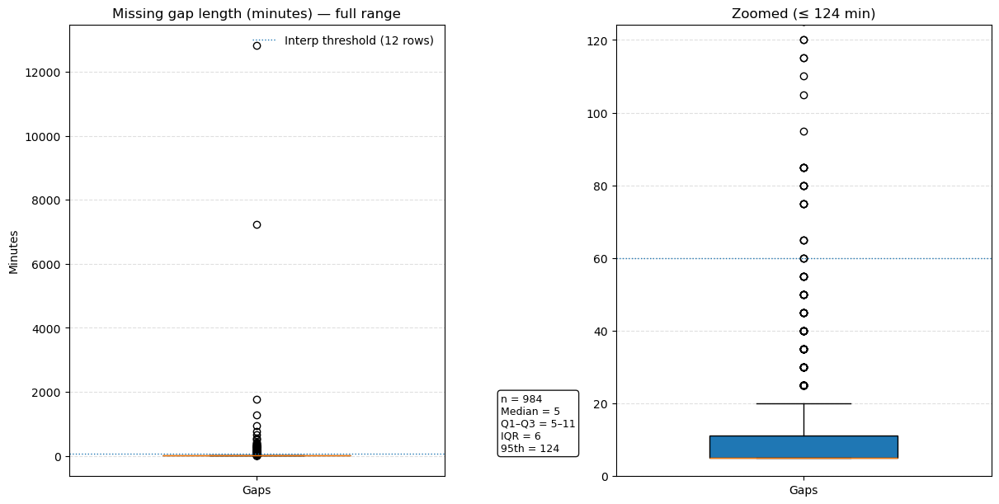

In [78]:
plot_missing_gaps_box(missing_grid_time_ranges, step_minutes=5, interp_threshold_n=12, zoom='p95')

In [79]:
stats = prepare_missing_gap_stats(missing_grid_time_ranges, step_minutes=5)

print(stats["summary"].to_pandas().to_string(index=False))
display(stats["by_year"].to_pandas().head())
display(stats["by_year_month"].to_pandas().head())
display(stats["top_gaps"].to_pandas())

 n_gap_periods  rows_missing  hours_missing  days_missing  avg_gap_minutes  median_gap_minutes  max_gap_minutes
           984          9461     788.416667     32.850694        48.074187                 5.0          12835.0


,gap_start_year,n_gap_periods,rows_missing,hours_missing,days_missing,avg_gap_minutes,median_gap_minutes,max_gap_minutes
0,2020,38,162,13.500000,0.562500,21.315789,5.0,275.0
1,2021,171,399,33.250000,1.385417,11.666667,5.0,295.0
2,2022,339,4224,352.000000,14.666667,62.300885,5.0,7235.0
3,2023,215,1057,88.083333,3.670139,24.581395,5.0,955.0
4,2024,153,767,63.916667,2.663194,25.065359,5.0,1285.0


,year_month,n_gap_periods,rows_missing,hours_missing,avg_gap_minutes,median_gap_minutes
0,2020-01,3,9,0.750000,15.000000,15.0
1,2020-02,3,3,0.250000,5.000000,5.0
2,2020-03,8,64,5.333333,40.000000,10.0
3,2020-04,12,16,1.333333,6.666667,5.0
4,2020-06,2,5,0.416667,12.500000,12.5


,missing_start,missing_end,n_missing,gap_minutes,gap_hours,gap_days
0,2025-05-10 17:10:00,2025-05-19 15:00:00,2567,12835.0,213.916667,8.913194
1,2022-04-27 15:35:00,2022-05-02 16:05:00,1447,7235.0,120.583333,5.024306
2,2022-03-24 11:30:00,2022-03-25 17:00:00,355,1775.0,29.583333,1.232639
3,2024-12-21 17:05:00,2024-12-22 14:25:00,257,1285.0,21.416667,0.892361
4,2023-02-26 14:15:00,2023-02-27 06:05:00,191,955.0,15.916667,0.663194
5,2023-06-07 19:25:00,2023-06-08 07:55:00,151,755.0,12.583333,0.524306
6,2023-03-01 18:05:00,2023-03-02 04:55:00,131,655.0,10.916667,0.454861
7,2022-05-04 23:00:00,2022-05-05 08:05:00,110,550.0,9.166667,0.381944
8,2022-07-05 17:35:00,2022-07-06 02:15:00,105,525.0,8.750000,0.364583
9,2022-06-03 11:00:00,2022-06-03 19:25:00,102,510.0,8.500000,0.354167


### Testing Gap Filling

In [80]:
grid_readings_pldf.schema

Schema([('timestamp', Datetime(time_unit='us', time_zone=None)),
        ('thermal_generation', Float64),
        ('gas_generation', Float64),
        ('g_co2_per_kwh', Float64),
        ('hydro_generation', Float64),
        ('nuclear_generation', Float64),
        ('renewable_generation', Float64),
        ('tons_co2', Float64),
        ('total_generation', Float64),
        ('tons_co2_per_mwh', Float64),
        ('demand_met', Float64),
        ('net_demand', Float64)])

In [81]:
grid_readings_value_columns = ["thermal_generation", "gas_generation", "g_co2_per_kWh",
                               "hydro_generation", "renewable_generation", "tons_co2",
                               "total_generation", "total_generation", "demand_met",
                               "net_demand"]

In [82]:
grid_readings_full_time_grid.sample(3)

timestamp
datetime[μs]
2024-04-25 02:20:00
2021-01-24 23:15:00
2021-11-09 09:35:00


In [83]:
full_time_join_grid_data = (
    grid_readings_full_time_grid
    .join(grid_readings_pldf, on="timestamp", how="left")
)

In [84]:
full_time_join_grid_data.sample(3)

timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
datetime[μs],f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
2024-08-03 21:55:00,138423.0,3142.0,689.157352,33020.0,6848.0,16335.0,11357.7726,197768.0,0.689157,195859.0,181433.0
2020-06-21 12:10:00,85108.0,7505.0,596.900811,26476.0,4383.0,21119.0,7192.2071,144591.0,0.596901,143005.0,123472.0
2024-08-18 00:20:00,149045.0,4709.0,724.487779,34404.0,6944.0,8281.0,12279.0415,203383.0,0.724488,202573.0,195102.0


In [85]:
full_time_join_grid_data.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0
"""mean""","""2022-09-17 11:57:30""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 12:00:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-25 17:55:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


#### Filling Short Gaps

In [86]:
gaps_before = find_null_runs(full_time_join_grid_data, ref_col="demand_met")
n_null_before = count_null_rows(full_time_join_grid_data, "demand_met")


In [87]:
print(f"Rows (total): {full_time_join_grid_data.height:,}")
print(f"Rows null before (demand_met): {n_null_before:,}")
print("Short preview of gaps before:")
print(gaps_before.head(10).to_pandas().to_string(index=False))

Rows (total): 570,528
Rows null before (demand_met): 9,461
Short preview of gaps before:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2020-01-03 22:30:00 2020-01-03 22:40:00          3            2020                1
2020-01-24 00:10:00 2020-01-24 00:30:00          5            2020                1
2020-01-31 16:45:00 2020-01-31 16:45:00          1            2020                1
2020-02-18 11:40:00 2020-02-18 11:40:00          1            2020                2
2020-02-19 16:00:00 2020-02-19 16:00:00          1            2020                2
2020-02-26 04:50:00 2020-02-26 04:50:00          1            2020                2
2020-03-03 17:25:00 2020-03-03 17:25:00          1            2020                3
2020-03-13 05:40:00 2020-03-13 05:40:00          1            2020                3
2020-03-18 18:50:00 2020-03-18 19:00:00          3            2020                3
2020-03-19 05:05:00 2020-03-19 05:20:00          4            2020     

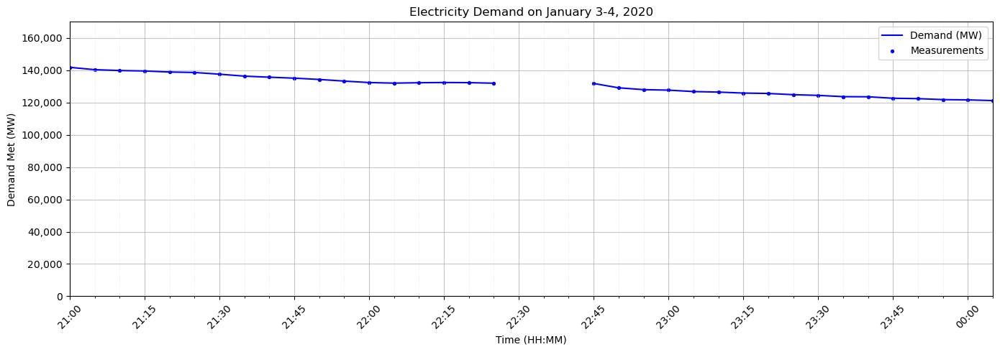

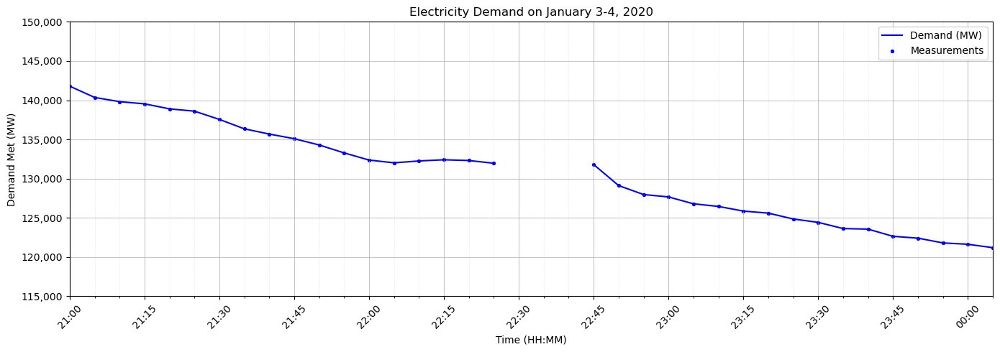

In [88]:
short_start_boundary = datetime(2020, 1, 3, 21, 0)
short_end_boundary = datetime(2020, 1, 4, 0, 5)

plot_time_series_with_ticks(
    df=full_time_join_grid_data,
    timestamp_col="timestamp",
    plot_col="demand_met",
    start_boundary=short_start_boundary,
    end_boundary=short_end_boundary,
    x_label="Time (HH:MM)",
    y_label="Demand Met (MW)",
    title="Electricity Demand on January 3-4, 2020",
    line_label="Demand (MW)",
    point_label="Measurements",
    point_color="blue",
    point_size=8,
    rotate_xticks=45,
    ylim =(0,170000)
)
plot_time_series_with_ticks(
    df=full_time_join_grid_data,
    timestamp_col="timestamp",
    plot_col="demand_met",
    start_boundary=short_start_boundary,
    end_boundary=short_end_boundary,
    x_label="Time (HH:MM)",
    y_label="Demand Met (MW)",
    title="Electricity Demand on January 3-4, 2020",
    line_label="Demand (MW)",
    point_label="Measurements",
    point_color="blue",
    point_size=8,
    rotate_xticks=45,
    ylim =(115000,150000)
)

In [89]:
full_time_join_grid_data_step1, gaps_before_dup = fill_short_gaps_linear(
    full_time_join_grid_data,
    ref_col="demand_met",
    step_minutes=5,
    max_gap_minutes=80,
)

In [90]:
gaps_after = find_null_runs(full_time_join_grid_data_step1, ref_col="demand_met")
n_null_after = count_null_rows(full_time_join_grid_data_step1, "demand_met")

In [91]:
print(f"\nRows null after (demand_met): {n_null_after:,}")
print("Short preview of gaps after:")
print(gaps_after.head(10).sort("n_missing", descending=False).to_pandas().to_string(index=False))


Rows null after (demand_met): 7,552
Short preview of gaps after:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2021-04-04 00:40:00 2021-04-04 02:00:00         17            2021                4
2021-09-27 16:05:00 2021-09-27 17:25:00         17            2021                9
2022-01-04 10:50:00 2022-01-04 12:20:00         19            2022                1
2022-01-12 12:15:00 2022-01-12 14:05:00         23            2022                1
2021-10-06 10:05:00 2021-10-06 12:05:00         25            2021               10
2022-01-11 05:45:00 2022-01-11 07:45:00         25            2022                1
2021-09-12 10:20:00 2021-09-12 12:30:00         27            2021                9
2020-03-24 16:10:00 2020-03-24 20:10:00         49            2020                3
2020-07-14 03:40:00 2020-07-14 08:10:00         55            2020                7
2021-09-03 13:20:00 2021-09-03 18:10:00         59            2021                9


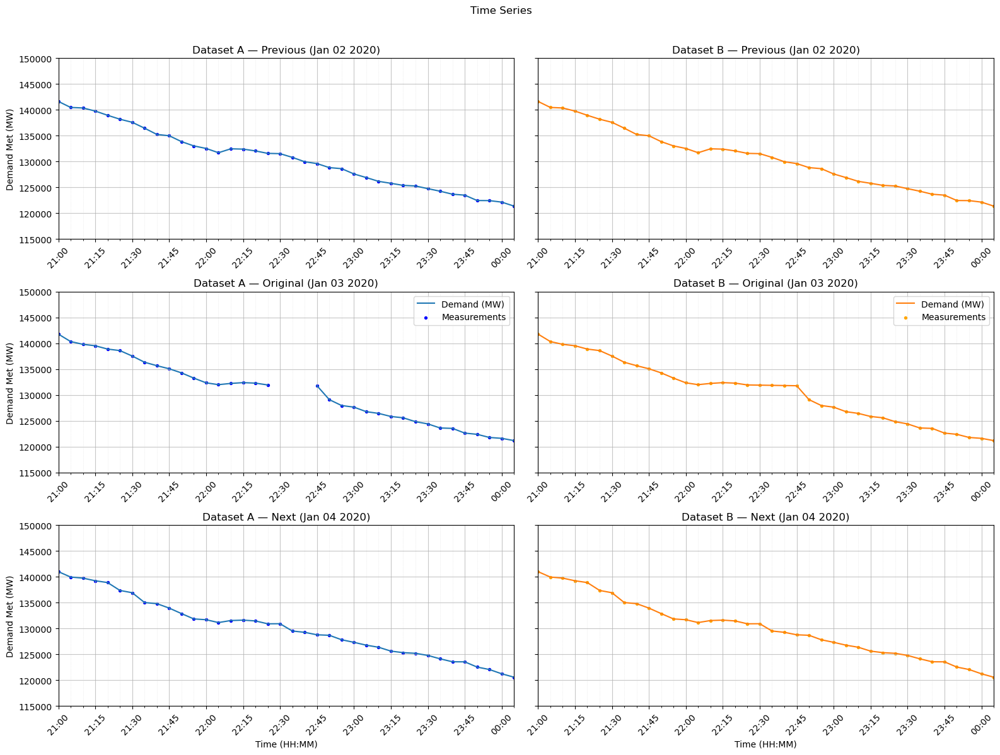

In [92]:
short_start_boundary_2 = datetime(2020, 1, 3, 21, 0)
short_end_boundary_2 = datetime(2020, 1, 4, 0, 5)

plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data,
    df_right=full_time_join_grid_data_step1,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=short_start_boundary_2,
    end_boundary=short_end_boundary_2,
    x_label="Time (HH:MM)",
    y_label="Demand Met (MW)",
    line_label="Demand (MW)",
    point_label="Measurements",
    point_color_left="blue",
    point_color_right="orange",
    point_size=8,
    rotate_xticks=45,
    ylim=(115000, 150000),
    offset_hours=24
)


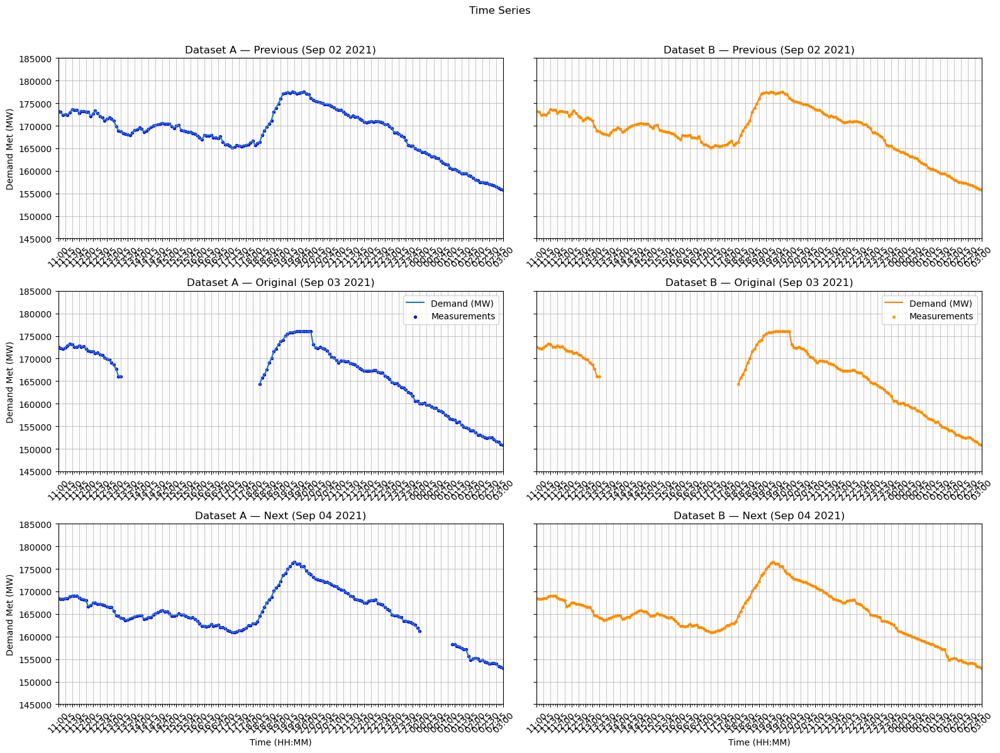

In [93]:
short_start_boundary_3 = datetime(2021, 9, 3, 11)
short_end_boundary_3 = datetime(2021, 9, 4, 3)

plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data,
    df_right=full_time_join_grid_data_step1,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=short_start_boundary_3,
    end_boundary=short_end_boundary_3,
    x_label="Time (HH:MM)",
    y_label="Demand Met (MW)",
    line_label="Demand (MW)",
    point_label="Measurements",
    point_color_left="blue",
    point_color_right="orange",
    point_size=8,
    rotate_xticks=45,
    ylim=(145000, 185000),
    offset_hours=24
)

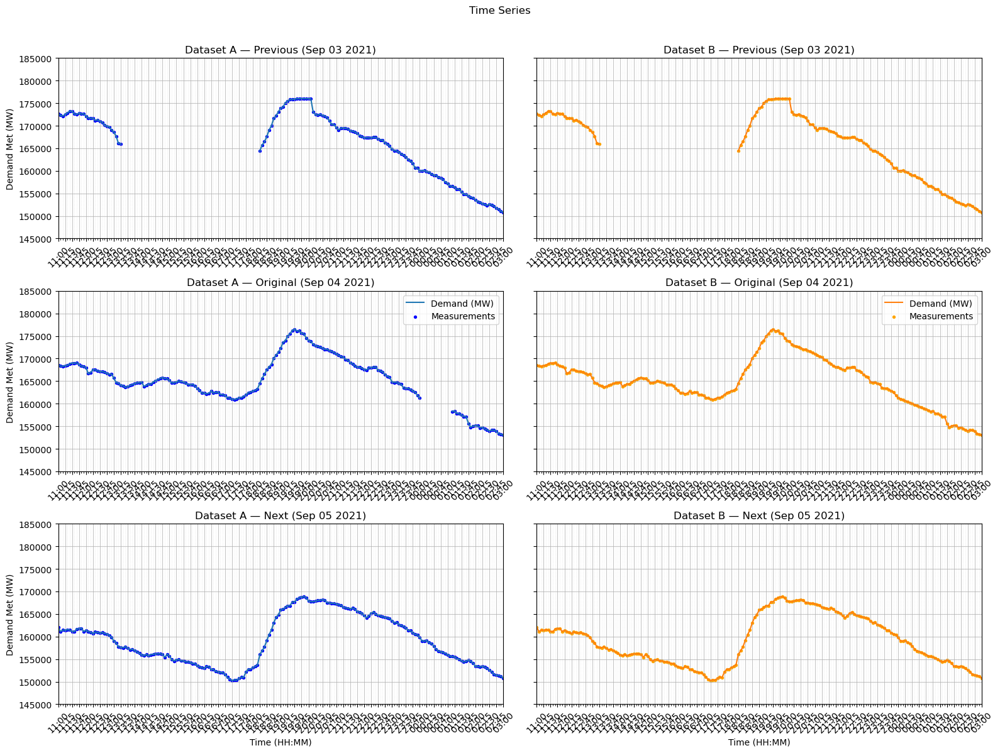

In [94]:
short_start_boundary_4 = datetime(2021, 9, 4, 11)
short_end_boundary_4 = datetime(2021, 9, 5, 3)

plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data,
    df_right=full_time_join_grid_data_step1,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=short_start_boundary_4,
    end_boundary=short_end_boundary_4,
    x_label="Time (HH:MM)",
    y_label="Demand Met (MW)",
    line_label="Demand (MW)",
    point_label="Measurements",
    point_color_left="blue",
    point_color_right="orange",
    point_size=8,
    rotate_xticks=45,
    ylim=(145000, 185000),
    offset_hours=24
)

In [95]:
full_time_join_grid_data.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0
"""mean""","""2022-09-17 11:57:30""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 12:00:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-25 17:55:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [96]:
full_time_join_grid_data_step1.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0
"""null_count""","""0""",7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0
"""mean""","""2022-09-17 11:57:30""",127199.019975,3886.187208,734.053673,17814.696644,5096.030567,17972.861623,10474.292442,171968.796016,0.734054,170764.609036,153995.934393
"""std""",null,20946.222099,1625.291463,76.561261,8654.356929,788.518343,14589.119685,1692.219892,26447.082876,0.076561,26149.51554,22130.380918
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111733.5,2562.5,681.12483,10083.5,4444.0,6697.0,9220.1858,153312.0,0.681125,152278.5,138367.5
"""50%""","""2022-09-17 12:00:00""",128429.5,3461.0,734.381423,16951.0,5125.0,12785.0,10550.7235,172328.0,0.734381,170950.0,153930.0
"""75%""","""2024-01-25 17:55:00""",143163.0,4935.0,797.276058,24889.5,5571.0,25141.5,11748.6734,192489.0,0.797276,190924.5,169373.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


#### Filling Longer Gaps

In [97]:
gaps_after = find_null_runs(full_time_join_grid_data_step1, ref_col="demand_met")
n_null_after = count_null_rows(full_time_join_grid_data_step1, "demand_met")

In [98]:
print(f"\nRows null after (demand_met): {n_null_after:,}")
print("Short preview of gaps after:")
print(gaps_after.head(10).to_pandas().to_string(index=False))


Rows null after (demand_met): 7,552
Short preview of gaps after:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2020-03-24 16:10:00 2020-03-24 20:10:00         49            2020                3
2020-07-14 03:40:00 2020-07-14 08:10:00         55            2020                7
2021-04-04 00:40:00 2021-04-04 02:00:00         17            2021                4
2021-09-03 13:20:00 2021-09-03 18:10:00         59            2021                9
2021-09-12 10:20:00 2021-09-12 12:30:00         27            2021                9
2021-09-27 16:05:00 2021-09-27 17:25:00         17            2021                9
2021-10-06 10:05:00 2021-10-06 12:05:00         25            2021               10
2022-01-04 10:50:00 2022-01-04 12:20:00         19            2022                1
2022-01-11 05:45:00 2022-01-11 07:45:00         25            2022                1
2022-01-12 12:15:00 2022-01-12 14:05:00         23            2022                1


In [99]:
print(f"\nRows null after (demand_met): {n_null_after:,}")
print("Short preview of gaps after:")
print(gaps_after.sample(10).to_pandas().to_string(index=False))


Rows null after (demand_met): 7,552
Short preview of gaps after:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2024-04-06 12:35:00 2024-04-06 15:30:00         36            2024                4
2024-06-28 09:20:00 2024-06-28 11:30:00         27            2024                6
2022-01-22 12:35:00 2022-01-22 15:35:00         37            2022                1
2022-02-04 09:30:00 2022-02-04 15:50:00         77            2022                2
2023-06-07 19:25:00 2023-06-08 07:55:00        151            2023                6
2022-01-22 00:50:00 2022-01-22 05:50:00         61            2022                1
2021-09-27 16:05:00 2021-09-27 17:25:00         17            2021                9
2023-08-24 18:15:00 2023-08-24 21:55:00         45            2023                8
2022-07-03 08:45:00 2022-07-03 15:15:00         79            2022                7
2023-01-02 06:30:00 2023-01-02 11:00:00         55            2023                1


In [100]:
# Defining the date boundaries to look at
start_boundary_1 = datetime(2020, 3, 24, 12)
end_boundary_1 = datetime(2020, 3, 24, 23)
ylim_1 = (100000, 150000)

start_boundary_2 = datetime(2021, 9, 3, 12)
end_boundary_2 = datetime(2021, 9, 3, 20)
ylim_2 = (150000, 180000)

start_boundary_3 = datetime(2021, 9, 4, 11)
end_boundary_3= datetime(2021, 9, 5, 3)
ylim_3 = (140000, 180000)

start_boundary_4 = datetime(2021, 9, 12, 10)
end_boundary_4 = datetime(2021, 9, 12, 15)
ylim_4 = (130000, 185000)

start_boundary_5 = datetime(2022, 4, 26, 0)
end_boundary_5 = datetime(2022, 5, 2, 23)
ylim_5 = (160000, 210000)

start_boundary_6 = datetime(2022, 4, 27, 0)
end_boundary_6 = datetime(2022, 5, 2, 23)
ylim_6 = (160000, 210000)

start_boundary_7 = datetime(2022, 5, 1, 0)
end_boundary_7 = datetime(2022, 5, 1, 23)
ylim_7 = (165000, 210000)

start_boundary_8 = datetime(2023, 3, 1, 15)
end_boundary_8 = datetime(2023, 3, 2, 7)
ylim_8 = (150000, 205000)

start_boundary_9 = datetime(2024, 4, 6, 10)
end_boundary_9 = datetime(2024, 4, 6, 18)
ylim_9 = (170000, 220000)

start_boundary_10 = datetime(2025, 5, 15, 6)
end_boundary_10 = datetime(2025, 5, 16, 6)
ylim_10 = (170000, 230000)

##### Scaled

In [101]:
full_time_join_grid_data_step2_scaling, audit_long = fill_long_gaps_scaled_daily_template(
    full_time_join_grid_data_step1,
    ref_col="demand_met",
    scaling_col="demand_met",   # same as ref_col is now fine
    step_minutes=5,
    max_search_days=30,
    min_calib_points=12,
    edge_calib_hours=2.0,
    require_both_sides=False,
    scale_cap=(0.25, 4.0),
)

print(f"Filled timestamps (donor-based): {audit_long.height}")
# Confirm there are no nulls left in your main value columns
cols = ["thermal_generation","gas_generation","g_co2_per_kwh","hydro_generation",
        "nuclear_generation","renewable_generation","tons_co2","total_generation",
        "tons_co2_per_mwh","demand_met","net_demand"]
print(full_time_join_grid_data_step2_scaling.select([pl.any_horizontal([pl.col(c).is_null() for c in cols]).alias('any_null')]).to_pandas())

Filled timestamps (donor-based): 7552
        any_null
0          False
1          False
2          False
3          False
4          False
...          ...
570523     False
570524     False
570525     False
570526     False
570527     False

[570528 rows x 1 columns]


In [102]:
full_time_join_grid_data_step1.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0
"""null_count""","""0""",7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0
"""mean""","""2022-09-17 11:57:30""",127199.019975,3886.187208,734.053673,17814.696644,5096.030567,17972.861623,10474.292442,171968.796016,0.734054,170764.609036,153995.934393
"""std""",null,20946.222099,1625.291463,76.561261,8654.356929,788.518343,14589.119685,1692.219892,26447.082876,0.076561,26149.51554,22130.380918
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111733.5,2562.5,681.12483,10083.5,4444.0,6697.0,9220.1858,153312.0,0.681125,152278.5,138367.5
"""50%""","""2022-09-17 12:00:00""",128429.5,3461.0,734.381423,16951.0,5125.0,12785.0,10550.7235,172328.0,0.734381,170950.0,153930.0
"""75%""","""2024-01-25 17:55:00""",143163.0,4935.0,797.276058,24889.5,5571.0,25141.5,11748.6734,192489.0,0.797276,190924.5,169373.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [103]:
full_time_join_grid_data_step2_scaling.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-17 11:57:30""",127433.483058,3882.279692,734.548309,17837.567188,5101.373619,17972.595912,10493.184313,172227.299469,0.734548,171014.032109,154254.703557
"""std""",null,21003.69934,1618.537961,76.690398,8633.570425,793.358957,14558.496097,1696.998106,26471.297725,0.07669,26167.138575,22229.557501
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111921.0,2567.0,681.430697,10113.0,4443.0,6741.0,9233.38745,153530.5,0.681431,152491.0,138514.0
"""50%""","""2022-09-17 12:00:00""",128694.5,3465.0,735.046458,17027.0,5126.5,12871.5,10572.3041,172656.0,0.735046,171279.5,154124.0
"""75%""","""2024-01-25 17:55:00""",143446.5,4917.0,797.778692,24856.5,5583.0,25082.0,11773.3448,192786.0,0.797779,191208.0,169737.0
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,1131.267146,45871.5,7124.1284,82136.0,14812.6736,258643.0,1.131267,256491.0,225340.0


In [104]:
full_time_join_grid_data_step2_scaling = recompute_intensities_from_rates(full_time_join_grid_data_step2_scaling)

In [105]:
full_time_join_grid_data_step2_scaling.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-17 11:57:30""",127433.483058,3882.279692,734.327352,17837.567188,5101.373619,17972.595912,10493.184313,172227.299469,0.734327,171014.032109,154254.703557
"""std""",null,21003.69934,1618.537961,76.029991,8633.570425,793.358957,14558.496097,1696.998106,26471.297725,0.07603,26167.138575,22229.557501
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,535.635869,509.0,2275.0,478.5,5549.6103,88658.0,0.535636,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111921.0,2567.0,681.537788,10113.0,4443.0,6741.0,9233.38745,153530.5,0.681538,152491.0,138514.0
"""50%""","""2022-09-17 12:00:00""",128694.5,3465.0,734.951205,17027.0,5126.5,12871.5,10572.3041,172656.0,0.734951,171279.5,154124.0
"""75%""","""2024-01-25 17:55:00""",143446.5,4917.0,796.885604,24856.5,5583.0,25082.0,11773.3448,192786.0,0.796886,191208.0,169737.0
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,883.726868,45871.5,7124.1284,82136.0,14812.6736,258643.0,0.883727,256491.0,225340.0


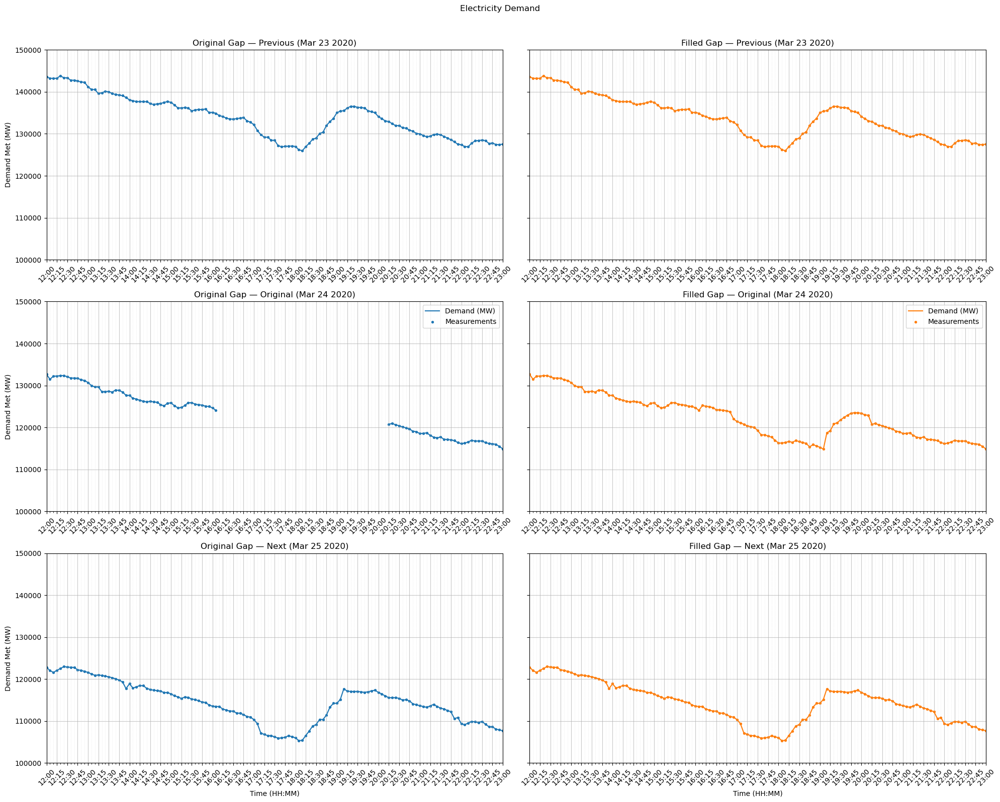

In [106]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_scaling,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_1,
    end_boundary=end_boundary_1,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_1,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


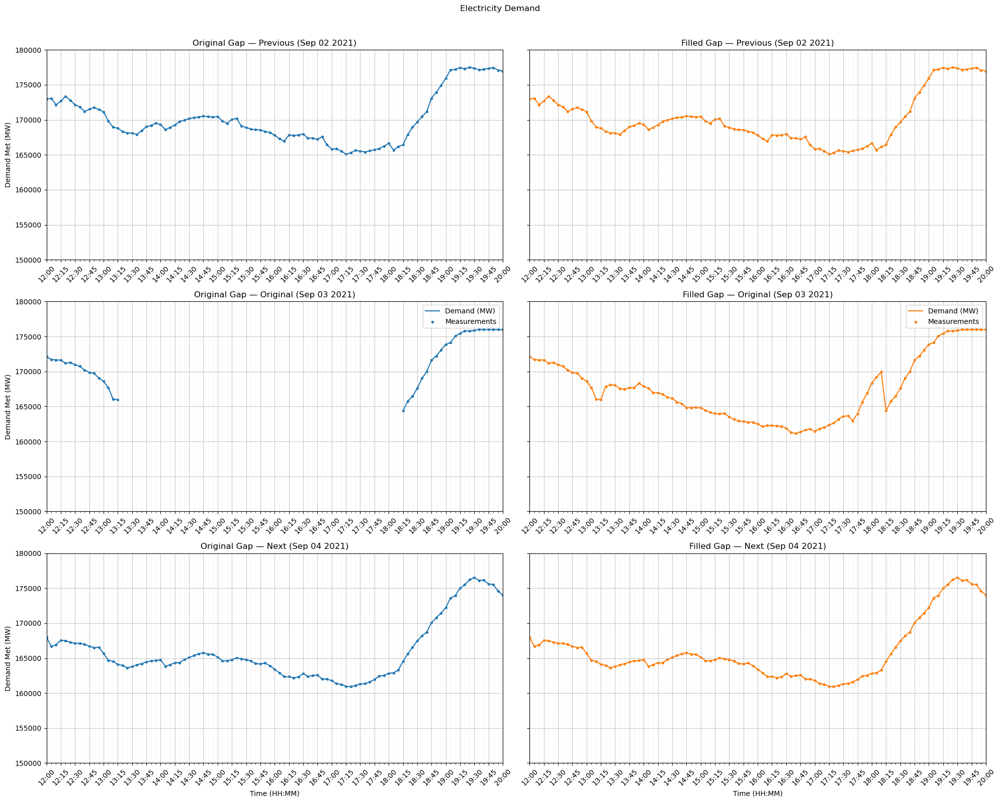

In [107]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_scaling,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_2,
    end_boundary=end_boundary_2,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_2,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


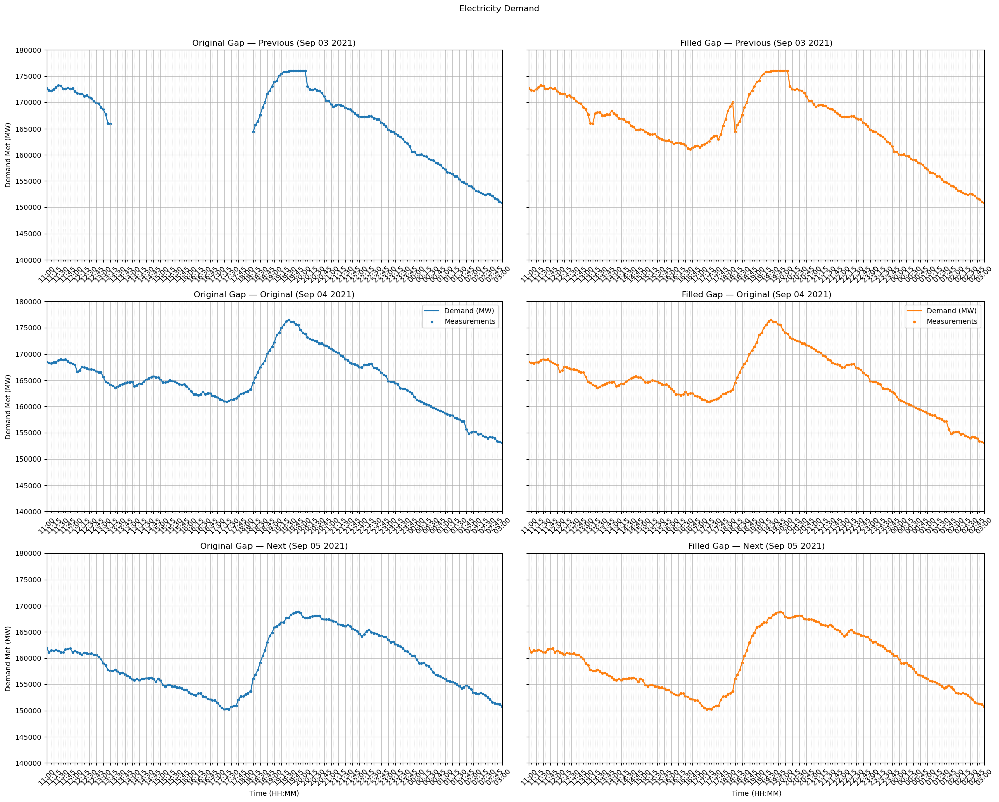

In [108]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_scaling,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_3,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

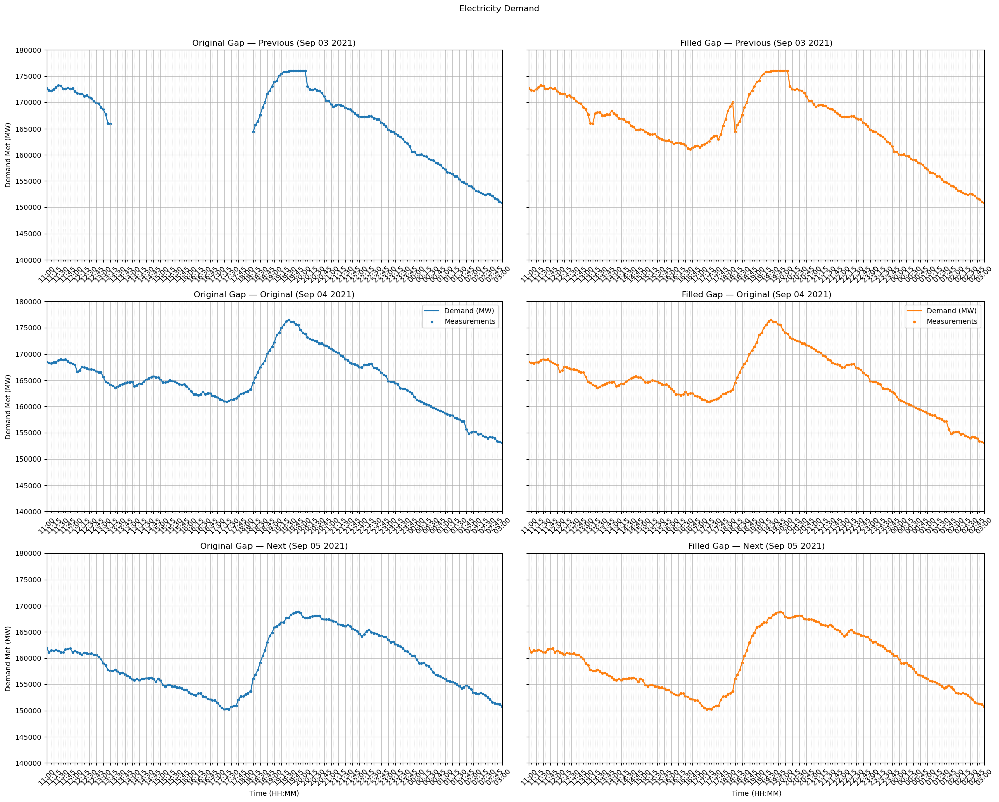

In [109]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_scaling,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_3,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1910

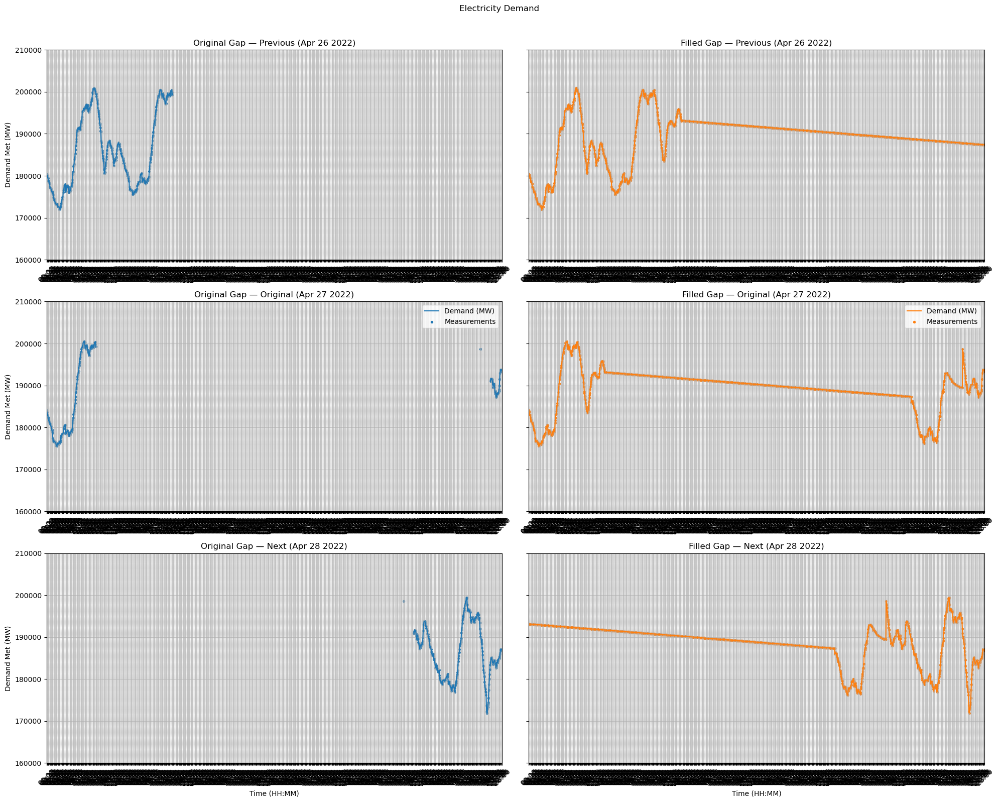

In [110]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_scaling,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_6,
    end_boundary=end_boundary_6,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_6,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

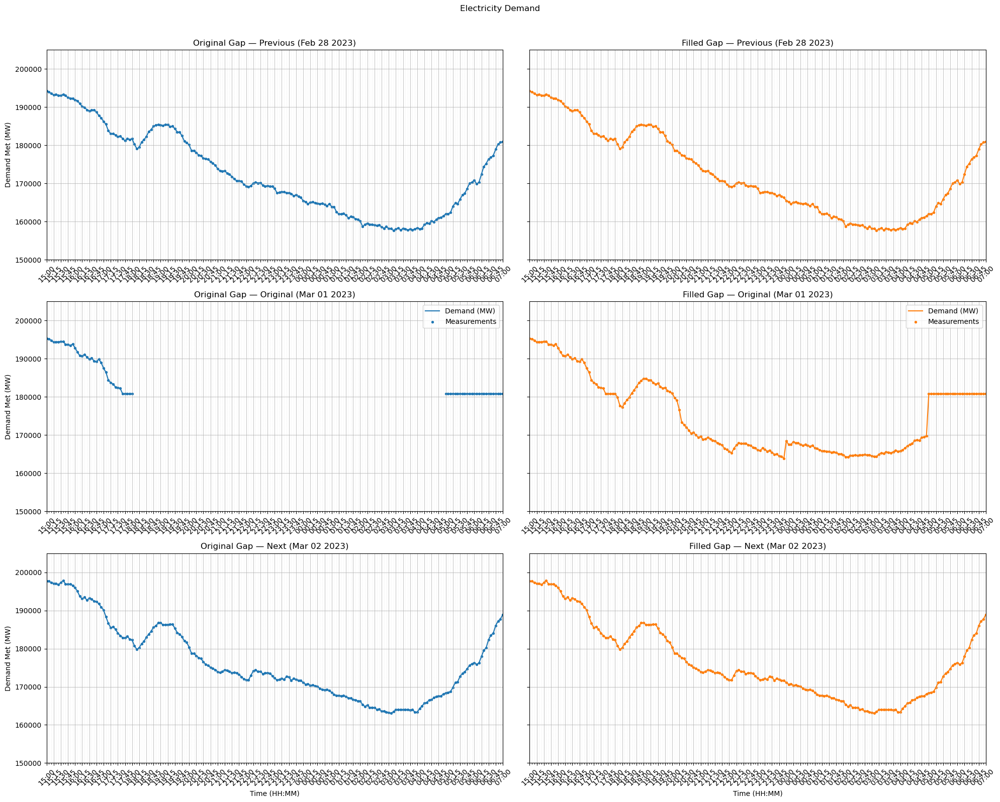

In [111]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_scaling,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_8,
    end_boundary=end_boundary_8,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_8,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

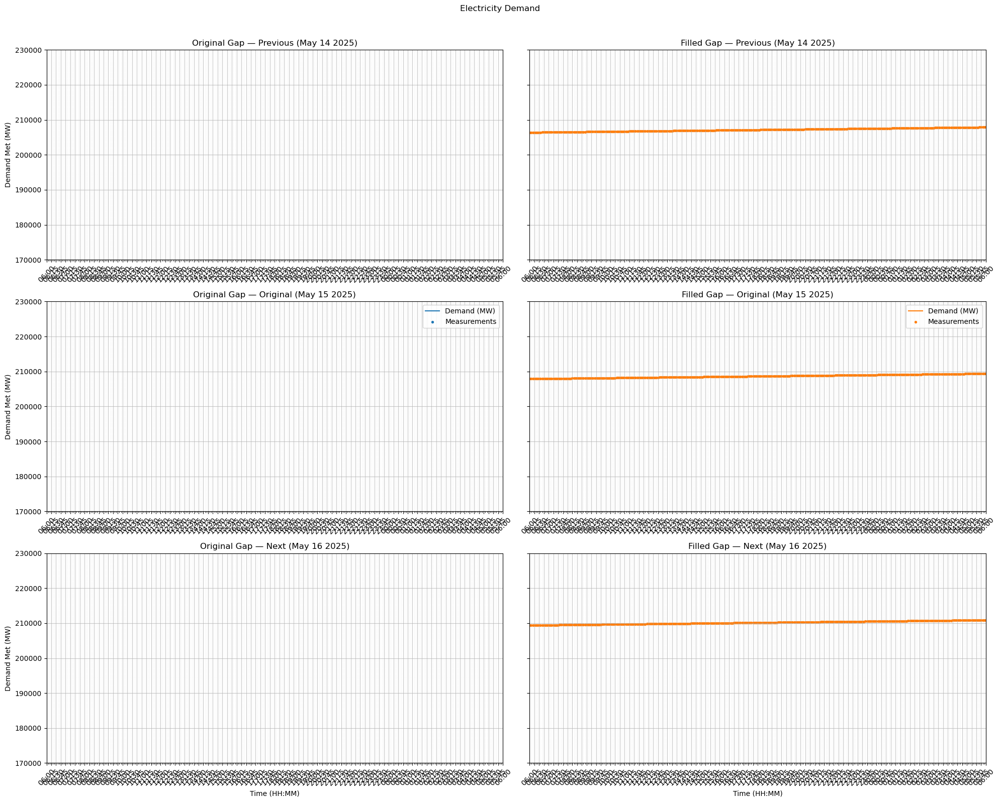

In [112]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_scaling,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_10,
    end_boundary=end_boundary_10,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_10,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

##### Gradient Filling

In [113]:
full_time_join_grid_data_step2_gradient_smooth_5, audit_grad = fill_long_gaps_by_gradient(
    full_time_join_grid_data_step1,
    ref_col="demand_met",
    fill_cols=None,
    step_minutes=5,
    max_search_days=12,
    smooth_window_slots=5,
    prefer_same_weekday=True,
    slot_tolerance=-0,
)

nonneg_cols = [
    "thermal_generation","gas_generation","hydro_generation","nuclear_generation",
    "renewable_generation","tons_co2","total_generation","demand_met","net_demand"
]

full_time_join_grid_data_step2_gradient_smooth_5 = clamp_nonneg(full_time_join_grid_data_step2_gradient_smooth_5, nonneg_cols)


In [114]:
full_time_join_grid_data_step1.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0
"""null_count""","""0""",7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0
"""mean""","""2022-09-17 11:57:30""",127199.019975,3886.187208,734.053673,17814.696644,5096.030567,17972.861623,10474.292442,171968.796016,0.734054,170764.609036,153995.934393
"""std""",null,20946.222099,1625.291463,76.561261,8654.356929,788.518343,14589.119685,1692.219892,26447.082876,0.076561,26149.51554,22130.380918
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111733.5,2562.5,681.12483,10083.5,4444.0,6697.0,9220.1858,153312.0,0.681125,152278.5,138367.5
"""50%""","""2022-09-17 12:00:00""",128429.5,3461.0,734.381423,16951.0,5125.0,12785.0,10550.7235,172328.0,0.734381,170950.0,153930.0
"""75%""","""2024-01-25 17:55:00""",143163.0,4935.0,797.276058,24889.5,5571.0,25141.5,11748.6734,192489.0,0.797276,190924.5,169373.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [115]:
full_time_join_grid_data_step2_gradient_smooth_5.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-17 11:57:30""",127354.008181,3881.194814,734.129828,17810.194509,5098.933951,18014.883592,10486.69027,172153.828953,0.73413,170945.208267,154144.331455
"""std""",null,20932.773384,1620.673765,76.657344,8630.202663,789.215123,14636.681353,1691.279023,26405.451314,0.076657,26107.940156,22121.133643
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,0.0,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111917.0,2564.0,681.208736,10113.0,4444.0,6720.0,9233.1448,153537.0,0.681209,152488.0,138511.0
"""50%""","""2022-09-17 12:00:00""",128645.0,3459.0,734.652968,16951.0,5127.0,12801.0,10568.2774,172642.5,0.734653,171273.0,154070.5
"""75%""","""2024-01-25 17:55:00""",143308.0,4921.0,797.23535,24840.5,5580.0,25198.5,11762.2083,192635.0,0.797235,191047.0,169536.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,997.887529,45871.5,7085.0,82136.0,14812.6736,258643.0,0.997888,256491.0,225340.0


In [116]:
full_time_join_grid_data_step2_gradient_smooth_5 = recompute_intensities_from_rates(full_time_join_grid_data_step2_gradient_smooth_5,
                                                                                    clamp_to_existing=True,
                                                                                    q_low=0.001,
                                                                                    q_high=0.999,
                                                                                    pad=0.05)

In [117]:
full_time_join_grid_data_step2_gradient_smooth_5.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-17 11:57:30""",127354.008181,3881.194814,734.118227,17810.194509,5098.933951,18014.883592,10486.69027,172153.828953,0.734118,170945.208267,154144.331455
"""std""",null,20932.773384,1620.673765,76.628853,8630.202663,789.215123,14636.681353,1691.279023,26405.451314,0.076629,26107.940156,22121.133643
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,483.400686,509.0,2275.0,0.0,5549.6103,88658.0,0.483401,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111917.0,2564.0,681.212362,10113.0,4444.0,6720.0,9233.1448,153537.0,0.681212,152488.0,138511.0
"""50%""","""2022-09-17 12:00:00""",128645.0,3459.0,734.652169,16951.0,5127.0,12801.0,10568.2774,172642.5,0.734652,171273.0,154070.5
"""75%""","""2024-01-25 17:55:00""",143308.0,4921.0,797.22063,24840.5,5580.0,25198.5,11762.2083,192635.0,0.797221,191047.0,169536.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,907.310407,45871.5,7085.0,82136.0,14812.6736,258643.0,0.90731,256491.0,225340.0


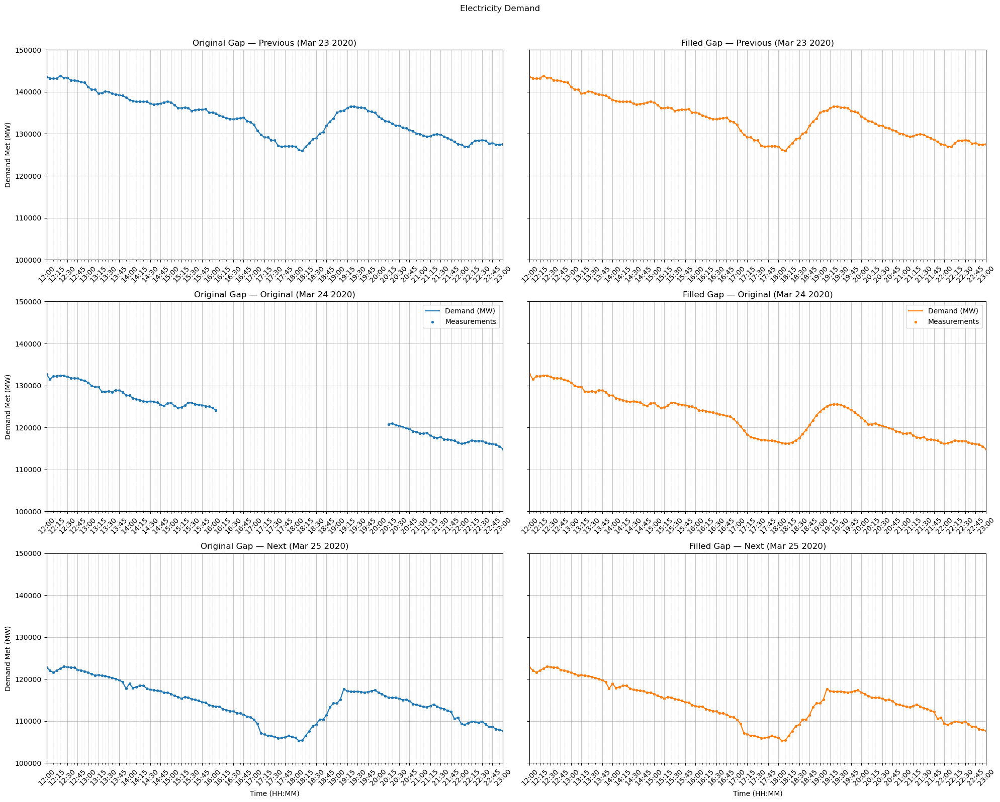

In [118]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_1,
    end_boundary=end_boundary_1,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_1,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


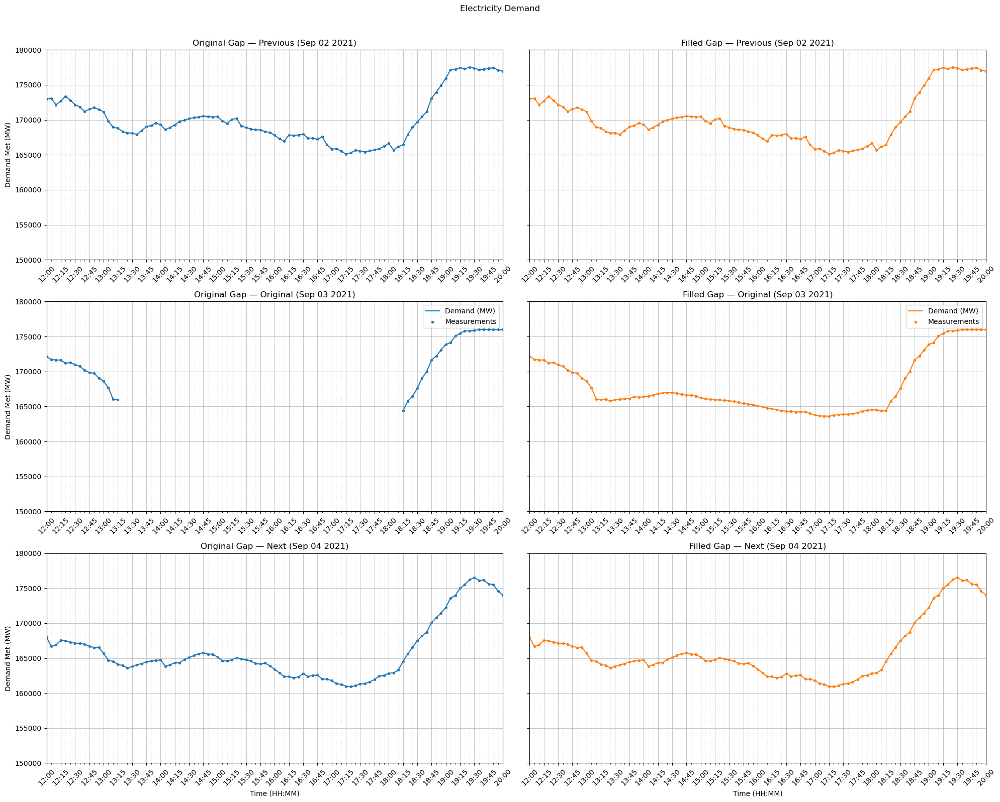

In [119]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_2,
    end_boundary=end_boundary_2,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_2,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


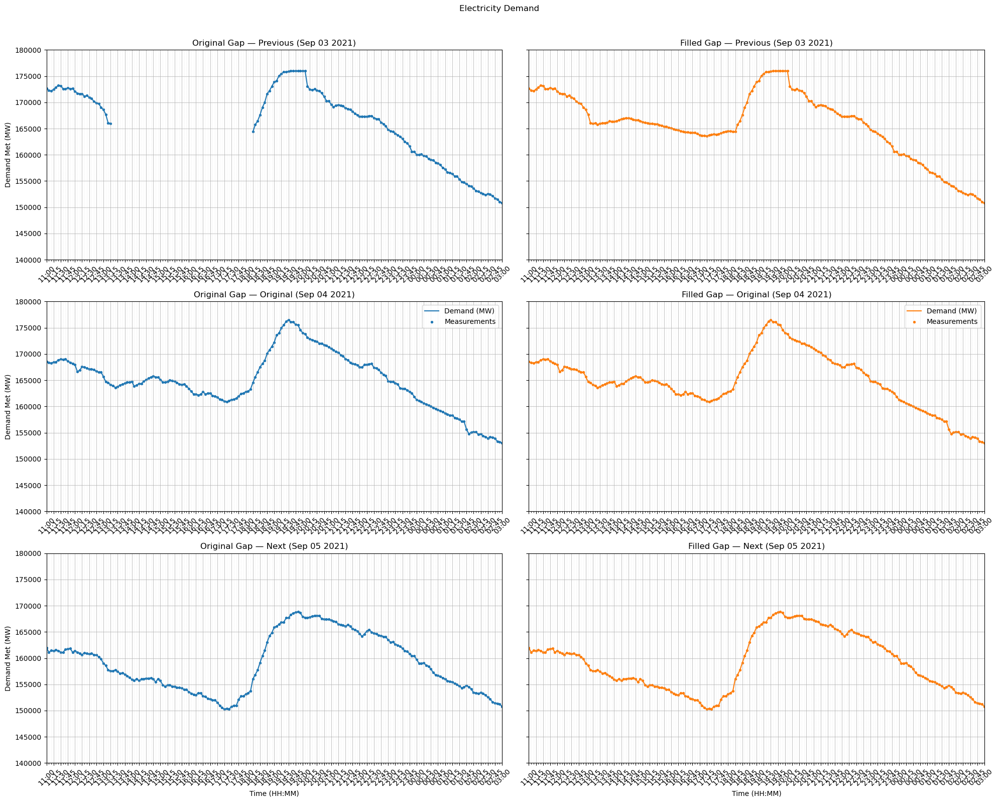

In [120]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_3,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

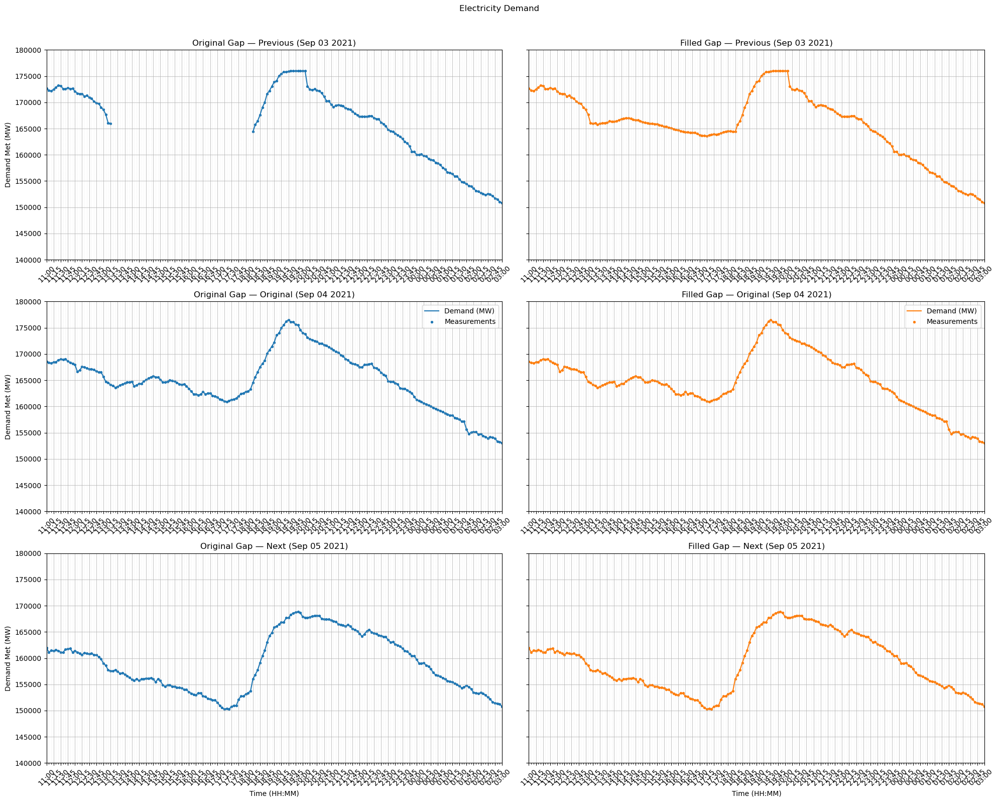

In [121]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_3,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19109.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19109.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([1910

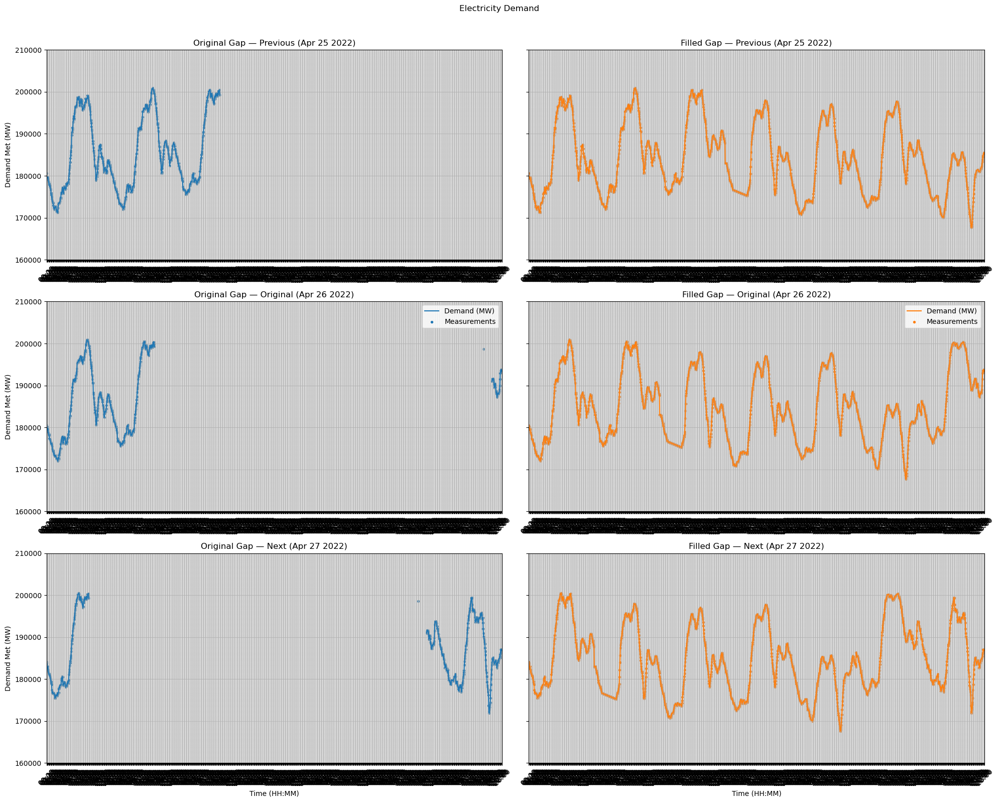

In [122]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_5,
    end_boundary=end_boundary_5,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_5,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1910

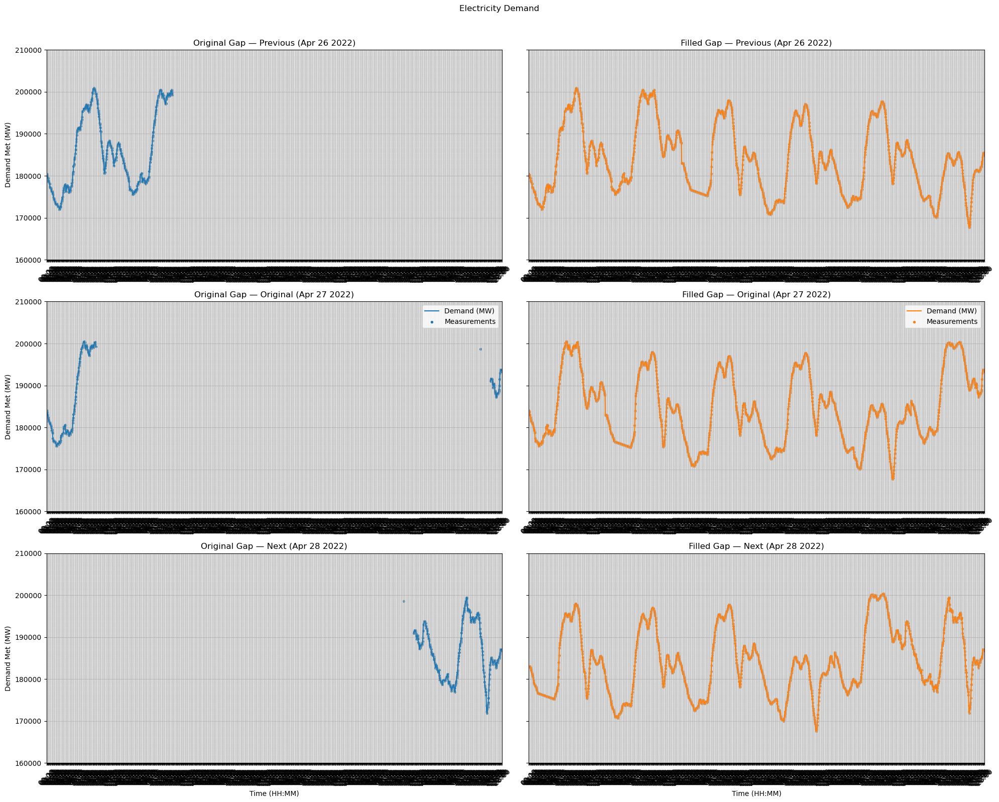

In [123]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_6,
    end_boundary=end_boundary_6,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_6,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1910

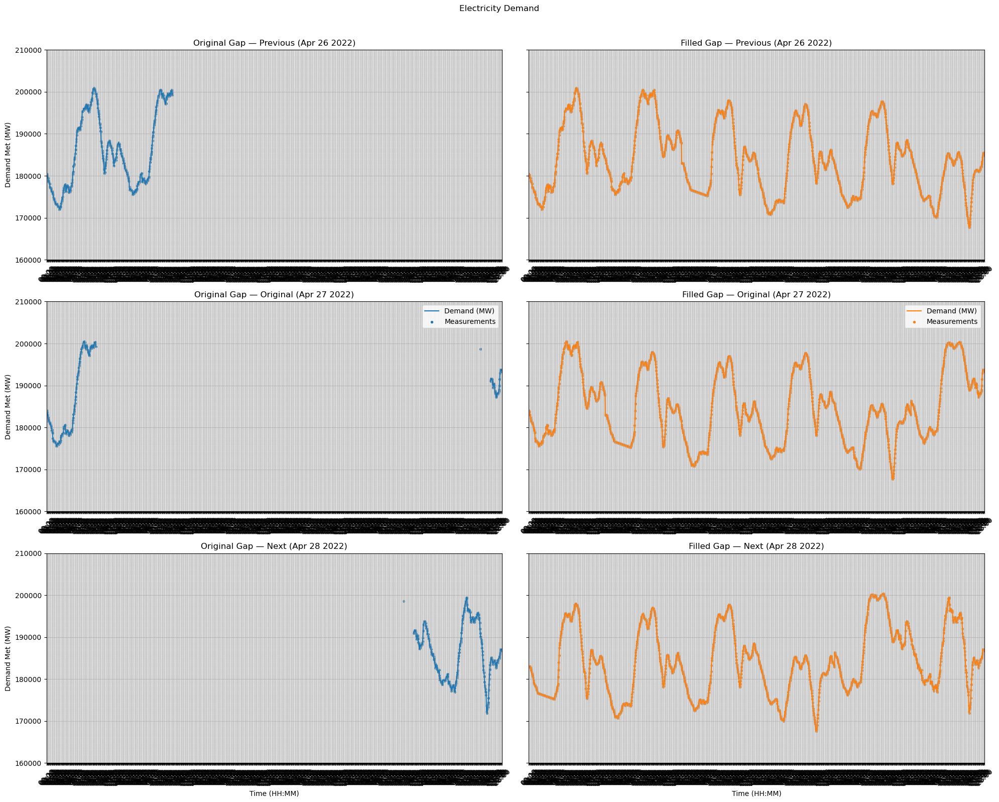

In [124]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_6,
    end_boundary=end_boundary_6,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_6,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

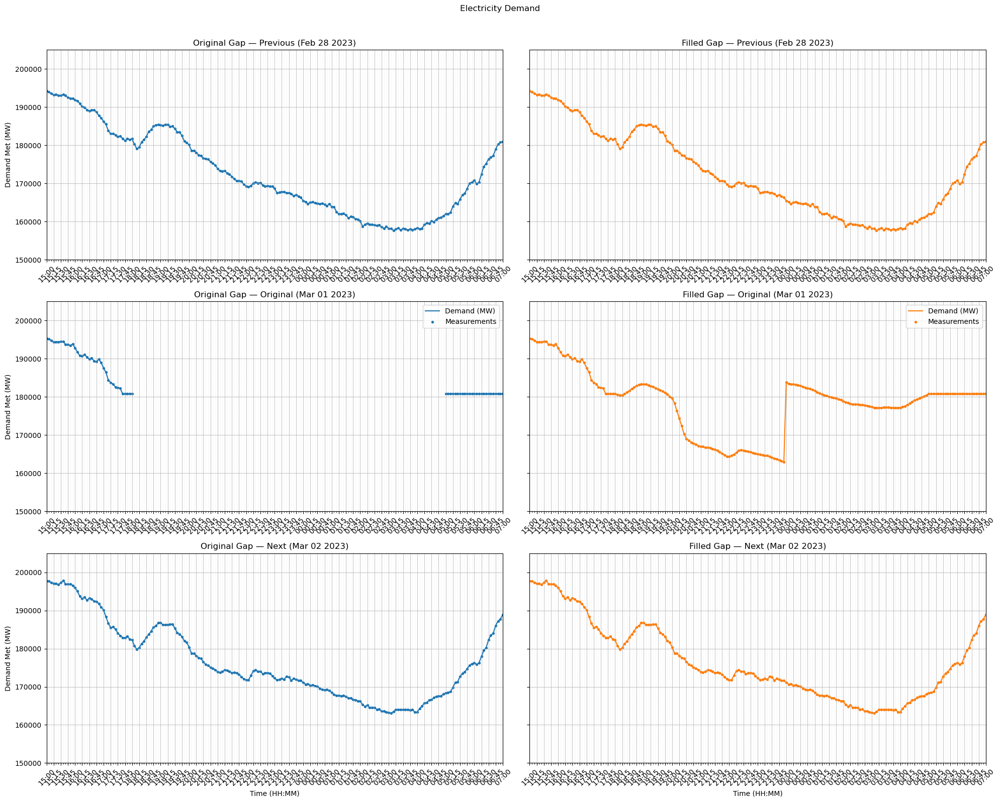

In [125]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_8,
    end_boundary=end_boundary_8,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_8,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

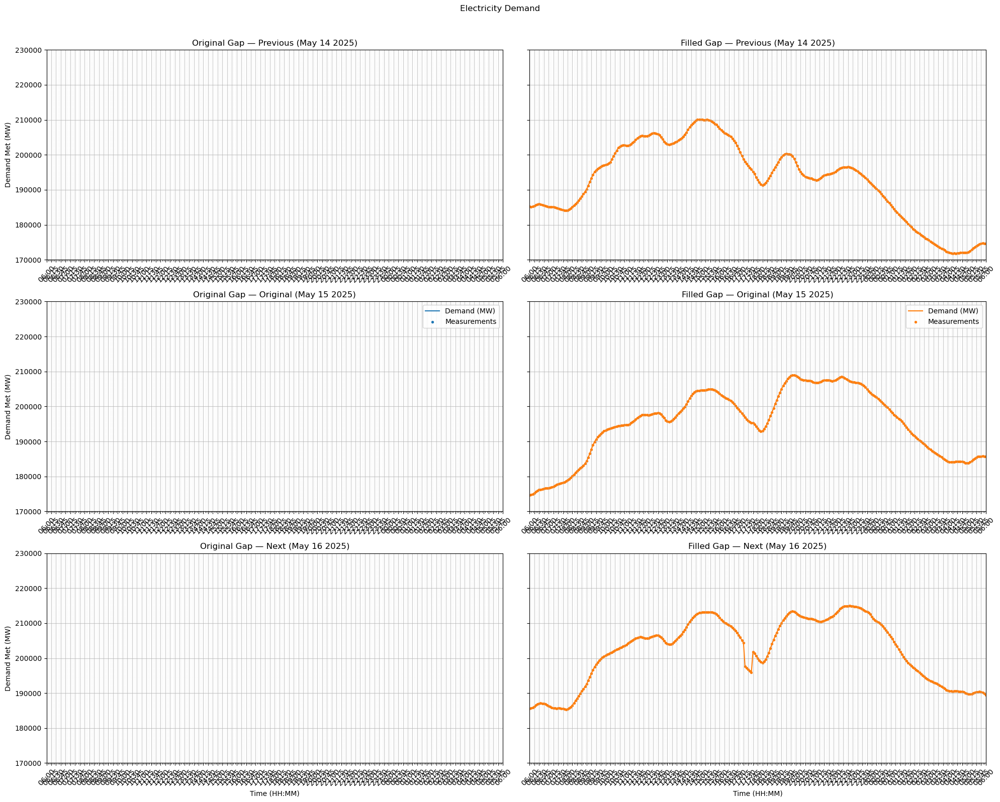

In [126]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_gradient_smooth_5,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_10,
    end_boundary=end_boundary_10,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_10,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

##### Combined Approach

In [127]:
# 1) run both from step1
step2_scaled, audit_scaled = fill_long_gaps_scaled_daily_template(
    full_time_join_grid_data_step1, ref_col="demand_met", scaling_col="demand_met",
    step_minutes=5, max_search_days=30, min_calib_points=12, edge_calib_hours=2.0,
    require_both_sides=False, scale_cap=(0.25, 4.0),
)

step2_grad, audit_grad = fill_long_gaps_by_gradient(
    full_time_join_grid_data_step1, ref_col="demand_met",
    fill_cols=[ "thermal_generation","gas_generation","g_co2_per_kwh","hydro_generation",
                "nuclear_generation","renewable_generation","tons_co2","total_generation",
                "tons_co2_per_mwh","demand_met","net_demand" ],
    step_minutes=5, max_search_days=12, smooth_window_slots=5,
)

# 2) combine (prefer gradient in the interior of original gaps)
full_time_join_grid_data_step2_combined = combine_scaled_and_gradient(
    df_scaled=step2_scaled,
    df_grad=step2_grad,
    audit_scaled=audit_scaled,
    timestamp_col="timestamp",
    cols=[ "thermal_generation","gas_generation","g_co2_per_kwh","hydro_generation",
           "nuclear_generation","renewable_generation","tons_co2","total_generation",
           "tons_co2_per_mwh","demand_met","net_demand" ],
    interior_margin_slots=2,
    ratio_guard=(0.5, 2.0),  # relax/tighten as you like
)

# 3) recompute derived intensities
full_time_join_grid_data_step2_combined = recompute_intensities_from_rates(full_time_join_grid_data_step2_combined)


In [128]:
full_time_join_grid_data_step2_combined.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-17 11:57:30""",127354.03041,3881.55476,734.208129,17814.239059,5098.966154,17954.528688,10486.691437,172154.841136,0.734208,170946.0002,154144.318294
"""std""",null,20932.838526,1619.8455,76.303175,8630.207089,789.328669,14548.411801,1691.281077,26406.165828,0.076303,26108.444606,22121.369872
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,535.011854,509.0,2275.0,-24339.995833,5549.6103,88658.0,0.535012,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111917.0,2565.0,681.20877,10113.5,4443.5,6736.0,9233.1448,153537.0,0.681209,152488.0,138510.0
"""50%""","""2022-09-17 12:00:00""",128645.0,3460.0,734.648455,16955.0,5127.0,12818.0,10568.2371,172643.5,0.734648,171273.5,154070.5
"""75%""","""2024-01-25 17:55:00""",143308.0,4921.0,797.221316,24846.0,5580.5,25065.0,11762.2,192636.0,0.797221,191048.5,169535.0
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,883.408036,45871.5,7124.1284,82136.0,14812.6736,258643.0,0.883408,256491.0,225340.0


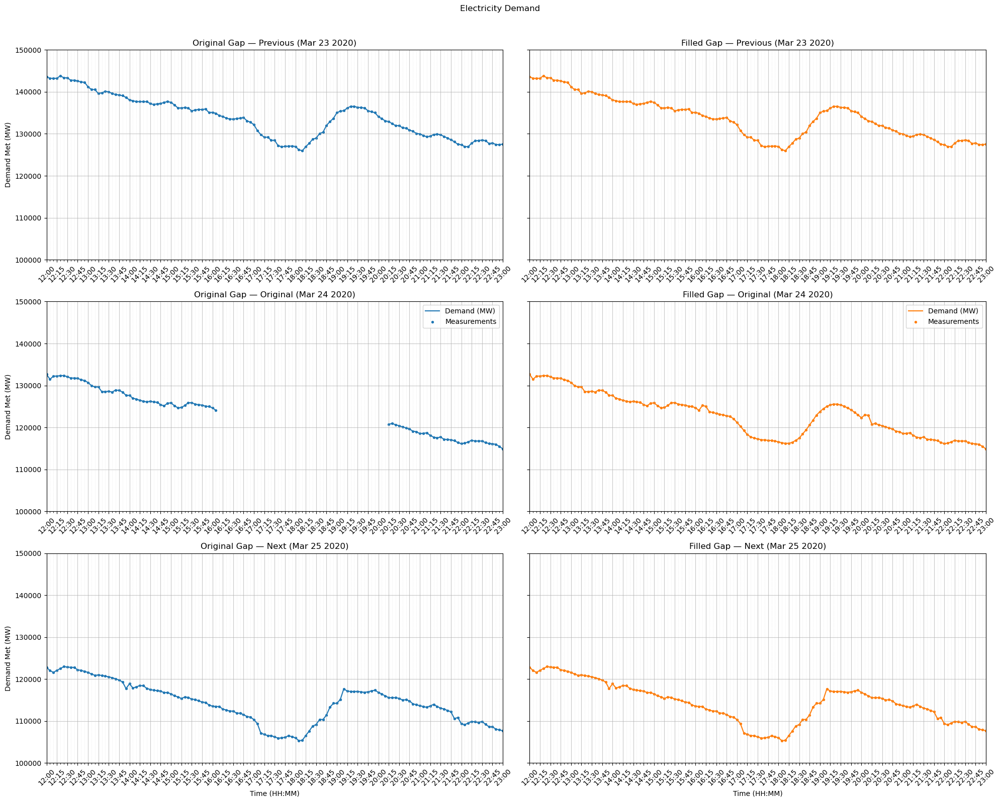

In [129]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_combined,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_1,
    end_boundary=end_boundary_1,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_1,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


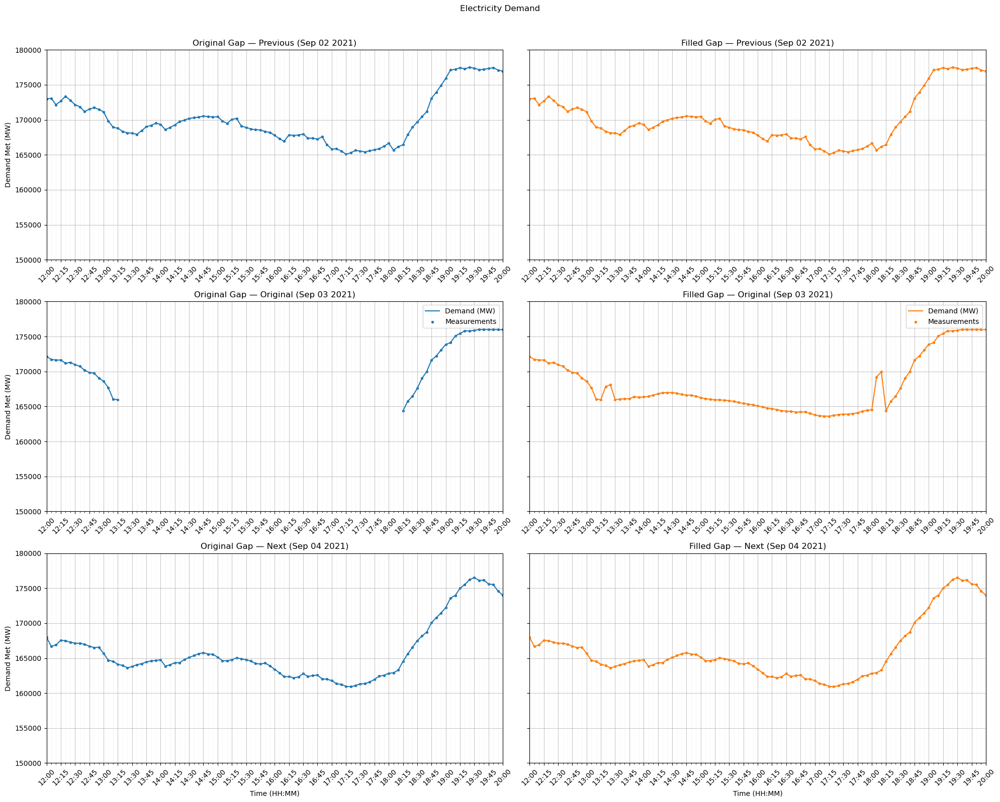

In [130]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_combined,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_2,
    end_boundary=end_boundary_2,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_2,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


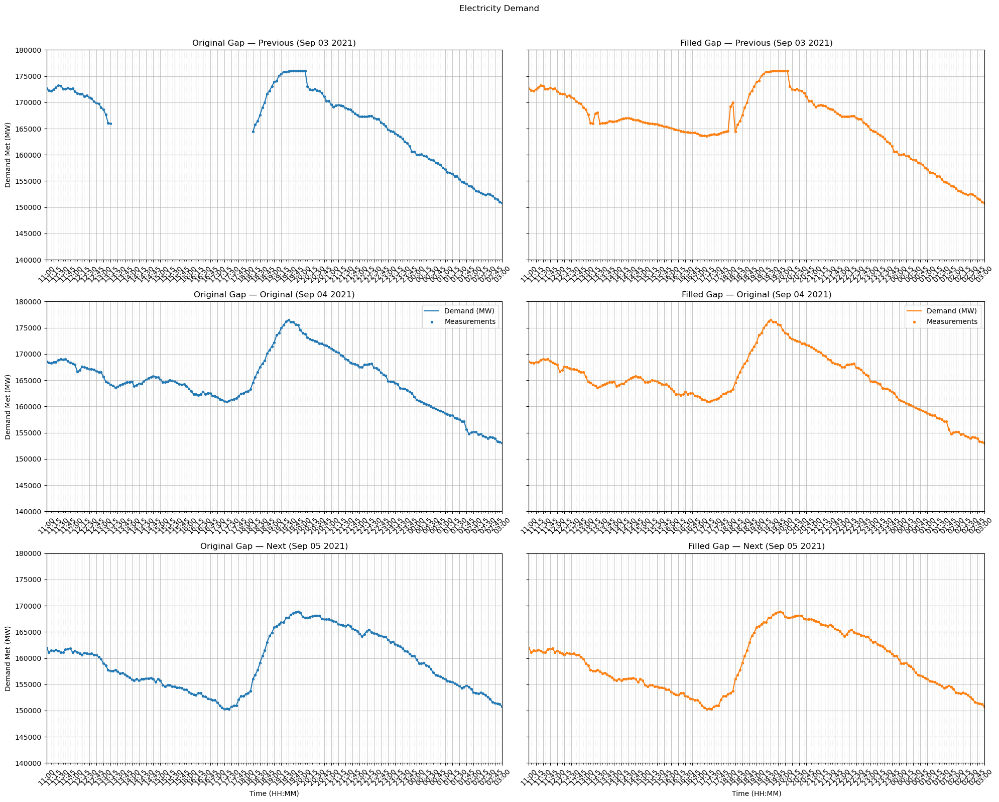

In [131]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_combined,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=ylim_3,
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

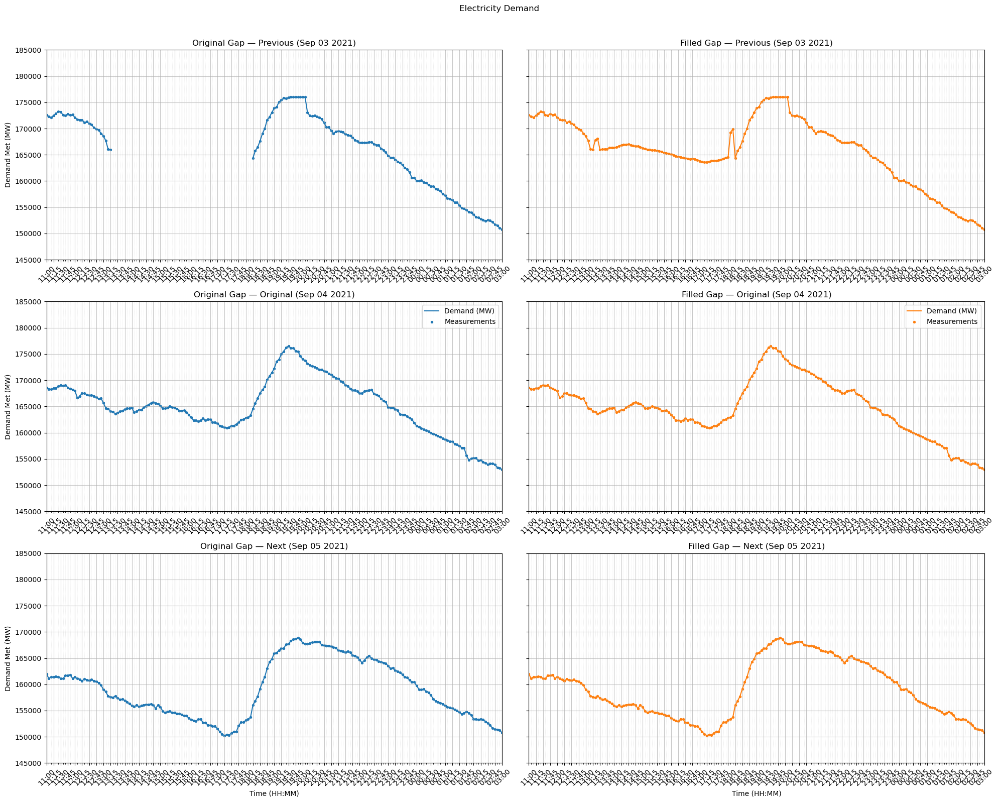

In [132]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_combined,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(145000, 185000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1910

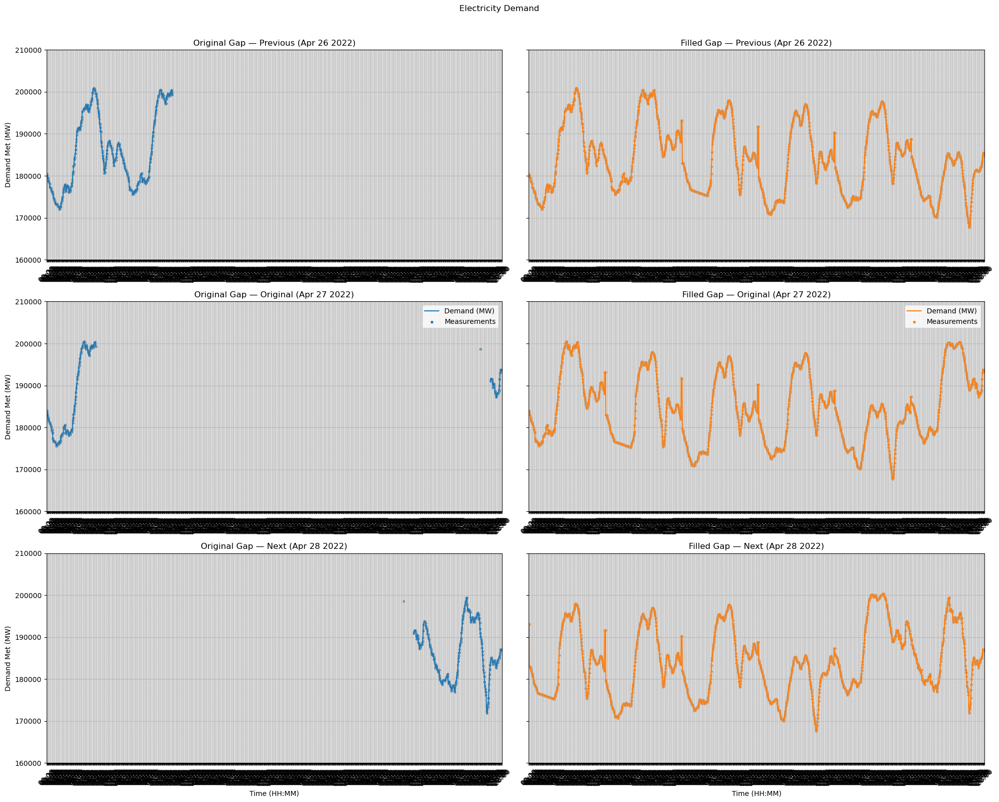

In [133]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_combined,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_6,
    end_boundary=end_boundary_6,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(160000, 210000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

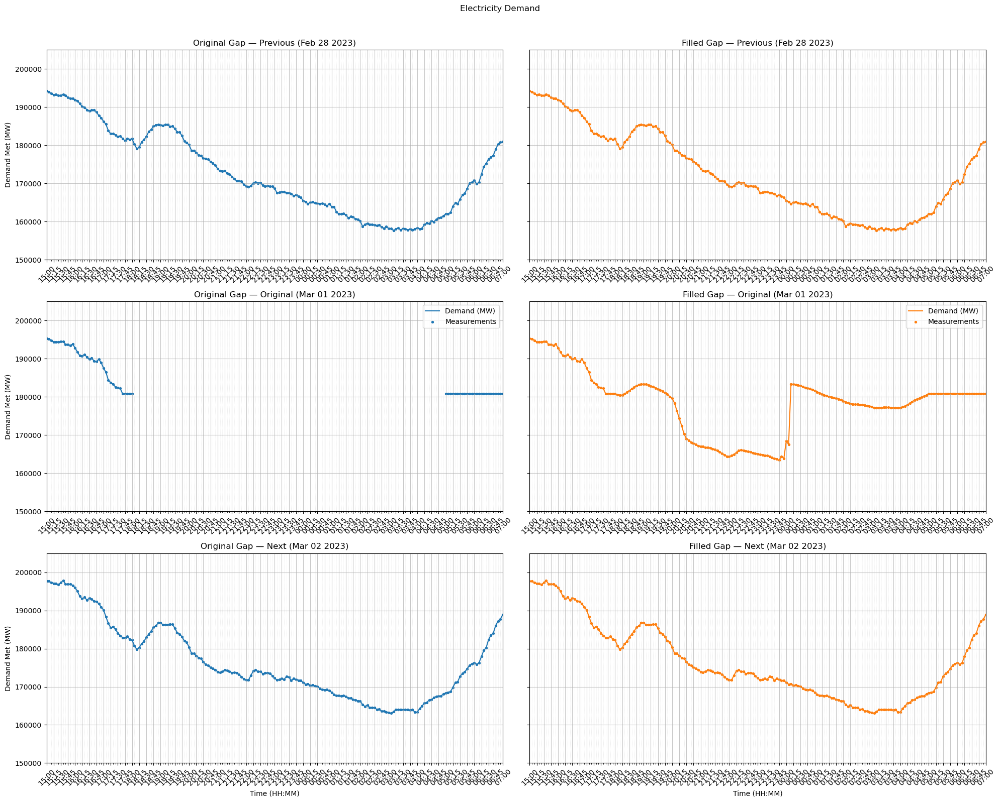

In [134]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_combined,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_8,
    end_boundary=end_boundary_8,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(150000, 205000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

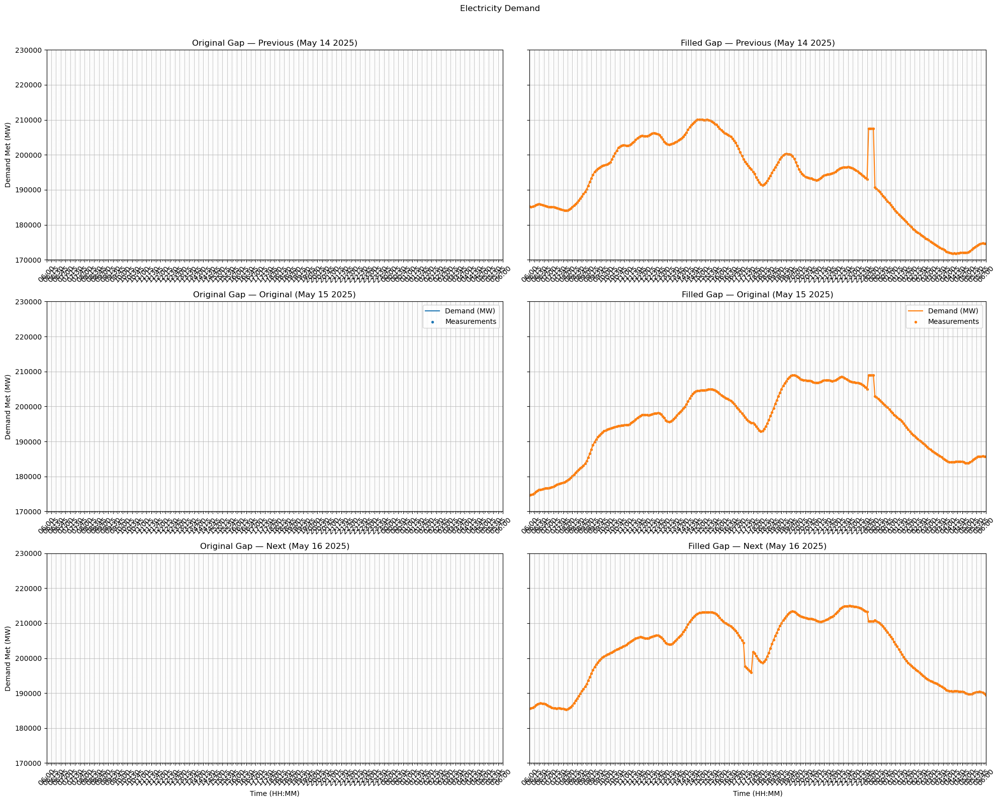

In [135]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_combined,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_10,
    end_boundary=end_boundary_10,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(170000, 230000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

##### Offset Filling

In [136]:
gaps_before = find_null_runs(full_time_join_grid_data_step1, ref_col="demand_met")
n_null_before = count_null_rows(full_time_join_grid_data_step1, "demand_met")

In [137]:
print(f"\nRows null before (demand_met): {n_null_before:,}")
print("Short preview of gaps before:")
print(gaps_before.head(10).to_pandas().to_string(index=False))


Rows null before (demand_met): 7,552
Short preview of gaps before:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2020-03-24 16:10:00 2020-03-24 20:10:00         49            2020                3
2020-07-14 03:40:00 2020-07-14 08:10:00         55            2020                7
2021-04-04 00:40:00 2021-04-04 02:00:00         17            2021                4
2021-09-03 13:20:00 2021-09-03 18:10:00         59            2021                9
2021-09-12 10:20:00 2021-09-12 12:30:00         27            2021                9
2021-09-27 16:05:00 2021-09-27 17:25:00         17            2021                9
2021-10-06 10:05:00 2021-10-06 12:05:00         25            2021               10
2022-01-04 10:50:00 2022-01-04 12:20:00         19            2022                1
2022-01-11 05:45:00 2022-01-11 07:45:00         25            2022                1
2022-01-12 12:15:00 2022-01-12 14:05:00         23            2022                1


In [138]:
phys_cols = [
    "thermal_generation","gas_generation","hydro_generation","nuclear_generation",
    "renewable_generation","tons_co2","total_generation","demand_met","net_demand"
]
full_time_join_grid_data_step2_offset_100, audit_offset_100 = fill_long_gaps_weekpair_offset(
    df=full_time_join_grid_data_step1,
    ref_col="demand_met",
    fill_cols=phys_cols,
    step_minutes=5,
    max_search_days=30,
    max_week_shifts=8,
    min_gap_minutes=80,
    slot_tolerance=1,
    donor_coverage=1.0,
    min_pairs=1.0,
    edge_hours=3.0,
    use_median=True,
    fallback_local=False,
)

In [139]:
full_time_join_grid_data_step1.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0,562976.0
"""null_count""","""0""",7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0,7552.0
"""mean""","""2022-09-17 11:57:30""",127199.019975,3886.187208,734.053673,17814.696644,5096.030567,17972.861623,10474.292442,171968.796016,0.734054,170764.609036,153995.934393
"""std""",null,20946.222099,1625.291463,76.561261,8654.356929,788.518343,14589.119685,1692.219892,26447.082876,0.076561,26149.51554,22130.380918
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111733.5,2562.5,681.12483,10083.5,4444.0,6697.0,9220.1858,153312.0,0.681125,152278.5,138367.5
"""50%""","""2022-09-17 12:00:00""",128429.5,3461.0,734.381423,16951.0,5125.0,12785.0,10550.7235,172328.0,0.734381,170950.0,153930.0
"""75%""","""2024-01-25 17:55:00""",143163.0,4935.0,797.276058,24889.5,5571.0,25141.5,11748.6734,192489.0,0.797276,190924.5,169373.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [140]:
full_time_join_grid_data_step2_offset_100.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570498.0,570498.0,562976.0,570498.0,570498.0,570498.0,570498.0,570498.0,562976.0,570498.0,570498.0
"""null_count""","""0""",30.0,30.0,7552.0,30.0,30.0,30.0,30.0,30.0,7552.0,30.0,30.0
"""mean""","""2022-09-17 11:57:30""",127310.909587,3878.096393,734.053673,17810.651079,5099.186669,18045.761751,10483.054266,172140.864216,0.734054,170929.779173,154099.652046
"""std""",null,20921.61449,1620.298846,76.561261,8638.037313,789.428318,14644.423125,1690.34602,26417.078743,0.076561,26116.474404,22124.171795
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111880.0,2561.0,681.12483,10107.0,4443.0,6726.0,9230.1598,153509.5,0.681125,152474.0,138458.0
"""50%""","""2022-09-17 12:00:00""",128586.0,3452.0,734.381423,16951.0,5126.0,12844.0,10563.51765,172615.0,0.734381,171240.0,154047.0
"""75%""","""2024-01-25 17:55:00""",143272.0,4918.0,797.276058,24848.0,5582.0,25242.5,11758.75995,192619.0,0.797276,191036.0,169486.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [141]:
gaps_after = find_null_runs(full_time_join_grid_data_step2_offset_100, ref_col="demand_met")
n_null_after = count_null_rows(full_time_join_grid_data_step2_offset_100, "demand_met")

In [142]:
print(f"\nRows null after (demand_met): {n_null_after:,}")
print("Short preview of gaps after:")
print(gaps_after.sort("n_missing", descending=False).head(10).to_pandas().to_string(index=False))


Rows null after (demand_met): 30
Short preview of gaps after:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2022-12-30 23:35:00 2022-12-30 23:55:00          5            2022               12
2023-11-21 23:35:00 2023-11-21 23:55:00          5            2023               11
2022-07-30 23:20:00 2022-07-30 23:55:00          8            2022                7
2022-05-04 23:00:00 2022-05-04 23:55:00         12            2022                5


In [143]:
audit_offset_100.describe()

statistic,gap_date,slot_start,slot_end,donor_B,pairs_ref,filled_slots,n_cols_filled,method
str,str,f64,f64,str,f64,f64,f64,str
"""count""","""87""",87.0,87.0,"""83""",87.0,87.0,87.0,"""87"""
"""null_count""","""0""",0.0,0.0,"""4""",0.0,0.0,0.0,"""0"""
"""mean""","""2023-02-15 05:31:02.068000""",105.528736,191.333333,"""2023-02-24 07:13:44.096000""",5413.310345,86.45977,8.586207,null
"""std""",null,91.988983,85.705372,null,2319.765256,90.473278,1.895844,null
"""min""","""2020-03-24""",0.0,16.0,"""2020-03-31""",0.0,0.0,0.0,"""gap_too_short"""
"""25%""","""2022-03-25""",0.0,124.0,"""2022-03-31""",4458.0,26.0,9.0,null
"""50%""","""2022-07-31""",114.0,193.0,"""2022-08-07""",5067.0,55.0,9.0,null
"""75%""","""2024-04-06""",187.0,287.0,"""2024-07-04""",6331.0,96.0,9.0,null
"""max""","""2025-05-19""",283.0,287.0,"""2025-05-26""",12930.0,288.0,9.0,"""weekpair_offsets::run99"""


In [144]:
audit_offset_100.sample(10)

gap_date,slot_start,slot_end,donor_B,pairs_ref,filled_slots,n_cols_filled,method
date,i32,i32,date,i32,i32,i32,str
2022-03-10,183,199,2022-03-17,3369,17,9,"""weekpair_offsets::run41"""
2024-06-28,235,251,2024-07-05,4420,17,9,"""weekpair_offsets::run107"""
2021-10-06,121,145,2021-10-13,4797,25,9,"""weekpair_offsets::run13"""
2024-12-22,179,223,2024-12-29,5511,45,9,"""weekpair_offsets::run113"""
2022-03-25,0,204,2022-04-01,8981,205,9,"""weekpair_offsets::run43"""
2022-02-06,115,190,2022-02-13,7092,76,9,"""weekpair_offsets::run31"""
2025-03-15,85,124,2025-03-22,5136,40,9,"""weekpair_offsets::run117"""
2022-03-09,16,82,2022-03-16,5650,67,9,"""weekpair_offsets::run39"""
2022-05-06,211,265,2022-05-13,3972,55,9,"""weekpair_offsets::run53"""


In [145]:
print(audit_offset_100.group_by("method")
      .agg([pl.len().alias("n_gaps"), pl.col("filled_slots").sum().alias("slots_filled")])
      .sort("n_gaps", descending=True))

# where the gaps are in time and how long:
print(audit_offset_100.select([
    pl.col("gap_date"),
    (pl.col("slot_end") - pl.col("slot_start") + 1).alias("gap_slots"),
    "method"
]).sort(["gap_date"], descending=[True]).head(20))

shape: (63, 3)
┌──────────────────────────┬────────┬──────────────┐
│ method                   ┆ n_gaps ┆ slots_filled │
│ ---                      ┆ ---    ┆ ---          │
│ str                      ┆ u32    ┆ i32          │
╞══════════════════════════╪════════╪══════════════╡
│ weekpair_offsets::run123 ┆ 10     ┆ 2567         │
│ weekpair_offsets::run45  ┆ 6      ┆ 1447         │
│ gap_too_short            ┆ 4      ┆ 0            │
│ weekpair_offsets::run87  ┆ 2      ┆ 191          │
│ weekpair_offsets::run65  ┆ 2      ┆ 85           │
│ …                        ┆ …      ┆ …            │
│ weekpair_offsets::run23  ┆ 1      ┆ 37           │
│ weekpair_offsets::run73  ┆ 1      ┆ 39           │
│ weekpair_offsets::run97  ┆ 1      ┆ 45           │
│ weekpair_offsets::run117 ┆ 1      ┆ 40           │
│ weekpair_offsets::run71  ┆ 1      ┆ 26           │
└──────────────────────────┴────────┴──────────────┘
shape: (20, 3)
┌────────────┬───────────┬──────────────────────────┐
│ gap_date   ┆ 

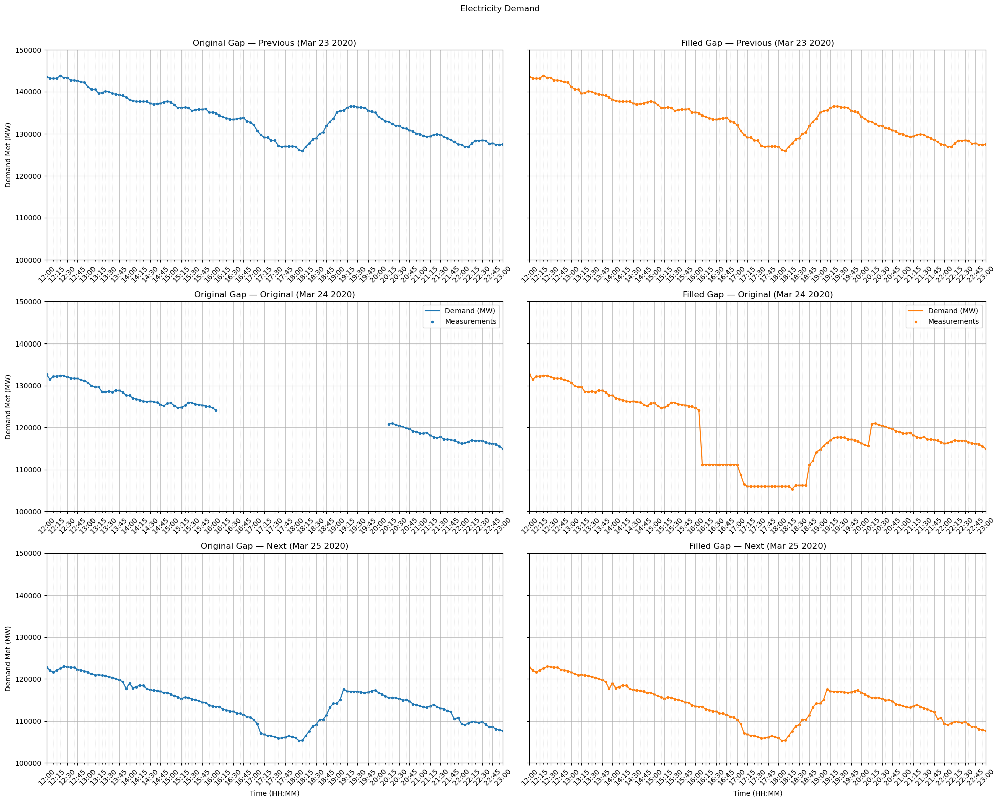

In [146]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_offset_100,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_1,
    end_boundary=end_boundary_1,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(100000, 150000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


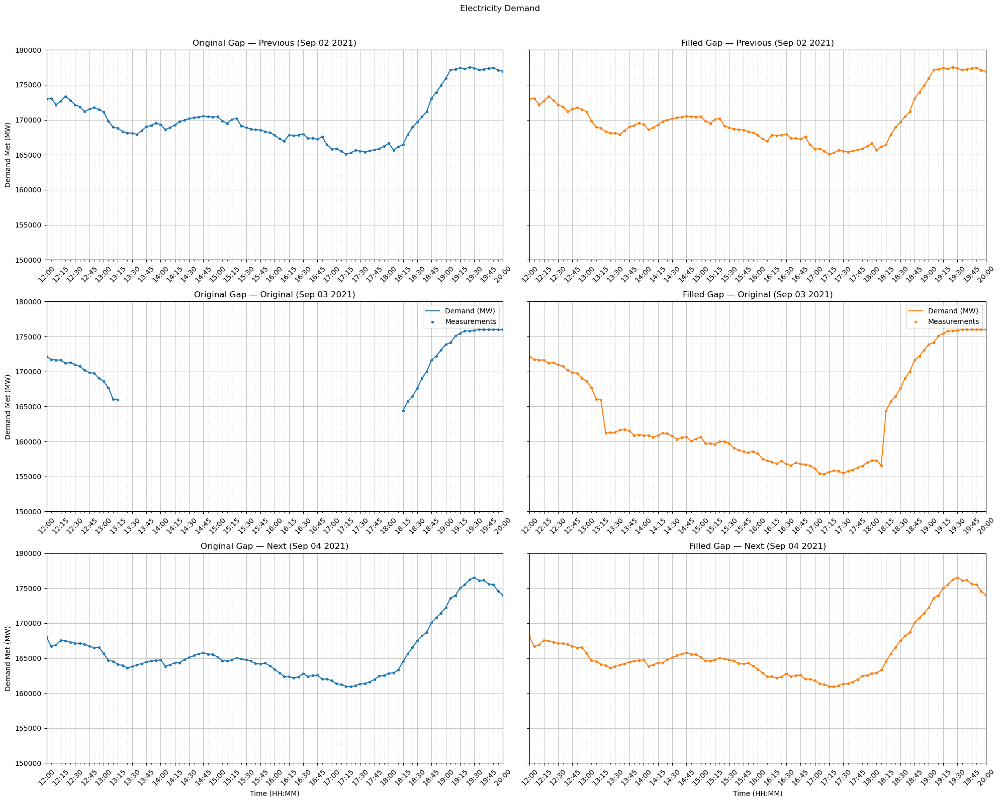

In [147]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_offset_100,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_2,
    end_boundary=end_boundary_2,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(150000, 180000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)


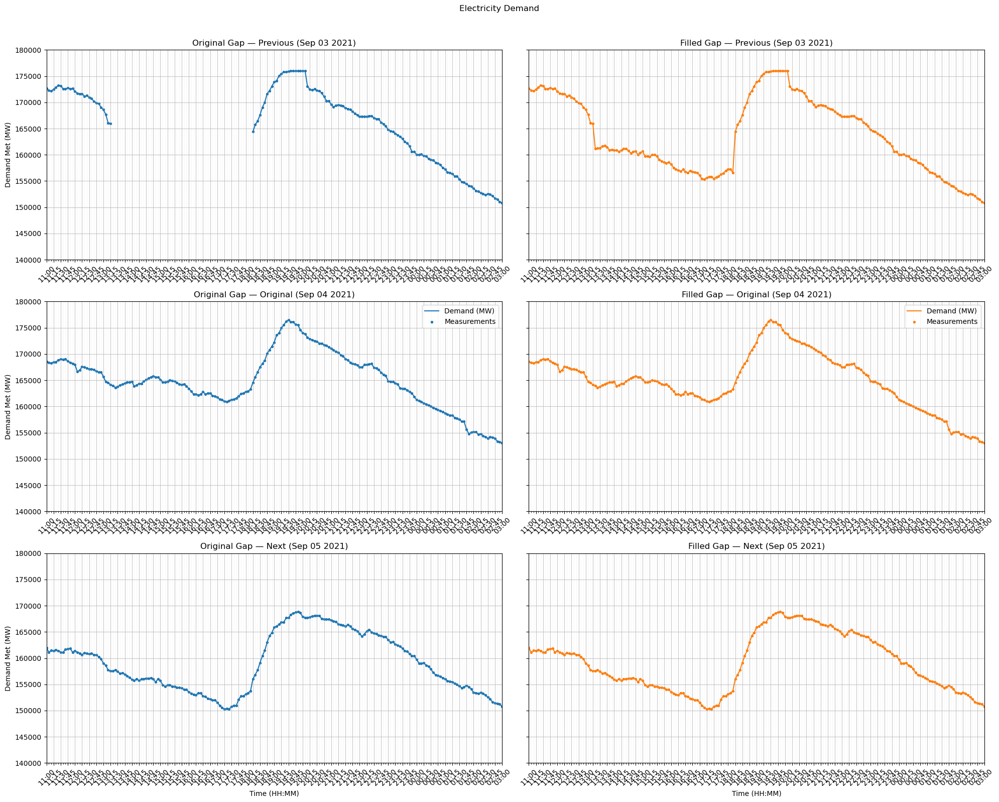

In [148]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_offset_100,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(140000, 180000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

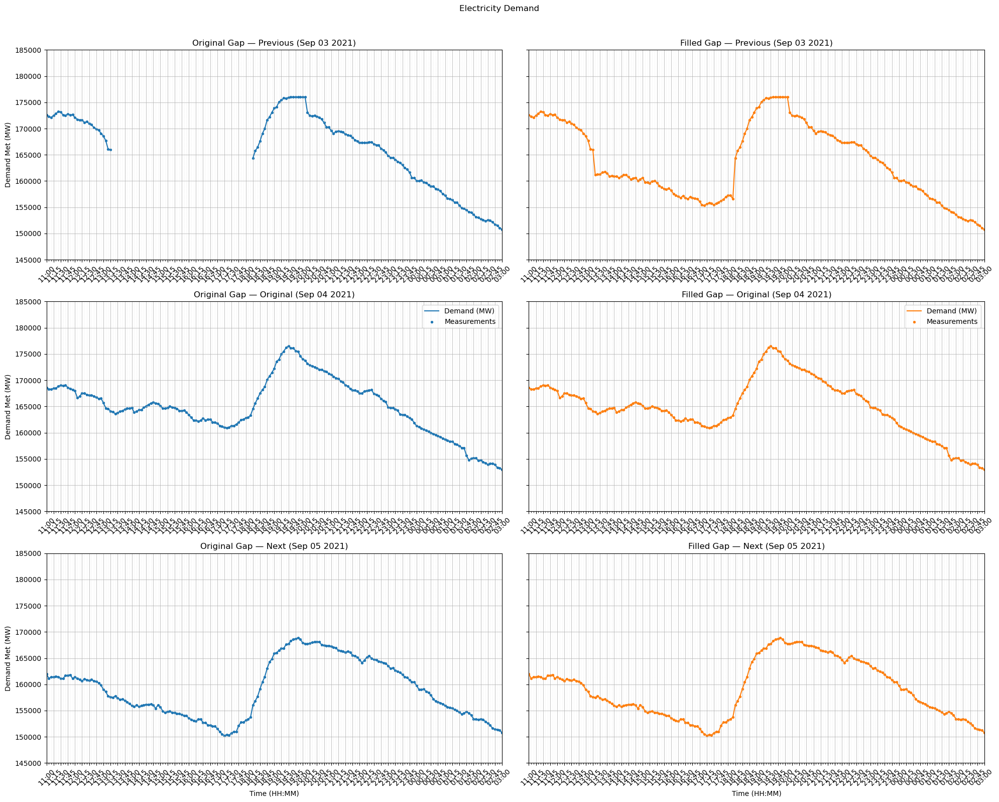

In [149]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_offset_100,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_3,
    end_boundary=end_boundary_3,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(145000, 185000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19110.0, ..., 19115.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1910

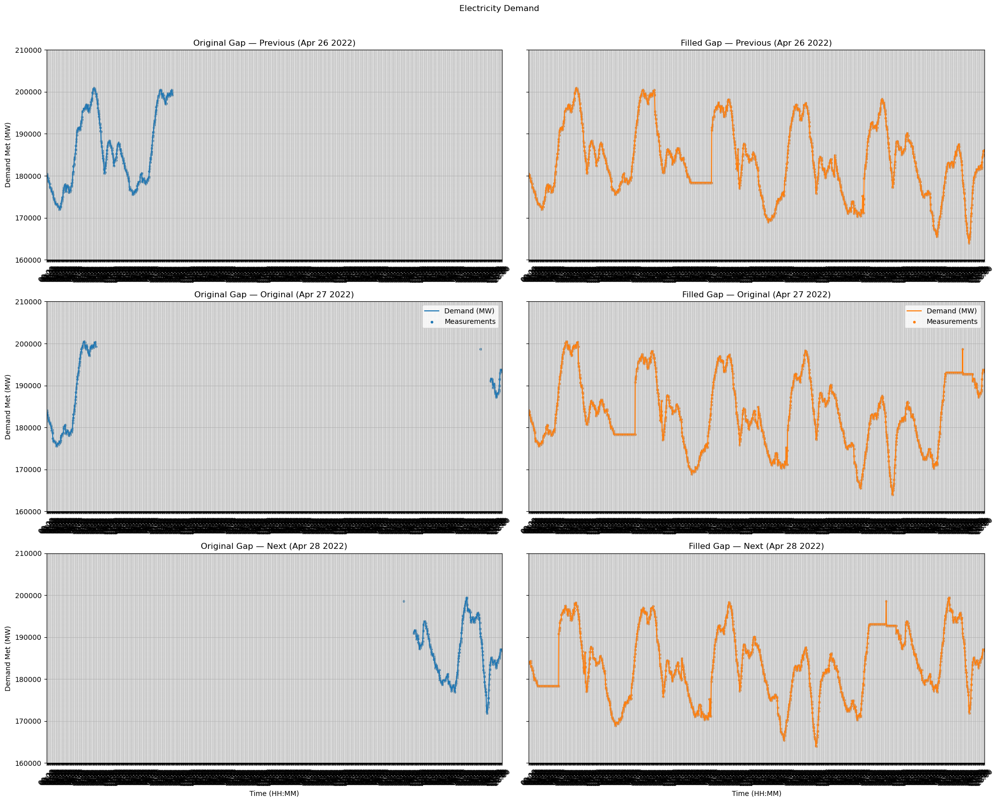

In [150]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_offset_100,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_6,
    end_boundary=end_boundary_6,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(160000, 210000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

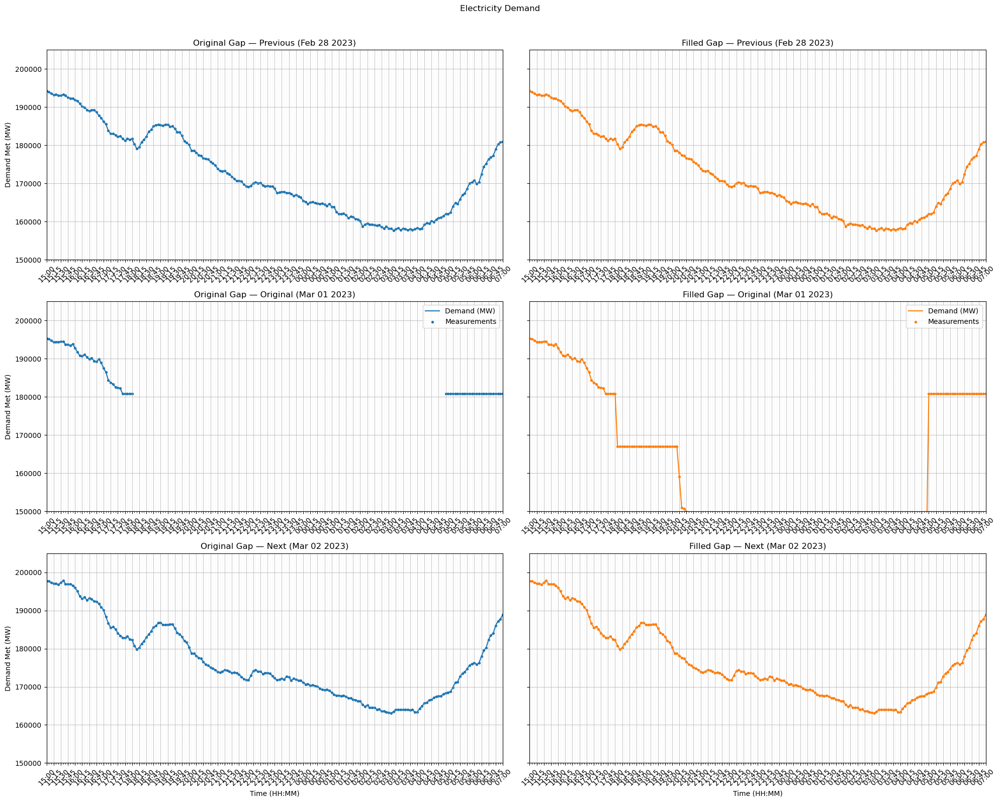

In [151]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_offset_100,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_8,
    end_boundary=end_boundary_8,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(150000, 205000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

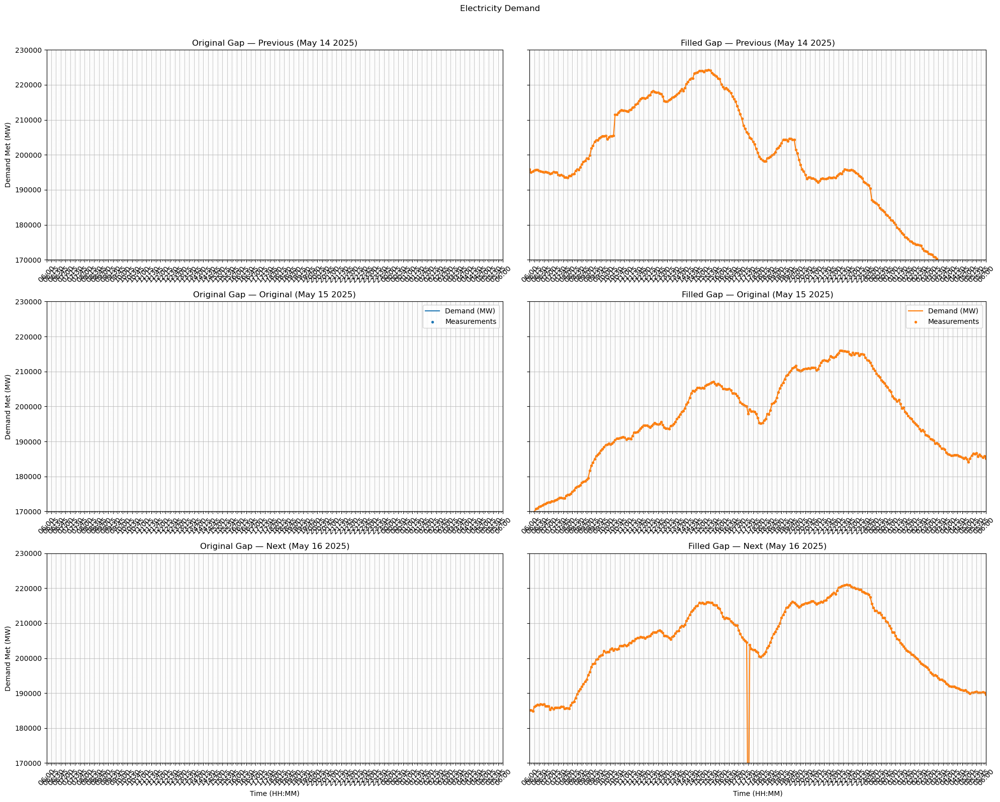

In [152]:
plot_time_series_compare_two_datasets_with_hour_offsets_grid(
    df_left=full_time_join_grid_data_step1,
    df_right=full_time_join_grid_data_step2_offset_100,
    timestamp_col="timestamp",
    plot_col_left="demand_met",
    plot_col_right="demand_met",
    start_boundary=start_boundary_10,
    end_boundary=end_boundary_10,
    offset_hours=24,
    col_titles=("Original Gap", "Filled Gap"),
    base_title="Electricity Demand",
    figsize=(20, 16),
    y_label="Demand Met (MW)",
    x_label="Time (HH:MM)",
    line_label="Demand (MW)",
    point_label="Measurements",
    line_color_left="C0",
    point_color_left="C0",
    line_color_right="C1",
    point_color_right="C1",
    ylim=(170000, 230000),
    point_size=8,
    sharey=True,
    align_ylim=True,   # ensures the same y-scale on all 6 plots
)

##### Comparison

In [153]:
dataframes_to_plot = [full_time_join_grid_data, full_time_join_grid_data_step1, full_time_join_grid_data_step2_scaling,
                      full_time_join_grid_data_step2_gradient_smooth_5, full_time_join_grid_data_step2_combined, full_time_join_grid_data_step2_offset_100]


start_boundaries = [ start_boundary_1, start_boundary_2, start_boundary_3,
                     start_boundary_4, start_boundary_5, start_boundary_6,
                     start_boundary_7, start_boundary_8, start_boundary_9, start_boundary_10]

end_boundaries = [ end_boundary_1, end_boundary_2, end_boundary_3,
                   end_boundary_4, end_boundary_5, end_boundary_6,
                   end_boundary_7, end_boundary_8, end_boundary_9, end_boundary_10]

ylimits = [ylim_1, ylim_2, ylim_3, ylim_4, ylim_5, ylim_6,
            ylim_7, ylim_8, ylim_9, ylim_10]

col_titles = ["Original", "Step1", "Scaling", "Gradient", "Combined", "Week-Pair Offset"]


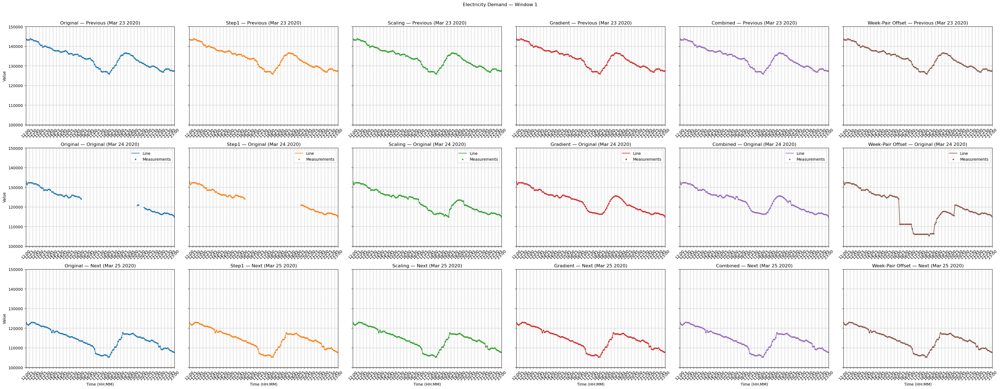

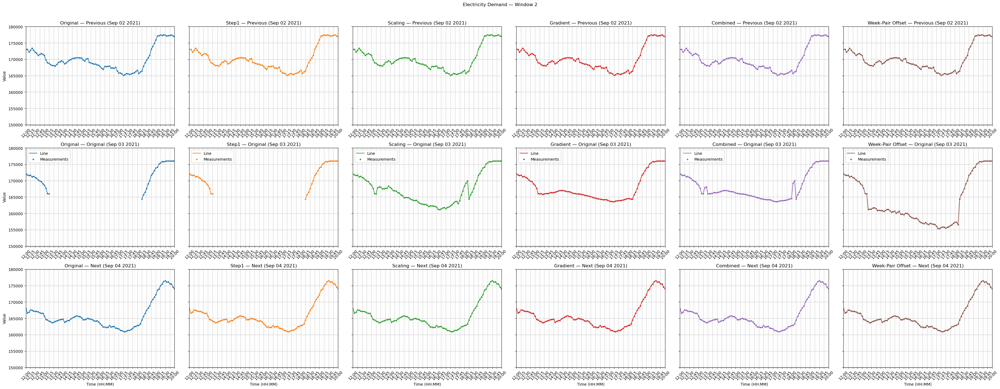

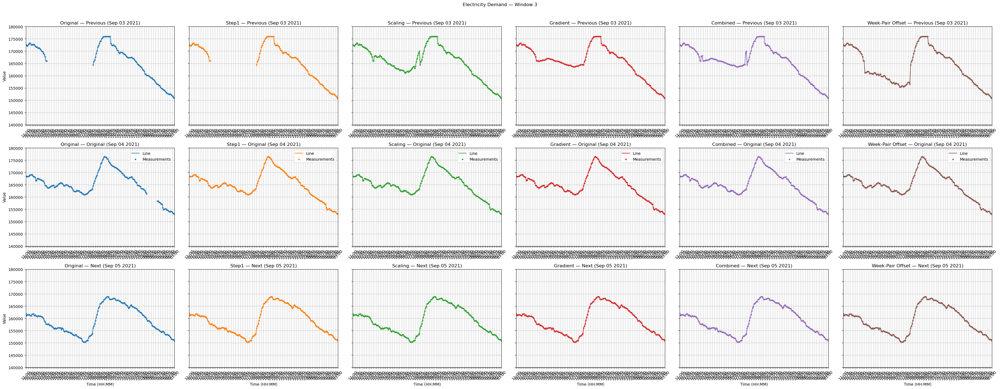

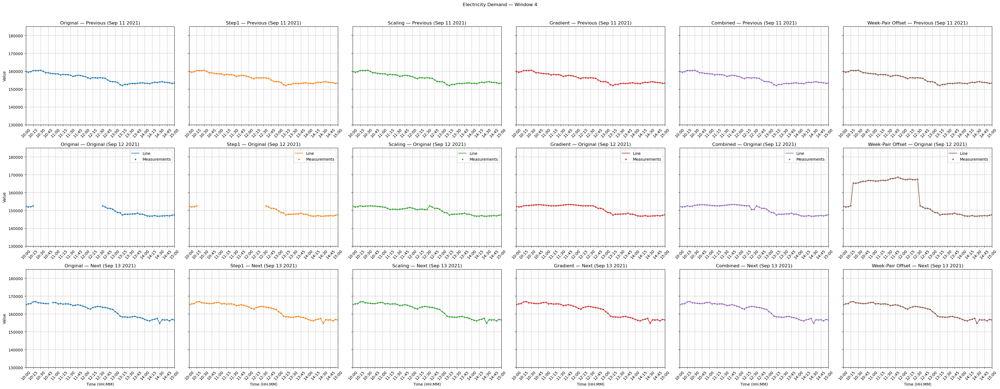

Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([1910

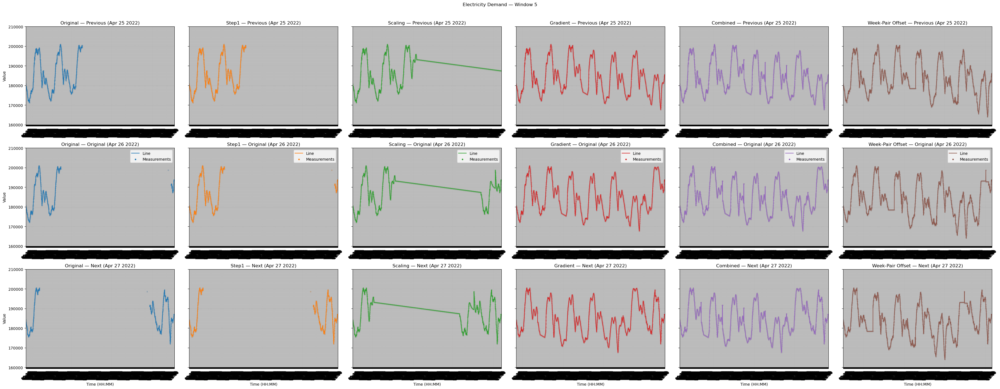

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1910

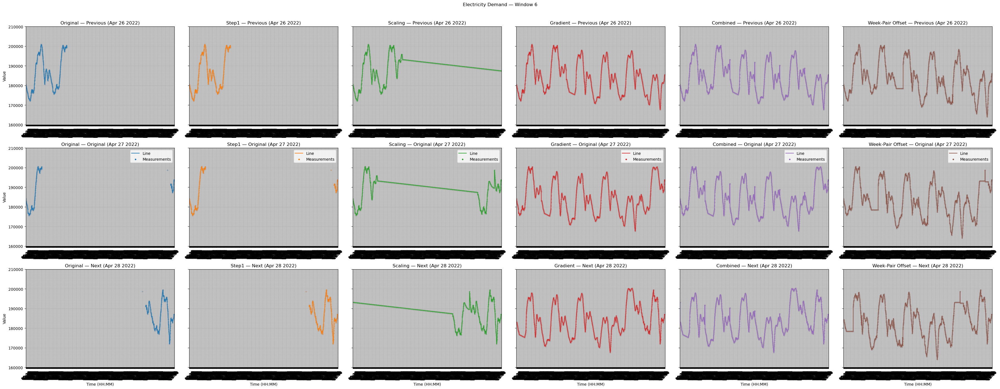

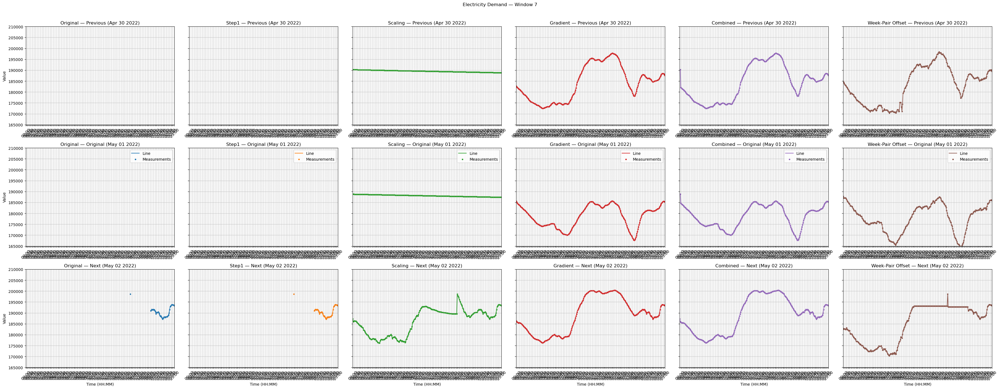

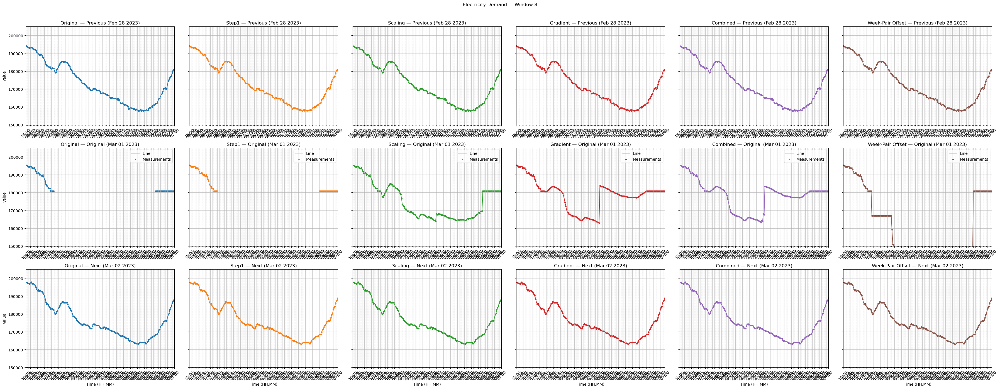

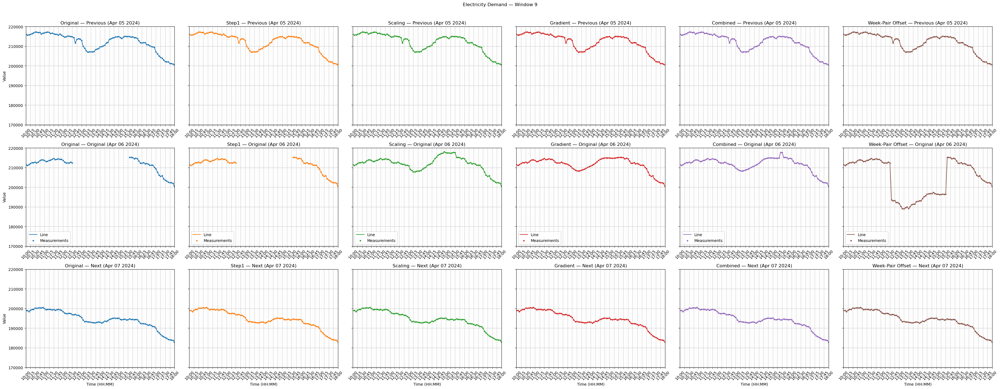

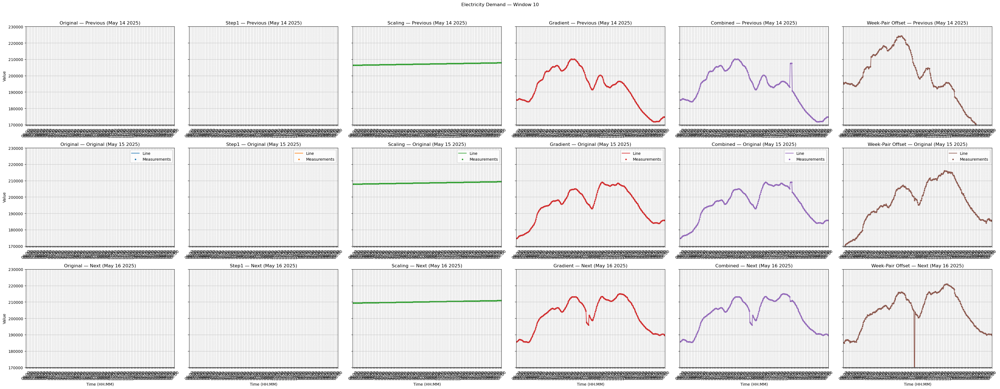

In [154]:
batch_plot_from_lists(
    dataframes_to_plot,
    start_boundaries,
    end_boundaries,
    ylimits,
    timestamp_col="timestamp",
    plot_col="demand_met",
    offset_hours=24,
    titles=col_titles,               # optional
    base_title_prefix="Electricity Demand — ",
    width_per_col=6,
    height=14,
    sharey=True,
    align_ylim=True,                 # ignored when a per-window ylim is provided
    point_size=8,
    save=False,                      # flip to True to write PNGs
    # save_dir="figs",               # set when save=True
)

##### Final Test - Comparing Gradients

In [155]:
full_time_join_grid_data_step2_gradient_smooth_5, audit_grad = fill_long_gaps_by_gradient(
    full_time_join_grid_data_step1,
    ref_col="demand_met",
    fill_cols=None,
    step_minutes=5,
    max_search_days=21,
    smooth_window_slots=5,
    prefer_same_weekday=True,
    slot_tolerance=-0,
)

nonneg_cols = [
    "thermal_generation","gas_generation","hydro_generation","nuclear_generation",
    "renewable_generation","tons_co2","total_generation","demand_met","net_demand"
]

full_time_join_grid_data_step2_gradient_smooth_5 = clamp_nonneg(full_time_join_grid_data_step2_gradient_smooth_5, nonneg_cols)

full_time_join_grid_data_step2_gradient_smooth_5 = recompute_intensities_from_rates(full_time_join_grid_data_step2_gradient_smooth_5,
                                                                                    clamp_to_existing=True,
                                                                                    q_low=0.001,
                                                                                    q_high=0.999,
                                                                                    pad=0.05)

In [156]:
full_time_join_grid_data_step2_gradient_smooth_8, audit_grad = fill_long_gaps_by_gradient(
    full_time_join_grid_data_step1,
    ref_col="demand_met",
    fill_cols=None,
    step_minutes=5,
    max_search_days=21,
    smooth_window_slots=8,
    prefer_same_weekday=True,
    slot_tolerance=-0,
)

nonneg_cols = [
    "thermal_generation","gas_generation","hydro_generation","nuclear_generation",
    "renewable_generation","tons_co2","total_generation","demand_met","net_demand"
]

full_time_join_grid_data_step2_gradient_smooth_8 = clamp_nonneg(full_time_join_grid_data_step2_gradient_smooth_8, nonneg_cols)

full_time_join_grid_data_step2_gradient_smooth_8 = recompute_intensities_from_rates(full_time_join_grid_data_step2_gradient_smooth_8,
                                                                                    clamp_to_existing=True,
                                                                                    q_low=0.001,
                                                                                    q_high=0.999,
                                                                                    pad=0.05)

In [157]:
full_time_join_grid_data_step2_gradient_smooth_3, audit_grad = fill_long_gaps_by_gradient(
    full_time_join_grid_data_step1,
    ref_col="demand_met",
    fill_cols=None,
    step_minutes=5,
    max_search_days=21,
    smooth_window_slots=3,
    prefer_same_weekday=True,
    slot_tolerance=-0,
)

nonneg_cols = [
    "thermal_generation","gas_generation","hydro_generation","nuclear_generation",
    "renewable_generation","tons_co2","total_generation","demand_met","net_demand"
]

full_time_join_grid_data_step2_gradient_smooth_3 = clamp_nonneg(full_time_join_grid_data_step2_gradient_smooth_3, nonneg_cols)

full_time_join_grid_data_step2_gradient_smooth_3 = recompute_intensities_from_rates(full_time_join_grid_data_step2_gradient_smooth_3,
                                                                                    clamp_to_existing=True,
                                                                                    q_low=0.001,
                                                                                    q_high=0.999,
                                                                                    pad=0.05)

In [158]:
full_time_join_grid_data_step2_gradient_smooth_1, audit_grad = fill_long_gaps_by_gradient(
    full_time_join_grid_data_step1,
    ref_col="demand_met",
    fill_cols=None,
    step_minutes=5,
    max_search_days=21,
    smooth_window_slots=1,
    prefer_same_weekday=True,
    slot_tolerance=-0,
)

nonneg_cols = [
    "thermal_generation","gas_generation","hydro_generation","nuclear_generation",
    "renewable_generation","tons_co2","total_generation","demand_met","net_demand"
]

full_time_join_grid_data_step2_gradient_smooth_1 = clamp_nonneg(full_time_join_grid_data_step2_gradient_smooth_1, nonneg_cols)

full_time_join_grid_data_step2_gradient_smooth_1 = recompute_intensities_from_rates(full_time_join_grid_data_step2_gradient_smooth_1,
                                                                                    clamp_to_existing=True,
                                                                                    q_low=0.001,
                                                                                    q_high=0.999,
                                                                                    pad=0.05)

/var/folders/lg/rt7jvg4x71vd57p0zm_718200000gn/T/ipykernel_33903/3318353707.py:43: RuntimeWarning: Mean of empty slice
  m = np.nanmean(arr, axis=0)
/var/folders/lg/rt7jvg4x71vd57p0zm_718200000gn/T/ipykernel_33903/3318353707.py:43: RuntimeWarning: Mean of empty slice
  m = np.nanmean(arr, axis=0)
/var/folders/lg/rt7jvg4x71vd57p0zm_718200000gn/T/ipykernel_33903/3318353707.py:43: RuntimeWarning: Mean of empty slice
  m = np.nanmean(arr, axis=0)
/var/folders/lg/rt7jvg4x71vd57p0zm_718200000gn/T/ipykernel_33903/3318353707.py:43: RuntimeWarning: Mean of empty slice
  m = np.nanmean(arr, axis=0)
/var/folders/lg/rt7jvg4x71vd57p0zm_718200000gn/T/ipykernel_33903/3318353707.py:43: RuntimeWarning: Mean of empty slice
  m = np.nanmean(arr, axis=0)
/var/folders/lg/rt7jvg4x71vd57p0zm_718200000gn/T/ipykernel_33903/3318353707.py:43: RuntimeWarning: Mean of empty slice
  m = np.nanmean(arr, axis=0)
/var/folders/lg/rt7jvg4x71vd57p0zm_718200000gn/T/ipykernel_33903/3318353707.py:43: RuntimeWarning: Mean of

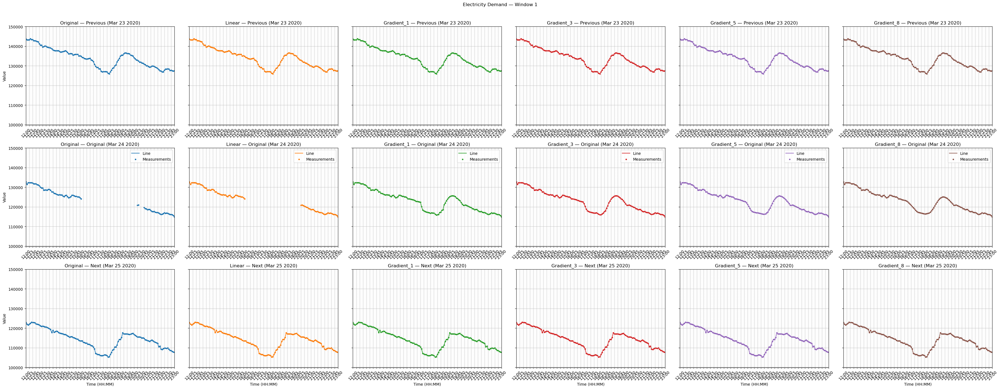

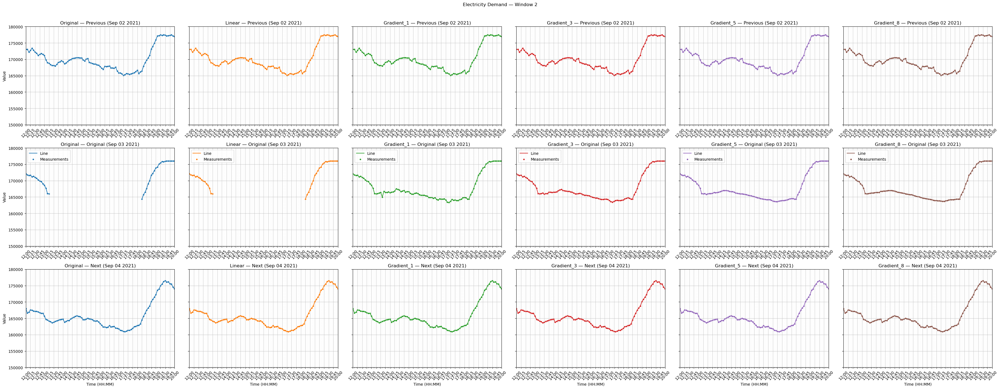

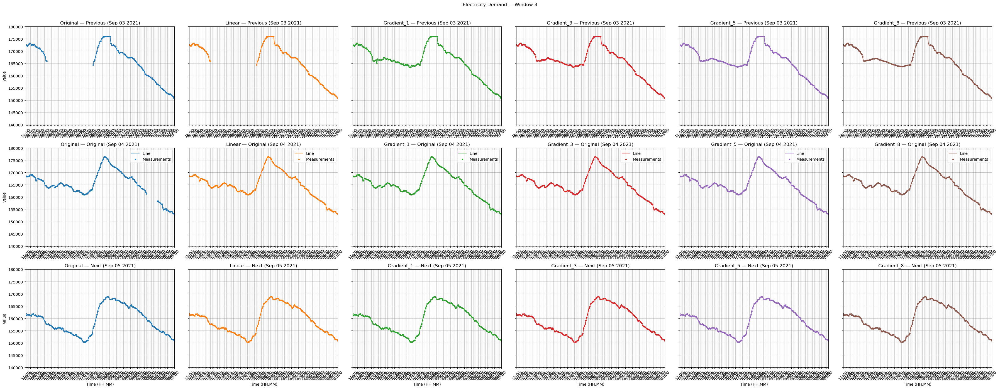

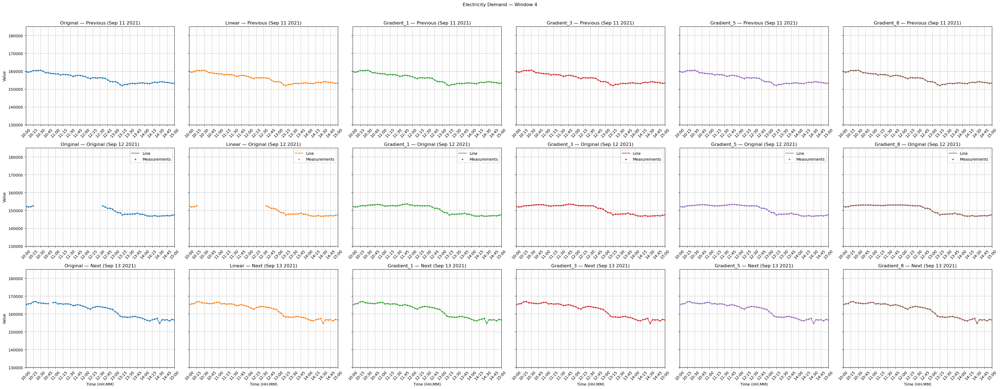

Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([1910

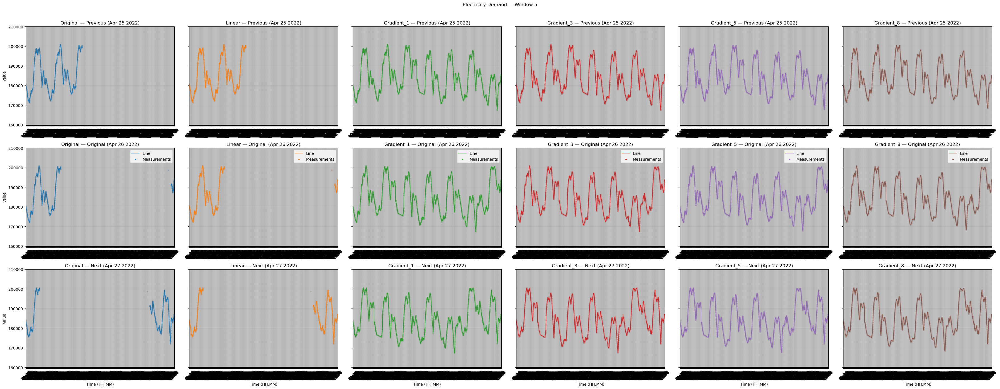

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1910

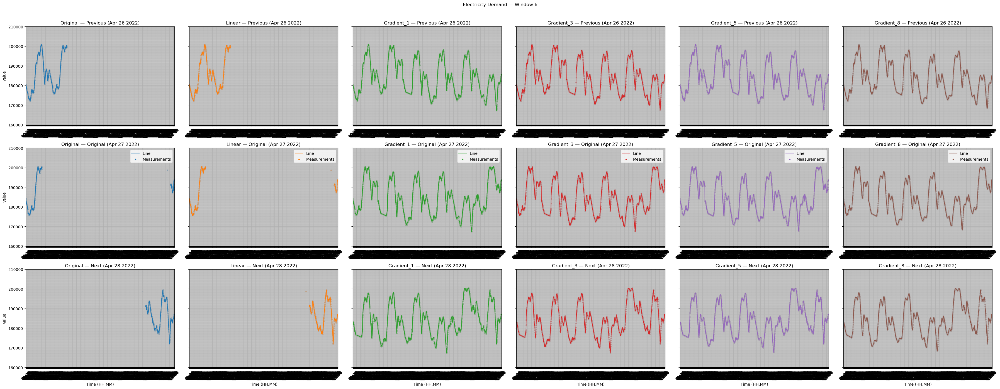

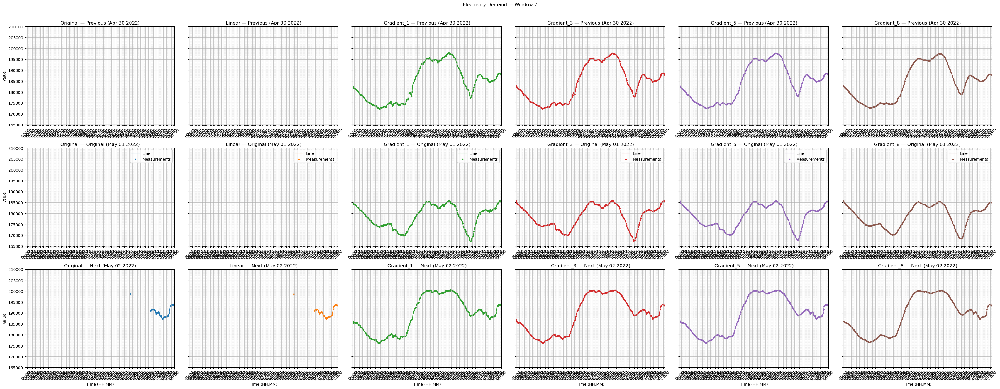

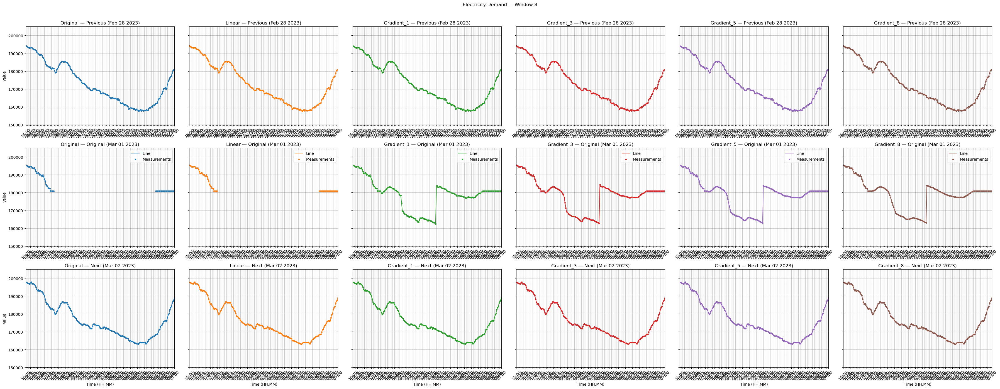

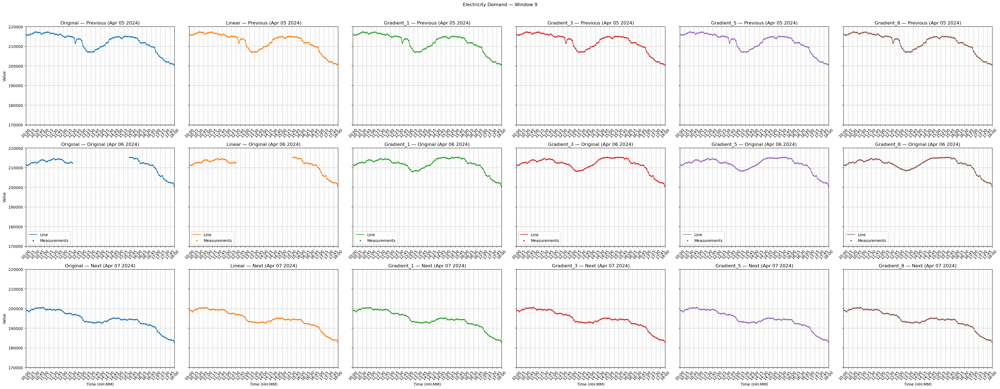

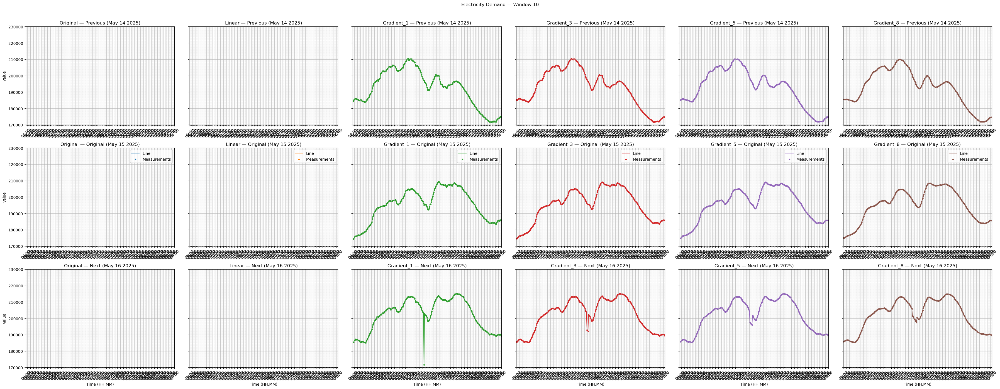

In [159]:
dataframes_to_plot = [full_time_join_grid_data, full_time_join_grid_data_step1, full_time_join_grid_data_step2_gradient_smooth_1,
                      full_time_join_grid_data_step2_gradient_smooth_3, full_time_join_grid_data_step2_gradient_smooth_5, full_time_join_grid_data_step2_gradient_smooth_8]


start_boundaries = [ start_boundary_1, start_boundary_2, start_boundary_3,
                     start_boundary_4, start_boundary_5, start_boundary_6,
                     start_boundary_7, start_boundary_8, start_boundary_9, start_boundary_10]

end_boundaries = [ end_boundary_1, end_boundary_2, end_boundary_3,
                   end_boundary_4, end_boundary_5, end_boundary_6,
                   end_boundary_7, end_boundary_8, end_boundary_9, end_boundary_10]

ylimits = [ylim_1, ylim_2, ylim_3, ylim_4, ylim_5, ylim_6,
            ylim_7, ylim_8, ylim_9, ylim_10]

col_titles = ["Original", "Linear", "Gradient_1", "Gradient_3", "Gradient_5", "Gradient_8",]

batch_plot_from_lists(
    dataframes_to_plot,
    start_boundaries,
    end_boundaries,
    ylimits,
    timestamp_col="timestamp",
    plot_col="demand_met",
    offset_hours=24,
    titles=col_titles,               # optional
    base_title_prefix="Electricity Demand — ",
    width_per_col=6,
    height=14,
    sharey=True,
    align_ylim=True,                 # ignored when a per-window ylim is provided
    point_size=8,
    save=False,                      # flip to True to write PNGs
    # save_dir="figs",               # set when save=True
)

### Implementing Gap Filling

Based on the above tests - it appears that gradient gap filling, perhaps followed by a nother linear gap filling would be the best option for handling missing data in this dataset.

We'll implement that now.

#### Reminder of Time Grid and Joining

In [160]:
# The dataset we have has 561,067 rows
data_start_date = datetime(2020, 1,1,0,0)
data_end_date = datetime(2025,6,3,23,55)
data_frequency = timedelta(minutes=5)

grid_readings_full_time_grid = pl.DataFrame({
    "timestamp": pl.datetime_range(
        start=data_start_date, end=data_end_date,
        interval=data_frequency,  # or "5m"
        closed="both", eager=True, time_unit="us"
    )
})

print(f"Count of rows in [grid_readings_pldf]:\t\t\t{grid_readings_pldf.shape[0]:,}")
print(f"Count of rows in [grid_readings_full_time_grid]:\t{grid_readings_full_time_grid.shape[0]:,}")
print(f"Number of missing observations:\t\t\t\t{grid_readings_full_time_grid.shape[0] - grid_readings_pldf.shape[0]:,}")
print(f"Percentage of rows in [grid_readings_pldf]that are present in [grid_readings_full_time_grid]:   {grid_readings_pldf.shape[0] / grid_readings_full_time_grid.shape[0] * 100:.2f}%")

Count of rows in [grid_readings_pldf]:			561,067
Count of rows in [grid_readings_full_time_grid]:	570,528
Number of missing observations:				9,461
Percentage of rows in [grid_readings_pldf]that are present in [grid_readings_full_time_grid]:   98.34%


In [161]:
missing_grid_time_data = (grid_readings_full_time_grid.join(other=grid_readings_pldf.select("timestamp").unique(),
                            on="timestamp",
                            how="anti"
                        ).sort("timestamp")
)
missing_grid_time_data.sample(5)

timestamp
datetime[μs]
2022-07-31 04:35:00
2023-01-18 13:15:00
2022-04-28 15:20:00
2022-03-07 08:15:00
2023-11-22 04:05:00


In [162]:
# We'll now get the time ranges of data that is missing
missing_grid_time_ranges = (
    missing_grid_time_data
    .with_columns(
        is_break = (pl.col("timestamp").diff() != timedelta(minutes=5)).fill_null(True)
    )
    .with_columns(
        block_id = pl.col("is_break").cum_sum()
    )
    .group_by("block_id")
    .agg([
        pl.col("timestamp").min().alias("missing_start"),
        pl.col("timestamp").max().alias("missing_end"),
        pl.len().alias("n_missing"),
    ])
    .drop("block_id")
    .sort("missing_start")
).with_columns(
        pl.col("missing_start").dt.year().alias("gap_start_year"),
        pl.col("missing_start").dt.month().alias("gap_start_month"),
)

missing_grid_time_ranges.sample(5)

missing_start,missing_end,n_missing,gap_start_year,gap_start_month
datetime[μs],datetime[μs],u32,i32,i8
2024-07-27 15:15:00,2024-07-27 16:25:00,15,2024,7
2021-05-24 07:55:00,2021-05-24 07:55:00,1,2021,5
2023-01-18 22:00:00,2023-01-18 22:10:00,3,2023,1
2023-01-19 11:20:00,2023-01-19 11:20:00,1,2023,1
2024-01-06 17:05:00,2024-01-06 17:05:00,1,2024,1


In [163]:
stats = prepare_missing_gap_stats(missing_grid_time_ranges, step_minutes=5)

print(stats["summary"].to_pandas().to_string(index=False))
display(stats["by_year"].to_pandas().head())
display(stats["by_year_month"].to_pandas().head())
display(stats["top_gaps"].to_pandas())

 n_gap_periods  rows_missing  hours_missing  days_missing  avg_gap_minutes  median_gap_minutes  max_gap_minutes
           984          9461     788.416667     32.850694        48.074187                 5.0          12835.0


,gap_start_year,n_gap_periods,rows_missing,hours_missing,days_missing,avg_gap_minutes,median_gap_minutes,max_gap_minutes
0,2020,38,162,13.500000,0.562500,21.315789,5.0,275.0
1,2021,171,399,33.250000,1.385417,11.666667,5.0,295.0
2,2022,339,4224,352.000000,14.666667,62.300885,5.0,7235.0
3,2023,215,1057,88.083333,3.670139,24.581395,5.0,955.0
4,2024,153,767,63.916667,2.663194,25.065359,5.0,1285.0


,year_month,n_gap_periods,rows_missing,hours_missing,avg_gap_minutes,median_gap_minutes
0,2020-01,3,9,0.750000,15.000000,15.0
1,2020-02,3,3,0.250000,5.000000,5.0
2,2020-03,8,64,5.333333,40.000000,10.0
3,2020-04,12,16,1.333333,6.666667,5.0
4,2020-06,2,5,0.416667,12.500000,12.5


,missing_start,missing_end,n_missing,gap_minutes,gap_hours,gap_days
0,2025-05-10 17:10:00,2025-05-19 15:00:00,2567,12835.0,213.916667,8.913194
1,2022-04-27 15:35:00,2022-05-02 16:05:00,1447,7235.0,120.583333,5.024306
2,2022-03-24 11:30:00,2022-03-25 17:00:00,355,1775.0,29.583333,1.232639
3,2024-12-21 17:05:00,2024-12-22 14:25:00,257,1285.0,21.416667,0.892361
4,2023-02-26 14:15:00,2023-02-27 06:05:00,191,955.0,15.916667,0.663194
5,2023-06-07 19:25:00,2023-06-08 07:55:00,151,755.0,12.583333,0.524306
6,2023-03-01 18:05:00,2023-03-02 04:55:00,131,655.0,10.916667,0.454861
7,2022-05-04 23:00:00,2022-05-05 08:05:00,110,550.0,9.166667,0.381944
8,2022-07-05 17:35:00,2022-07-06 02:15:00,105,525.0,8.750000,0.364583
9,2022-06-03 11:00:00,2022-06-03 19:25:00,102,510.0,8.500000,0.354167


#### Joining to Full time Grid

In [164]:
full_time_join_grid_data_step_1 = (
    grid_readings_full_time_grid
    .join(grid_readings_pldf, on="timestamp", how="left")
)

In [165]:
gaps_step_1 = find_null_runs(full_time_join_grid_data_step_1, ref_col="demand_met")
n_null_step_1 = count_null_rows(full_time_join_grid_data_step_1, "demand_met")


In [166]:
print(f"Rows (total): {full_time_join_grid_data_step_1.height:,}")
print(f"Rows null (demand_met): {n_null_step_1:,}")
print("Short preview of gaps in step 1:")
print(gaps_step_1.sort("n_missing", descending=False).head(10).to_pandas().to_string(index=False))

Rows (total): 570,528
Rows null (demand_met): 9,461
Short preview of gaps in step 1:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2020-01-31 16:45:00 2020-01-31 16:45:00          1            2020                1
2020-02-18 11:40:00 2020-02-18 11:40:00          1            2020                2
2020-02-19 16:00:00 2020-02-19 16:00:00          1            2020                2
2020-02-26 04:50:00 2020-02-26 04:50:00          1            2020                2
2020-03-03 17:25:00 2020-03-03 17:25:00          1            2020                3
2020-03-13 05:40:00 2020-03-13 05:40:00          1            2020                3
2020-03-19 10:35:00 2020-03-19 10:35:00          1            2020                3
2020-03-26 17:40:00 2020-03-26 17:40:00          1            2020                3
2020-04-23 07:05:00 2020-04-23 07:05:00          1            2020                4
2020-04-23 07:45:00 2020-04-23 07:45:00          1            2020         

In [167]:
full_time_join_grid_data_step_1.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0
"""mean""","""2022-09-17 11:57:30""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 12:00:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-25 17:55:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [168]:
full_time_join_grid_data_step_1.schema

Schema([('timestamp', Datetime(time_unit='us', time_zone=None)),
        ('thermal_generation', Float64),
        ('gas_generation', Float64),
        ('g_co2_per_kwh', Float64),
        ('hydro_generation', Float64),
        ('nuclear_generation', Float64),
        ('renewable_generation', Float64),
        ('tons_co2', Float64),
        ('total_generation', Float64),
        ('tons_co2_per_mwh', Float64),
        ('demand_met', Float64),
        ('net_demand', Float64)])

#### Linear Interpolation of Short Gaps

In [169]:
columns_to_fill = ["thermal_generation", "gas_generation", "hydro_generation",
                   "nuclear_generation", "renewable_generation", "tons_co2",
                   "total_generation", "demand_met", "net_demand"]

# we remove the derived columns as we will recalculate these later
# g_co2_per_kWh, tons_co2_per_mwh

In [170]:
full_time_join_grid_data_step_2, gaps_before_fill_step_2 = fill_short_gaps_linear(
    full_time_join_grid_data_step_1,
    ref_col="demand_met",
    step_minutes=5,
    max_gap_minutes=80,
    cols_to_fill=columns_to_fill
)

In [171]:
gaps_step_2 = find_null_runs(full_time_join_grid_data_step_2, ref_col="demand_met")
n_null_step_2 = count_null_rows(full_time_join_grid_data_step_2, "demand_met")

In [172]:
print(f"Rows (total): {full_time_join_grid_data_step_2.height:,}")
print(f"Rows null (demand_met): {n_null_step_2:,}")
print("Short preview of gaps in step 2:")
print(gaps_step_2.sort("n_missing", descending=False).head(10).to_pandas().to_string(index=False))

Rows (total): 570,528
Rows null (demand_met): 7,552
Short preview of gaps in step 2:
      missing_start         missing_end  n_missing  gap_start_year  gap_start_month
2021-04-04 00:40:00 2021-04-04 02:00:00         17            2021                4
2021-09-27 16:05:00 2021-09-27 17:25:00         17            2021                9
2022-03-10 15:15:00 2022-03-10 16:35:00         17            2022                3
2022-12-31 02:35:00 2022-12-31 03:55:00         17            2022               12
2024-06-28 19:35:00 2024-06-28 20:55:00         17            2024                6
2022-01-04 10:50:00 2022-01-04 12:20:00         19            2022                1
2022-10-01 12:30:00 2022-10-01 14:10:00         21            2022               10
2022-12-31 04:05:00 2022-12-31 05:50:00         22            2022               12
2022-01-12 12:15:00 2022-01-12 14:05:00         23            2022                1
2022-05-06 15:20:00 2022-05-06 17:10:00         23            2022         

In [173]:
full_time_join_grid_data_step_2.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",562976.0,562976.0,561067.0,562976.0,562976.0,562976.0,562976.0,562976.0,561067.0,562976.0,562976.0
"""null_count""","""0""",7552.0,7552.0,9461.0,7552.0,7552.0,7552.0,7552.0,7552.0,9461.0,7552.0,7552.0
"""mean""","""2022-09-17 11:57:30""",127199.019975,3886.187208,734.162609,17814.696644,5096.030567,17972.861623,10474.292442,171968.796016,0.734163,170764.609036,153995.934393
"""std""",null,20946.222099,1625.291463,76.569234,8654.356929,788.518343,14589.119685,1692.219892,26447.082876,0.076569,26149.51554,22130.380918
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111733.5,2562.5,681.198053,10083.5,4444.0,6697.0,9220.1858,153312.0,0.681198,152278.5,138367.5
"""50%""","""2022-09-17 12:00:00""",128429.5,3461.0,734.538248,16951.0,5125.0,12785.0,10550.7235,172328.0,0.734538,170950.0,153930.0
"""75%""","""2024-01-25 17:55:00""",143163.0,4935.0,797.420435,24889.5,5571.0,25141.5,11748.6734,192489.0,0.79742,190924.5,169373.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


#### Imputation Using Gradient for Long Term Gaps

In [174]:
full_time_join_grid_data_step_3, full_time_join_grid_data_step_3_audit_log = fill_long_gaps_by_gradient(
    full_time_join_grid_data_step_2,
    ref_col="demand_met",
    fill_cols=columns_to_fill,
    step_minutes=5,
    max_search_days=21,
    smooth_window_slots=3,
    prefer_same_weekday=True,
    slot_tolerance=-0,
)
full_time_join_grid_data_step_3 = clamp_nonneg(full_time_join_grid_data_step_3, columns_to_fill)

full_time_join_grid_data_step_3 = recompute_intensities_from_rates(full_time_join_grid_data_step_3,
                                                                                    clamp_to_existing=True,
                                                                                    q_low=0.001,
                                                                                    q_high=0.999,
                                                                                    pad=0.05)

In [175]:
gaps_step_3 = find_null_runs(full_time_join_grid_data_step_3, ref_col="demand_met")
n_null_step_3 = count_null_rows(full_time_join_grid_data_step_3, "demand_met")

In [176]:
print(f"Rows (total): {full_time_join_grid_data_step_3.height:,}")
print(f"Rows null (demand_met): {n_null_step_2:,}")
print("Short preview of gaps in step 3:")
print(gaps_step_3.sort("n_missing", descending=False).head(10).to_pandas().to_string(index=False))

Rows (total): 570,528
Rows null (demand_met): 7,552
Short preview of gaps in step 3:
Empty DataFrame
Columns: [missing_start, missing_end, n_missing, gap_start_year, gap_start_month]
Index: []


In [177]:
full_time_join_grid_data_step_1.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0
"""mean""","""2022-09-17 11:57:30""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 12:00:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-25 17:55:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [178]:
full_time_join_grid_data_step_2.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",562976.0,562976.0,561067.0,562976.0,562976.0,562976.0,562976.0,562976.0,561067.0,562976.0,562976.0
"""null_count""","""0""",7552.0,7552.0,9461.0,7552.0,7552.0,7552.0,7552.0,7552.0,9461.0,7552.0,7552.0
"""mean""","""2022-09-17 11:57:30""",127199.019975,3886.187208,734.162609,17814.696644,5096.030567,17972.861623,10474.292442,171968.796016,0.734163,170764.609036,153995.934393
"""std""",null,20946.222099,1625.291463,76.569234,8654.356929,788.518343,14589.119685,1692.219892,26447.082876,0.076569,26149.51554,22130.380918
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111733.5,2562.5,681.198053,10083.5,4444.0,6697.0,9220.1858,153312.0,0.681198,152278.5,138367.5
"""50%""","""2022-09-17 12:00:00""",128429.5,3461.0,734.538248,16951.0,5125.0,12785.0,10550.7235,172328.0,0.734538,170950.0,153930.0
"""75%""","""2024-01-25 17:55:00""",143163.0,4935.0,797.420435,24889.5,5571.0,25141.5,11748.6734,192489.0,0.79742,190924.5,169373.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [179]:
full_time_join_grid_data_step_3.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-17 11:57:30""",127346.99741,3880.785326,734.108622,17808.916682,5098.942404,18015.883059,10486.105639,172146.160136,0.734109,170937.702059,154135.641823
"""std""",null,20929.047729,1620.848766,76.623441,8629.665762,789.209396,14634.005601,1690.972818,26399.888903,0.076623,26102.733504,22116.855341
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,483.357945,509.0,2275.0,0.0,5549.6103,88658.0,0.483358,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111910.0,2564.0,681.210644,10113.0,4444.0,6721.0,9232.4828,153537.0,0.681211,152488.0,138505.0
"""50%""","""2022-09-17 12:00:00""",128637.5,3459.0,734.650696,16951.0,5127.0,12809.0,10567.71385,172636.0,0.734651,171267.0,154066.0
"""75%""","""2024-01-25 17:55:00""",143299.0,4920.5,797.193195,24837.0,5580.156566,25199.0,11761.5755,192617.5,0.797193,191037.0,169526.0
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,905.09159,45871.5,7085.0,82136.0,14812.6736,258643.0,0.905092,256491.0,225340.0


#### Inspecting Final Results

In [184]:
grid_readings_pldf.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""561067""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-12 15:50:43.006628""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-02 17:15:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 05:50:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-21 10:35:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [185]:
full_time_join_grid_data.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0
"""mean""","""2022-09-17 11:57:30""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 12:00:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-25 17:55:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [186]:
full_time_join_grid_data_step_1.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0,561067.0
"""null_count""","""0""",9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0,9461.0
"""mean""","""2022-09-17 11:57:30""",127192.154768,3888.086409,734.162609,17809.729132,5095.590551,17948.379313,10473.806207,171933.940173,0.734163,170732.291455,153985.560859
"""std""",null,20960.644587,1626.092321,76.569234,8655.389875,788.932396,14581.962855,1693.366616,26456.112552,0.076569,26158.803872,22143.970194
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,473.856441,509.0,2275.0,478.5,5549.6103,88658.0,0.473856,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111703.5,2563.5,681.198053,10080.0,4443.0,6687.0,9218.1949,153264.0,0.681198,152233.5,138341.0
"""50%""","""2022-09-17 12:00:00""",128416.0,3465.0,734.538248,16946.0,5123.5,12756.0,10550.7235,172266.5,0.734538,170895.0,153908.0
"""75%""","""2024-01-25 17:55:00""",143172.5,4938.0,797.420435,24889.5,5572.5,25095.0,11749.5183,192469.0,0.79742,190909.5,169378.5
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,899.116153,45871.5,7085.0,82136.0,14812.6736,258643.0,0.899116,256491.0,225340.0


In [187]:
full_time_join_grid_data_step_3.describe()

statistic,timestamp,thermal_generation,gas_generation,g_co2_per_kwh,hydro_generation,nuclear_generation,renewable_generation,tons_co2,total_generation,tons_co2_per_mwh,demand_met,net_demand
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""570528""",570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0,570528.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""","""2022-09-17 11:57:30""",127346.99741,3880.785326,734.108622,17808.916682,5098.942404,18015.883059,10486.105639,172146.160136,0.734109,170937.702059,154135.641823
"""std""",null,20929.047729,1620.848766,76.623441,8629.665762,789.209396,14634.005601,1690.972818,26399.888903,0.076623,26102.733504,22116.855341
"""min""","""2020-01-01 00:00:00""",65919.0,0.0,483.357945,509.0,2275.0,0.0,5549.6103,88658.0,0.483358,87972.0,86367.0
"""25%""","""2021-05-10 06:00:00""",111910.0,2564.0,681.210644,10113.0,4444.0,6721.0,9232.4828,153537.0,0.681211,152488.0,138505.0
"""50%""","""2022-09-17 12:00:00""",128637.5,3459.0,734.650696,16951.0,5127.0,12809.0,10567.71385,172636.0,0.734651,171267.0,154066.0
"""75%""","""2024-01-25 17:55:00""",143299.0,4920.5,797.193195,24837.0,5580.156566,25199.0,11761.5755,192617.5,0.797193,191037.0,169526.0
"""max""","""2025-06-03 23:55:00""",179602.0,13125.0,905.09159,45871.5,7085.0,82136.0,14812.6736,258643.0,0.905092,256491.0,225340.0


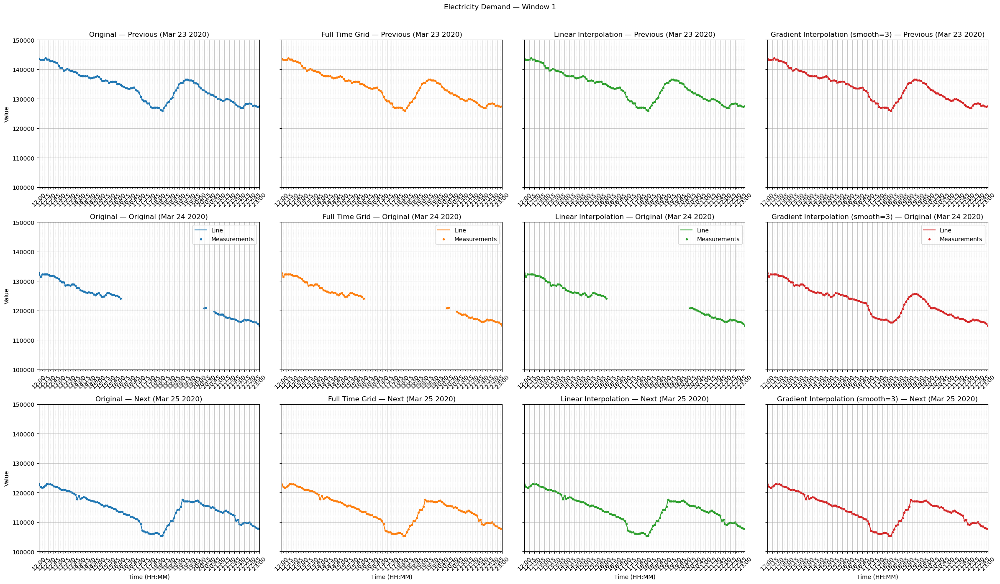

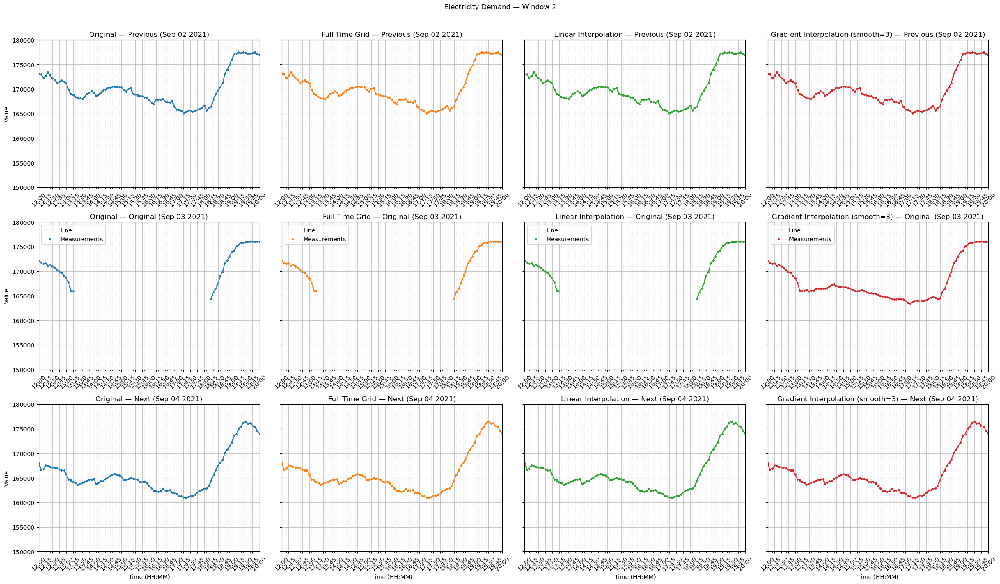

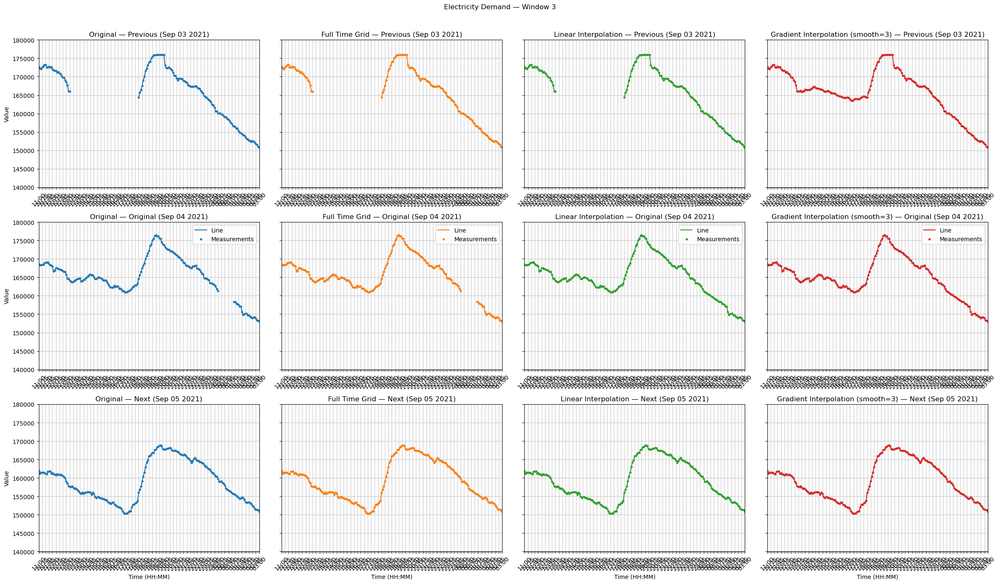

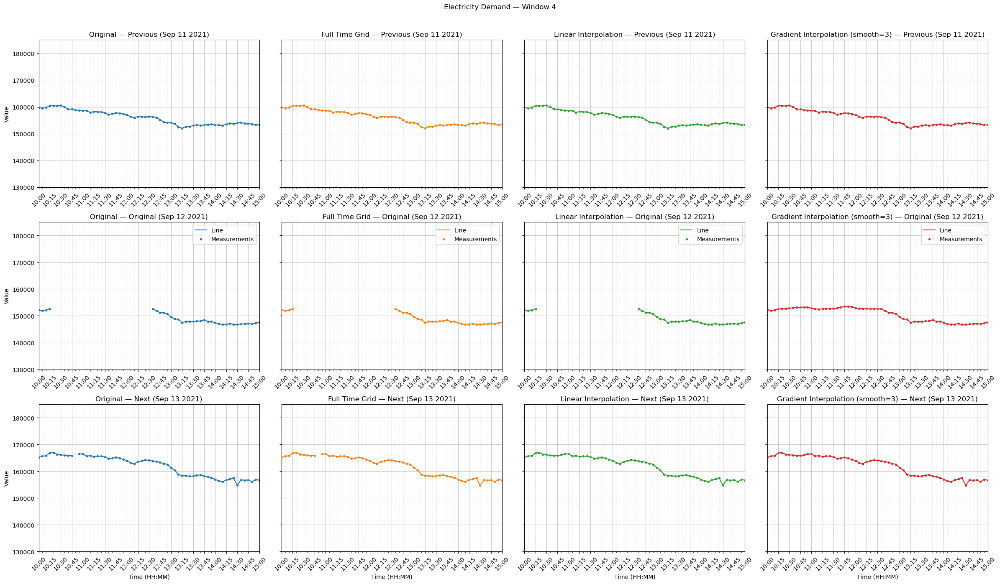

Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19107.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([19108.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 2005 ticks ([1910

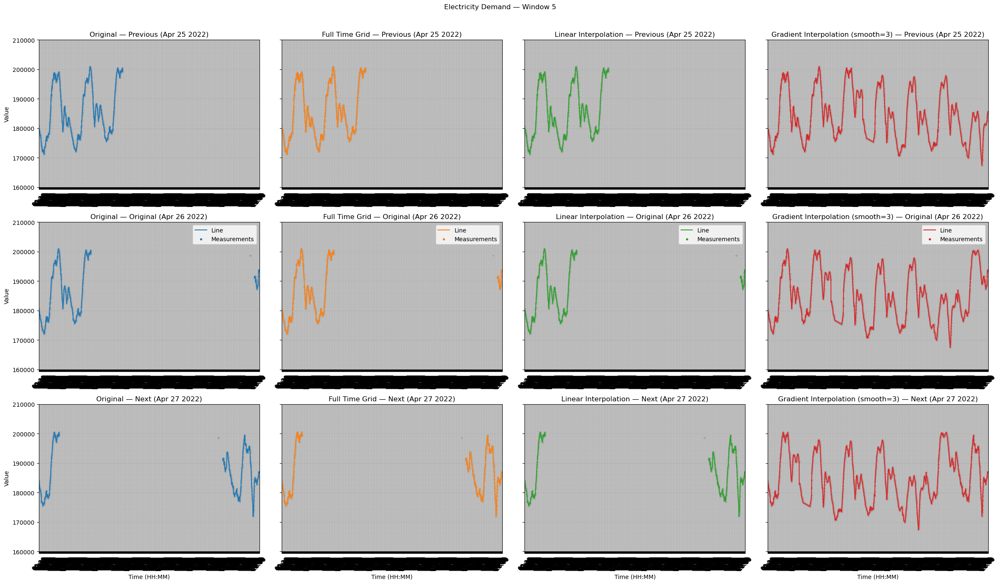

Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19108.0, ..., 19113.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([19109.0, ..., 19114.958333333332]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 1717 ticks ([1911

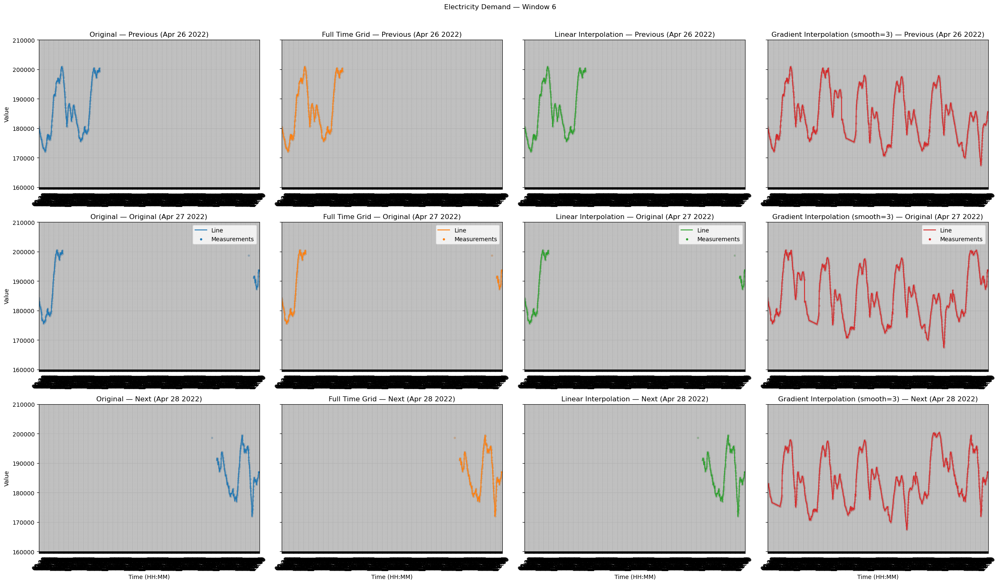

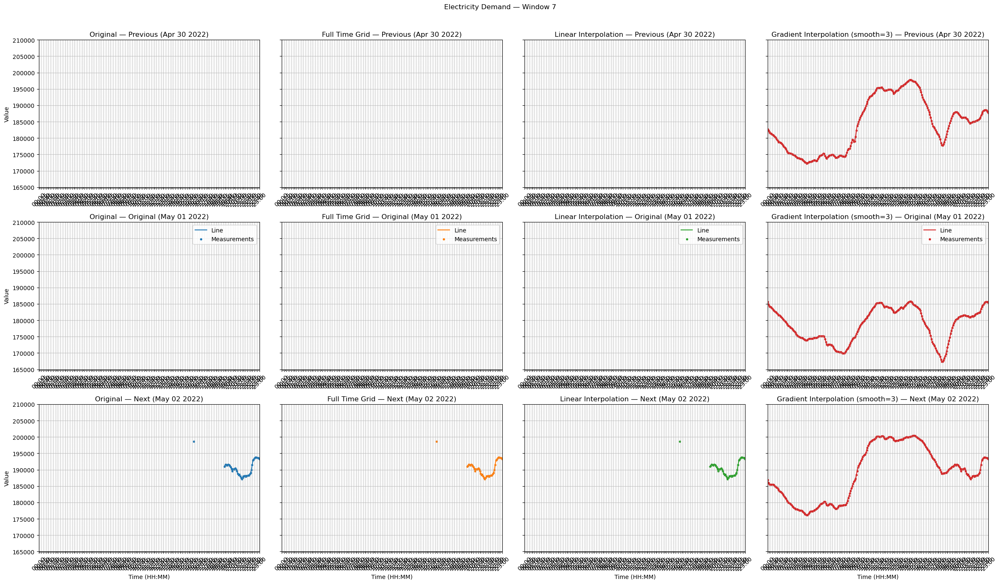

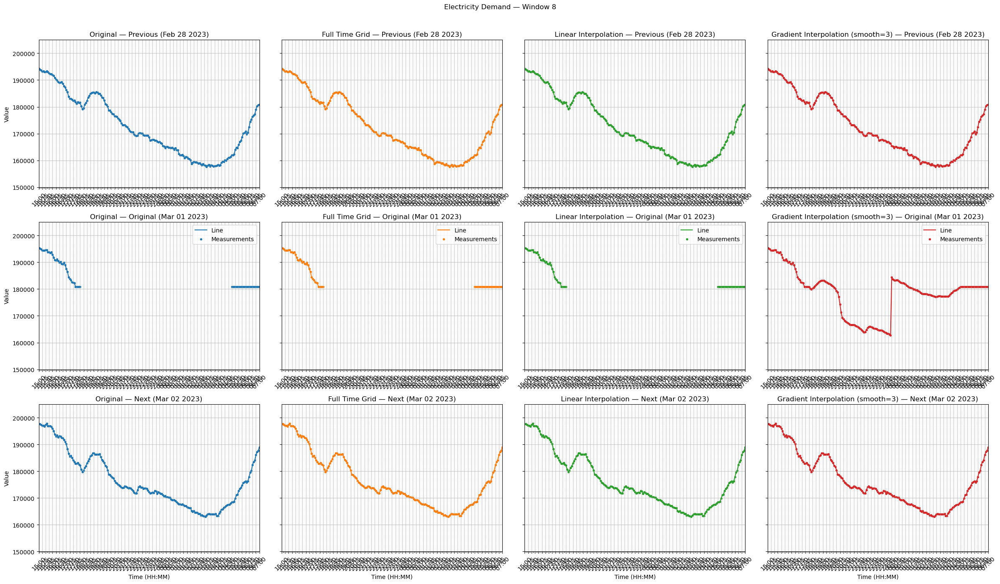

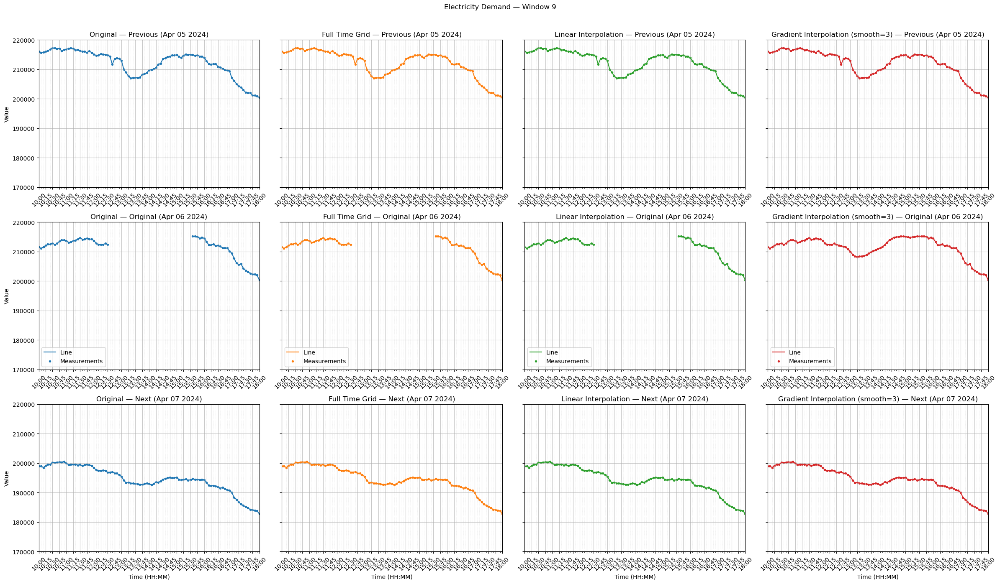

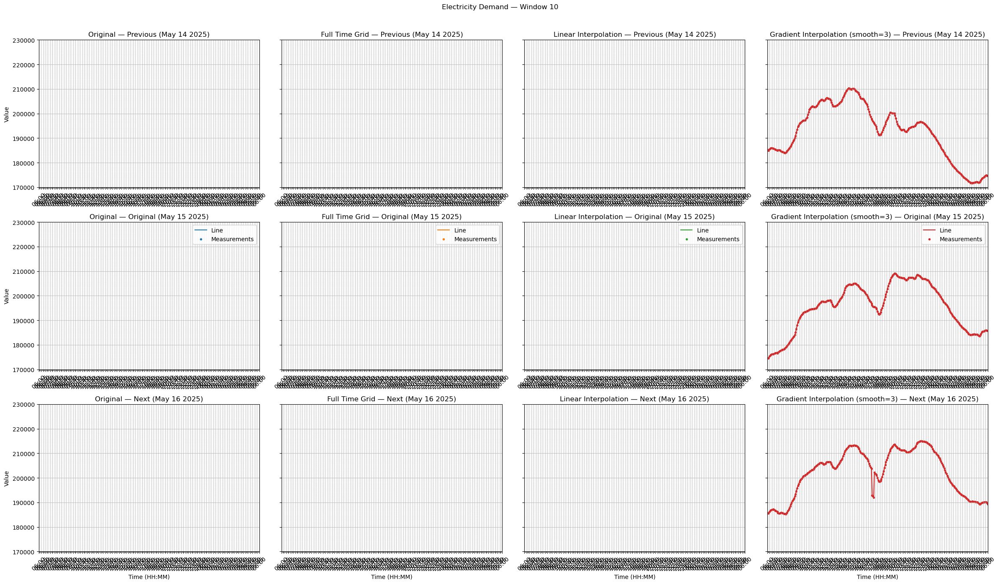

In [188]:
dataframes_to_plot = [full_time_join_grid_data, full_time_join_grid_data_step_1, full_time_join_grid_data_step_2,
                        full_time_join_grid_data_step_3]


start_boundaries = [ start_boundary_1, start_boundary_2, start_boundary_3,
                     start_boundary_4, start_boundary_5, start_boundary_6,
                     start_boundary_7, start_boundary_8, start_boundary_9, start_boundary_10]

end_boundaries = [ end_boundary_1, end_boundary_2, end_boundary_3,
                   end_boundary_4, end_boundary_5, end_boundary_6,
                   end_boundary_7, end_boundary_8, end_boundary_9, end_boundary_10]

ylimits = [ylim_1, ylim_2, ylim_3, ylim_4, ylim_5, ylim_6,
            ylim_7, ylim_8, ylim_9, ylim_10]

col_titles = ["Original", "Full Time Grid", "Linear Interpolation", "Gradient Interpolation (smooth=3)"]

batch_plot_from_lists(
    dataframes_to_plot,
    start_boundaries,
    end_boundaries,
    ylimits,
    timestamp_col="timestamp",
    plot_col="demand_met",
    offset_hours=24,
    titles=col_titles,               # optional
    base_title_prefix="Electricity Demand — ",
    width_per_col=6,
    height=14,
    sharey=True,
    align_ylim=True,                 # ignored when a per-window ylim is provided
    point_size=8,
    save=False,                      # flip to True to write PNGs
    # save_dir="figs",               # set when save=True
)

#### Saving Results:

In [190]:
grid_readings_processed_filename = grid_readings_filename + "_processed"
grid_readings_processed_filepath = os.path.join(hitachi_data_directory, grid_readings_processed_filename + ".parquet")

In [191]:
try:
    output_filetype = str(type(full_time_join_grid_data_step_3))
    full_time_join_grid_data_step_3.write_parquet(grid_readings_processed_filepath,
                                                  compression="snappy",
                                                  statistics=True)
    print(f"Successfully wrote [full_time_join_grid_data_step_3] of type [{output_filetype}]\n to filepath: {grid_readings_processed_filepath}")
except Exception as e:
    print(f"Error writing [full_time_join_grid_data_step_3] of type [{output_filetype}]\n to filepath: {grid_readings_processed_filepath}: {e}")


Successfully wrote [full_time_join_grid_data_step_3] of type [<class 'polars.dataframe.frame.DataFrame'>]
 to filepath: data/hitachi_copy/grid_readings_20250714_1401_processed.parquet


#### Summary

This notebook ingests and repairs the Grid Readings dataset (5-minute resolution) for Delhi/Mumbai, covering 2020 → mid-2025. While the raw pull shows no column-level nulls, a comparison against the expected timestamp grid reveals ~1.7% missing intervals (~9.7k out of 570,528 expected rows). These gaps created artifacts (e.g., apparent zero-emission slots) that would bias optimization and marginal emissions estimates. The notebook identifies, classifies, and fills gaps using methods tailored to short vs. long outages.

**Data Structure**
* Temporal Range: 2020-01 through ~2025-06
* Sampling: Every 5 minutes (288 slots/day)
* Coverage: Predominantly complete; ~98.3% of expected intervals present
* Variables: Grid demand/supply & related operational fields (continuous, non-negative)
* Total Expected Rows: 570,528 (5.5 years @ 5-min)
* Observed Shortfall: ~9,700 intervals (≈ 1.7%)

**Gap Characterization**
* Short gaps: ≤ 60 minutes (expanded to ≤ 80 minutes after testing)
* Long gaps: Multi-hour to multi-day runs, concentrated in 2022–2023 (spring); likely upstream collection issues

**Filling Strategy**

* Short Gaps (≤ 60 → 80 min)
    * Method: Linear interpolation per series (then ffill/bfill as tie-off).
    * Why: Local dynamics over ≤80 min are near-linear; avoids injecting false diurnal structure.
    * Result: Visually smooth, no obvious artifacts; raised cutoff to 80 min after spot checks.

* Long Gaps — Methods Evaluated
    * Scaled Daily Template (multiplicative):
        * What: Copy nearest prev/next day’s same time-of-day shape, scaled by edge-window medians (robust ratio).
        * Pros: Preserves diurnal pattern when the target day is a scaled version of neighbors.
        * Cons: Introduced occasional artifacts; struggled on multi-day gaps (drifts to quasi-linear behavior).

    * Gradient (Δ) Integration (chosen):
        * What: Borrow slot-wise gradients (5-min deltas) from prev/next donor days, average & smooth, then integrate inside the gap from real anchors; drift-correct when both edges exist.
        * Pros: Captures ramps/peaks realistically; robust on long gaps; fewer artifacts.
        * Cons: Needs smoothing to suppress donor noise.
        * Chosen smoothing: window = 3 (1,3 too spiky; 5,8 overly smoothed).
    
    * Week-Pair Offsets (additive):
        * What: Use a future day of the same weekday, calibrate additive offsets from many ±7-day replicas & edge windows, then apply donor−offset.
        * Pros: Sometimes OK on small gaps.
        * Cons: Frequently produced sharp, unrealistic level jumps; overall weakest performer.
    * Combined (Scaled near edges + Gradient interior):
        * What: Keep scaled at boundaries for continuity; switch to gradients in the interior.
        * Outcome: In practice inherited scaled artifacts without clear gains over pure Gradient.

    * Final Choice: Gradient (Δ) Integration with smoothing=3 for long gaps; Linear interpolation (≤80 min) for short gaps.

**Processing Pipeline**

1. Time Binning & Keys
    * Convert timestamps → _date + _slot (0..287), enabling same-time-of-day donor lookups.
    * Build unique (_date, _slot) index; deduplicate by most non-null row.

2. Gap Detection
    * Compute contiguous null runs globally and per day; summarize run lengths and positions.
    * Classify gaps as short vs. long.

3. Short-Gap Fill
    * Linear interpolate → ffill → bfill (per column).

4. Long-Gap Fill (Gradient)
    * Find nearest donor days (weekday-aware), compute slot-wise gradients, smooth (k=3), average donors.
    * Integrate from left/right anchors; drift-correct when both edges exist.
    * If anchors missing, seed with a blended donor absolute at the first slot, then integrate.

5. (Tried/Rejected) Alternatives
    * Scaled Template: multiplicative edge-calibrated day shapes.
    * Week-Pair Offsets: additive calibration using ±7k pooling.
    * Combined: interior gradient + edge scaling.

6. Finalize & Guards
    * Second-pass interpolation for any residuals; optional non-negative clamping for physical fields.

**Quality Assessment**

* Visual QA: Spot checks across random days/gaps (single-hour, multi-hour, multi-day, and cases with adjacent missing days).

* Artifact Screening: Looked for level jumps, flatlines, and implausible ramps; gradient method minimized these.

* Coverage: All gaps filled with realistic diurnal structure; no zero “free-lunch” slots left to bias optimization.

**Technical Implementation**

* Key helpers: date/slot binning, unique index, donor search (weekday-aware), small slot-lag alignment for scaling mode, gradient smoothing & integration, and comprehensive audit frames (methods, donors, scales/lags).

* Configurables:
    * Short-gap threshold: 80 min
    * Gradient smoothing: 3
    * Donor search window: up to ±30 days (weekday preference)
    * Safety caps for scaling (when used): e.g., [0.25, 4.0]

**Result**
* Missing intervals: ~1.7% (≈ 9.7k of 570,528 expected).
* Chosen method: Gradient (Δ) Integration (k=3) for long gaps, linear for ≤80 min.
* Outcome: Full, artifact-limited, analysis-ready 5-minute grid dataset suitable for marginal emissions and operational modeling.